In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import os
import re
import json
import pandas as pd
import numpy  as np

import matplotlib.pyplot as plt
import matplotlib.dates  as mdates

from datetime   import datetime, timezone
from legendmeta import LegendMetadata

from itertools import cycle

lmeta = LegendMetadata('/Users/romoluque_c/Repositories/legend-metadata/')

import partition_functions as pf

In [3]:
run_dict = {'p03':{'r000':{},'r001':{},'r002':{},'r003':{},'r004':{},'r005':{}},
            'p04':{'r000':{},'r001':{},'r002':{},'r003':{},'r004':{}},
            'p06':{'r000':{},'r001':{},'r002':{},'r003':{},'r004':{},'r005':{}},
            'p07':{          'r001':{},'r002':{},'r003':{},'r004':{},'r005':{},'r006':{},'r007':{},'r008':{}},
            'p08':{'r000':{},'r001':{},'r002':{},'r003':{},'r004':{},'r005':{},'r006':{},'r007':{},'r008':{},'r009':{}}}

In [4]:
data_path = '/Users/romoluque_c/LEGEND/Energy_scale_group/Partitioning/data_example/'

In [5]:
dt    = datetime(2023, 4, 22, 5, 54, 22, tzinfo=timezone.utc)
chmap = lmeta.hardware.configuration.channelmaps.on(dt)

ge_all        = [ch                        for ch    in chmap.keys() if chmap[ch]['system']=='geds']
ge_rawid      = [chmap[ch]['daq']['rawid'] for ch    in ge_all]
ge_table      = [f'ch{rawid}'              for rawid in ge_rawid]

icpc_channels = [ch for ch, ge_key in zip(ge_table, ge_all) if "V0" in ge_key]
bege_channels = [ch for ch, ge_key in zip(ge_table, ge_all) if "B0" in ge_key]
coax_channels = [ch for ch, ge_key in zip(ge_table, ge_all) if "C0" in ge_key]
ppc_channels  = [ch for ch, ge_key in zip(ge_table, ge_all) if "P0" in ge_key]

## Store processability and usability for all channels

In [6]:
processable = {}
usability   = {}
psd_status  = {}
for sel_channel in ge_table:
    processable_sub = {}
    usability_sub   = {}
    psd_status_sub  = {}
    for i, period in enumerate(run_dict.keys()):
        for j, run in enumerate(run_dict[period].keys()):
            all_files  = os.listdir(data_path)
            filename   = data_path + [f for f in all_files if f.startswith(f'l200-{period}-{run}')][0]
            dt_result  = pf.get_timestamp_from_filename(filename)
            config     = lmeta.dataprod.config.on(dt_result)
            det_name   = pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)
            config_chn = config.analysis[det_name]
            try:
                processable_sub[f'{period}-{run}'] = config_chn.processable
                usability_sub  [f'{period}-{run}'] = config_chn.usability
                psd_status_sub [f'{period}-{run}'] = config_chn.psd_status.high_AoE
            except Exception as e:
                continue
            
    processable[sel_channel] = processable_sub
    usability  [sel_channel] = usability_sub
    psd_status [sel_channel] = psd_status_sub

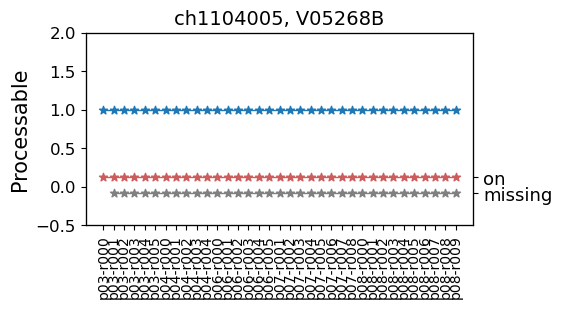

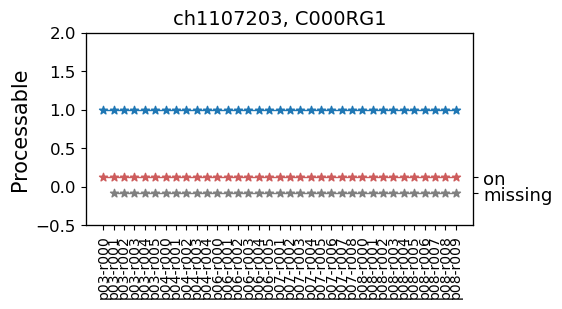

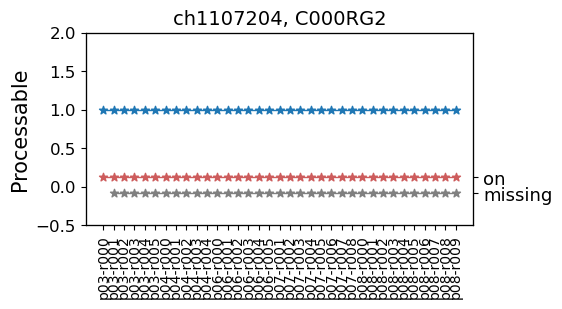

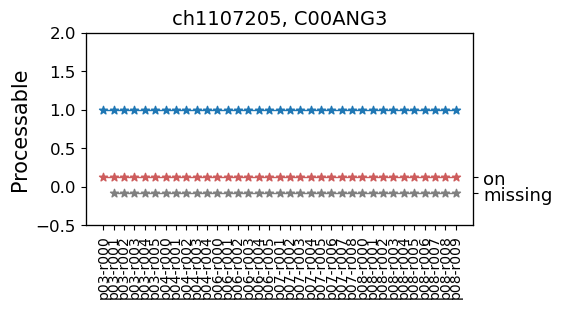

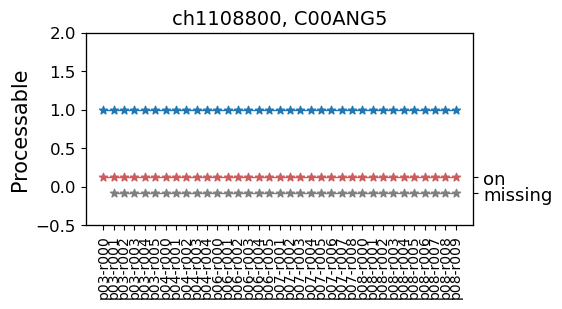

...

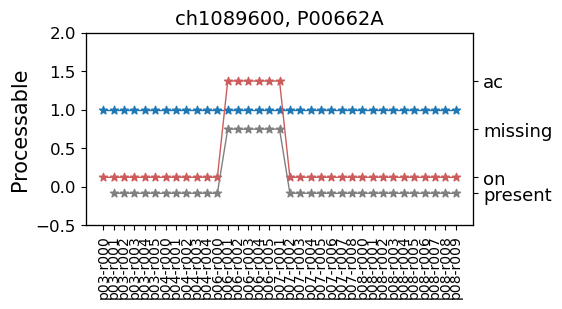

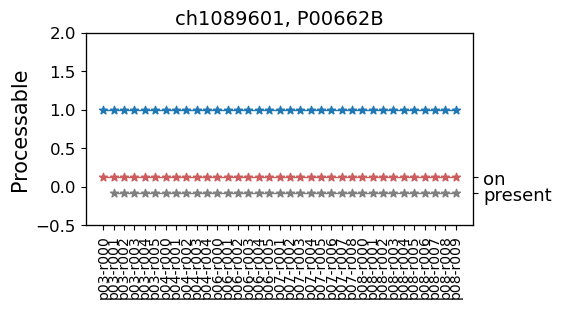

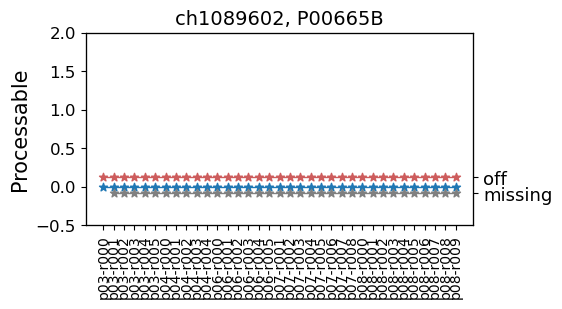

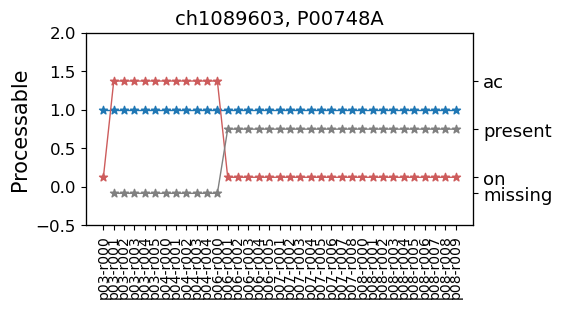

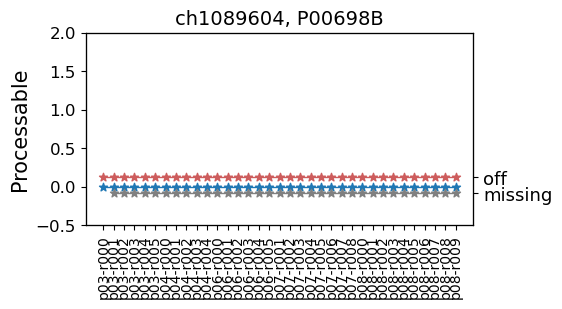

In [7]:
for sel_channel in processable.keys():
    proc_vals   = np.array(list(processable[sel_channel].values()))
    runs_keys   = np.array(list(processable[sel_channel].keys()))
    usab_vals   = np.array(list(usability  [sel_channel].values()))
    psds_vals   = np.array(list(psd_status [sel_channel].values()))
    psds_keys   = np.array(list(psd_status [sel_channel].keys()))
    
    if (len(np.unique(proc_vals))==1) & (len(np.unique(usab_vals))==1) & (len(np.unique(psds_vals))==1) & (np.unique(proc_vals)[0]==True) & (np.unique(usab_vals)[0]=='on') & (np.unique(psds_vals)[0]=='valid'):
        continue
    
    fig, ax = plt.subplots(1, 1, figsize=(5, 2.5))
    ax.scatter(runs_keys, proc_vals, marker='*')
    ax.plot(runs_keys, proc_vals, linestyle='-', linewidth=1)
    
    ax2 = ax.twinx()
    ax3 = ax.twinx()
    ax2.scatter(runs_keys, usab_vals, marker='*', color='indianred')
    ax2.plot   (runs_keys, usab_vals, linestyle='-', linewidth=1, color='indianred')
    ax3.scatter(psds_keys, psds_vals, marker='*', color='grey')
    ax3.plot(psds_keys, psds_vals, color='grey', linestyle='-', linewidth=1)
    for iax,ylim in zip([ax, ax2, ax3], [(-0.5, 2), (-0.5, 1.5), (-0.5, 2.5)]):
        iax.set_ylim(ylim)
    for iax in [ax2, ax3]:
        iax.tick_params(axis='y', labelsize=13)
    ax.tick_params(axis='x', labelsize=10, rotation=90)
    ax.tick_params(axis='y', labelsize=12)
    ax.set_title(f'{sel_channel}, {pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)}', fontsize=14)
    ax.set_ylabel('Processable', fontsize=15)
    plt.show()

## Get data from the par pht json files

In [8]:
all_params_ch = {}
err_channels  = []
bad_channels  = []
for num, sel_channel in enumerate(ge_table):
    print(num, sel_channel)
    pars_per_ch = {'mus_peaks':             {}, 'mus_err_peaks':     {},
                   'fwhms_peaks':           {}, 'fwhms_err_peaks':   {},
                   'ecals_peaks':           {}, 
                   'gains':                 {},
                   'Qbb_fwhms_in_ADC_poly': {}, 'Qbb_fwhms_in_ADC_lin': {},
                   'Qbb_fwhms_in_ADC_quad': {},
                   'Qbb_fwhms_in_keV':      {}, 'Qbb_fwhms_err_in_keV': {},
                   'usability':             {}}

    for i, period in enumerate(run_dict.keys()):
        for j, run in enumerate(run_dict[period].keys()):
            all_files  = os.listdir(data_path)
            filename   = data_path + [f for f in all_files if f.startswith(f'l200-{period}-{run}')][0]
            dt_result  = pf.get_timestamp_from_filename(filename)
            config     = lmeta.dataprod.config.on(dt_result)
            det_name   = pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)
            config_chn = config.analysis[det_name]
            #print(config_chn)

            if (config_chn['processable'] == True):# and (config_chn['usability'] == 'on'):
                #if (config_chn['processable'] == True) and (config_chn['usability'] != 'ac'):
                ## Make sure the detector is ok

                with open (filename, 'r') as filehandler:
                    try:
                        results   = json.load(filehandler)
                        res_chn   = results[sel_channel]['results']['ecal']
    
                        ## Parameters for calibration. If 3 pars, quad cal, if 2 pars, lin cal.
                        cal_parameters = results[sel_channel]['pars']['operations']['cuspEmax_ctc_cal']['parameters']
                        
                        ## Parameters for resolution curve
                        eres_lin_pars = res_chn['cuspEmax_ctc_cal']['eres_linear']
    
                        pars_per_ch['Qbb_fwhms_in_keV']     [f'{period}-{run}'] = eres_lin_pars['Qbb_fwhm_in_keV']
                        pars_per_ch['Qbb_fwhms_err_in_keV'] [f'{period}-{run}'] = eres_lin_pars['Qbb_fwhm_err_in_keV']
                        pars_per_ch['gains']                [f'{period}-{run}'] = cal_parameters['b']
                        pars_per_ch['Qbb_fwhms_in_ADC_poly'][f'{period}-{run}'] = pf.uncal_poly(eres_lin_pars['Qbb_fwhm_in_keV'], list(cal_parameters.values()))
                        pars_per_ch['Qbb_fwhms_in_ADC_quad'][f'{period}-{run}'] = pf.uncal_quad(eres_lin_pars['Qbb_fwhm_in_keV'], cal_parameters)
                        pars_per_ch['Qbb_fwhms_in_ADC_lin'] [f'{period}-{run}'] = pf.uncal_lin (eres_lin_pars['Qbb_fwhm_in_keV'], cal_parameters)
                        pars_per_ch['usability']            [f'{period}-{run}'] = config_chn['usability']
                        
                        fitted_peaks   = res_chn['cuspEmax_ctc_cal']['fitted_peaks']
                        peak_fits_pars = res_chn['cuspEmax_ctc_cal']['pk_fits']
                        
                        for peak in fitted_peaks:
                            if i==0 and j==0:
                                pars_per_ch['mus_peaks']        [peak] = {}
                                pars_per_ch['mus_err_peaks']    [peak] = {}
                                pars_per_ch['fwhms_peaks']      [peak] = {}
                                pars_per_ch['fwhms_err_peaks']  [peak] = {}
                                pars_per_ch['ecals_peaks']      [peak] = {}
                            
                            mu     = peak_fits_pars[f'{peak}']['parameters_in_ADC']   ['mu']
                            mu_err = peak_fits_pars[f'{peak}']['uncertainties_in_ADC']['mu']

                            pars_per_ch['mus_peaks']        [peak][f'{period}-{run}'] = mu    
                            pars_per_ch['mus_err_peaks']    [peak][f'{period}-{run}'] = mu_err
                            pars_per_ch['fwhms_peaks']      [peak][f'{period}-{run}'] = peak_fits_pars[f'{peak}']['fwhm_in_keV'][0]   
                            pars_per_ch['fwhms_err_peaks']  [peak][f'{period}-{run}'] = peak_fits_pars[f'{peak}']['fwhm_in_keV'][1]   
                            pars_per_ch['ecals_peaks']      [peak][f'{period}-{run}'] = pf.cal_energy(peak_fits_pars[f'{peak}']['parameters_in_ADC']['mu'], cal_parameters)[0]
                    except:
                        print(sel_channel, period, run)
                        err_channels.append(sel_channel)
                        continue
                        
            else:
                bad_channels.append(sel_channel)

    all_params_ch[sel_channel] = pars_per_ch

0 ch1104000
1 ch1104001
2 ch1104002
3 ch1104003
4 ch1104004
5 ch1104005
6 ch1105600
7 ch1105602
8 ch1105603
9 ch1107202
ch1107202 p03 r003
10 ch1107203
11 ch1107204
12 ch1107205
13 ch1108800
14 ch1108801
15 ch1108802
16 ch1108803
17 ch1108804
18 ch1110402
19 ch1110403
20 ch1110404
21 ch1110405
22 ch1112000
23 ch1112001
24 ch1112002
ch1112002 p03 r003
ch1112002 p08 r004
25 ch1112003
26 ch1112004
27 ch1112005
28 ch1113600
29 ch1113601
30 ch1113602
31 ch1113603
32 ch1113604
33 ch1113605
34 ch1115200
35 ch1115201
36 ch1115202
37 ch1115203
ch1115203 p06 r000
ch1115203 p06 r001
ch1115203 p06 r002
38 ch1115204
ch1115204 p06 r000
ch1115204 p06 r001
ch1115204 p06 r004
ch1115204 p06 r005
ch1115204 p07 r001
ch1115204 p07 r003
ch1115204 p07 r004
ch1115204 p07 r005
ch1115204 p07 r006
ch1115204 p07 r007
ch1115204 p07 r008
ch1115204 p08 r000
ch1115204 p08 r001
ch1115204 p08 r002
ch1115204 p08 r003
ch1115204 p08 r004
ch1115204 p08 r005
ch1115204 p08 r006
ch1115204 p08 r007
ch1115204 p08 r008
ch1115204

In [9]:
all_params_ch;

### Check parameters for all detectors:

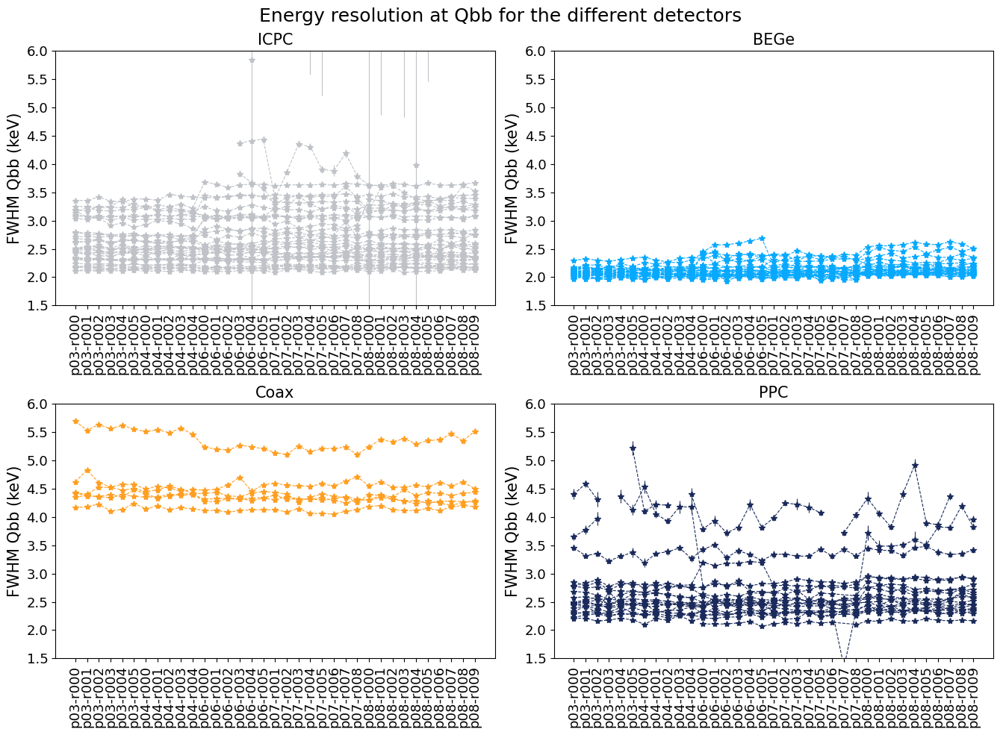

In [10]:
pf.plot_variable_for_det_type(all_params_ch, all_params_ch.keys(), ge_all, ge_rawid, 'Qbb_fwhms_in_keV', 
                             'Qbb_fwhms_err_in_keV', 'FWHM Qbb (keV)', ylims=(1.5, 6),
                              title='Energy resolution at Qbb for the different detectors')

In [11]:
channel_dict = {}
for channel_name, channel_data in chmap.items():
    try:
        channel_dict[channel_data['daq']['rawid']] = (lmeta.channelmap(dt)[channel_name].type,
                                                      channel_name,
                                                      lmeta.channelmap(dt)[channel_name].production['mass_in_g'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['string'],
                                                      lmeta.channelmap(dt)[channel_name].location  ['position'])
    except:
        continue

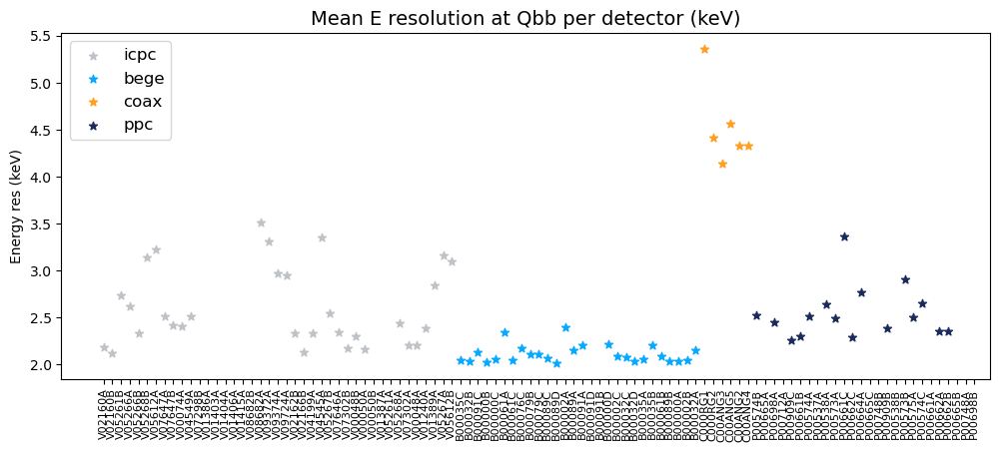

In [12]:
fig = plt.figure(figsize=(12, 4.5))
for d_type, col in zip(['icpc', 'bege', 'coax', 'ppc'], ['#BFC2C7', '#07A9FF', '#FF9E21', '#1A2A5B']):
    mean_res = []
    ch_names = []
    for channel in list(all_params_ch.keys()):
        det_type = channel_dict[int(channel[2:])][0]
        det_name = channel_dict[int(channel[2:])][1]
        if d_type==det_type:
            mean_res.append(np.mean(np.array(list(all_params_ch[channel]['Qbb_fwhms_in_keV'].values()))))
            ch_names.append(det_name)
    plt.scatter(ch_names, mean_res, marker='*', color=col, label=d_type)
plt.xticks(rotation=90, fontsize=8)
plt.title('Mean E resolution at Qbb per detector (keV)', fontsize=14)
plt.ylabel('Energy res (keV)')
plt.legend(fontsize=12, loc=2)
#plt.yscale('log')
#plt.ylim(-10, 60)
plt.show()

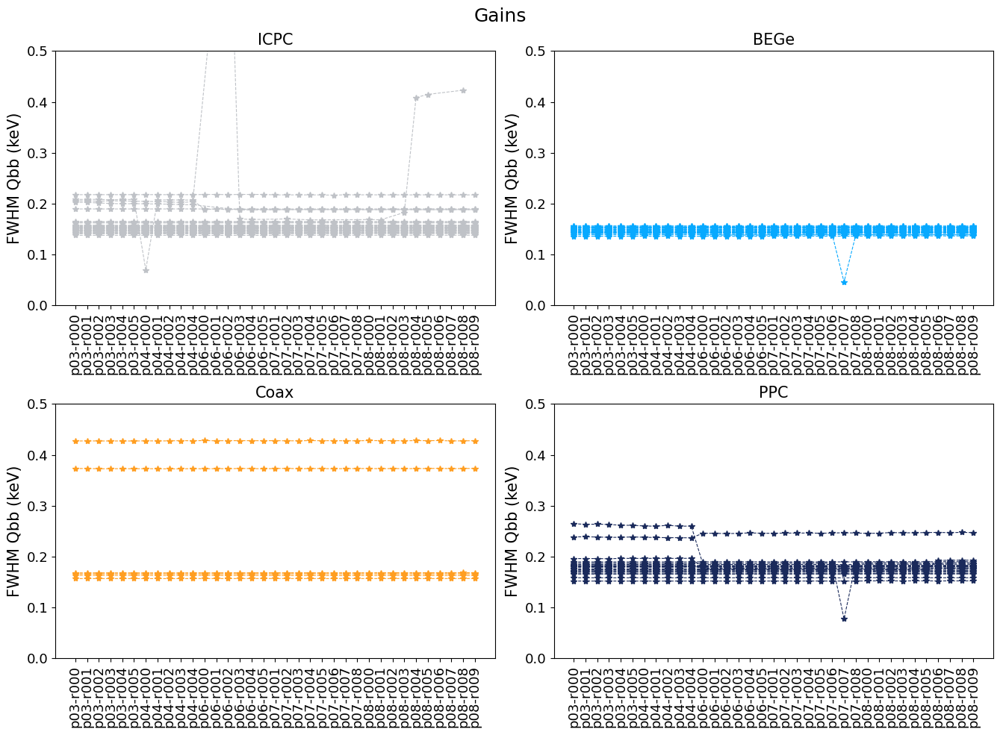

In [13]:
pf.plot_variable_for_det_type(all_params_ch, all_params_ch.keys(), ge_all, ge_rawid, 'gains', 'Gain', errs=False,
                           ylims=(0, 0.5), title='Gains')

In [14]:
all_fitted_peaks = np.array([583.191, 727.33, 860.564, 1592.53, 1620.5, 2103.53, 2614.5])

In [15]:
good_chs = [ch for ch in all_params_ch.keys() if ch not in bad_channels]

ch1089603 583.191


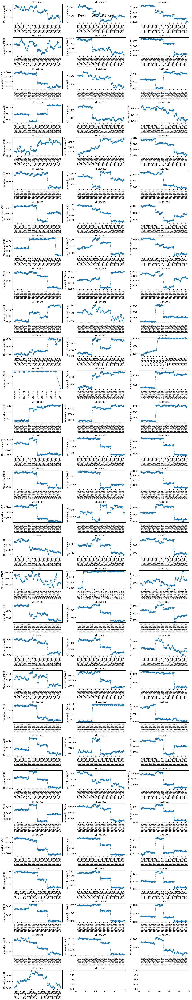


-------------------------------------------------------------------------------------------------



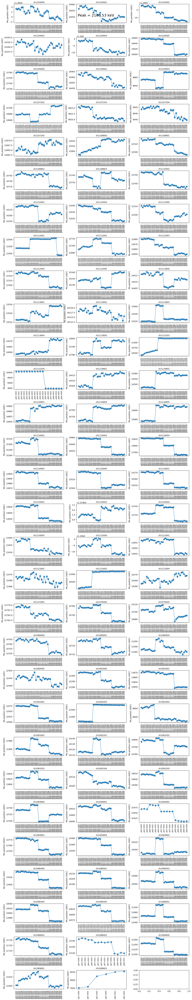


-------------------------------------------------------------------------------------------------

ch1115204 2614.5
ch1121603 2614.5


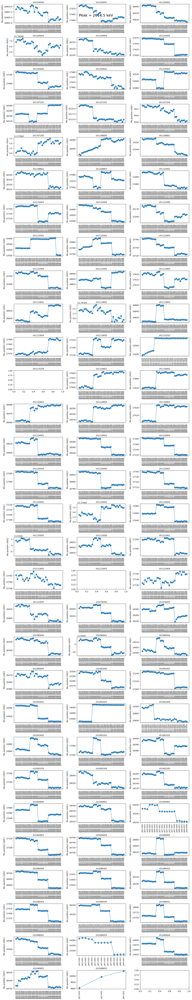


-------------------------------------------------------------------------------------------------



In [16]:
for peak in [all_fitted_peaks[0], all_fitted_peaks[5], all_fitted_peaks[6]]:
    fig, axs = plt.subplots(int(np.ceil(len(good_chs)/3)), 3, figsize=(13.5, 70))
    for i, (ax, channel) in enumerate(zip(axs.flatten(), good_chs)):
        try:
            ax.errorbar(list(all_params_ch[channel]['mus_peaks'][peak].keys()), 
                        list(all_params_ch[channel]['mus_peaks'][peak].values()),
                        yerr=list(all_params_ch[channel]['mus_err_peaks'][peak].values()), 
                        marker='*', linestyle='--', markersize=10, label=channel)
            ax.tick_params(axis='x', labelsize=9, rotation=90)
            ax.tick_params(axis='y', labelsize=10)
            ax.set_title(channel, fontsize=10)
            ax.set_ylabel('Mu position (ADC)', fontsize=10)
        except KeyError:
            ax.set_title(channel, fontsize=10)
            print(channel, peak)
            continue
    fig.suptitle(f'Peak = {peak} keV', fontsize=18)
    plt.tight_layout()
    plt.show()
    print()
    print('-------------------------------------------------------------------------------------------------')
    print()

## Compare mu for different peaks:

In [17]:
random_chs = ['ch1110404', 'ch1121604', 'ch1083202', 'ch1089601']

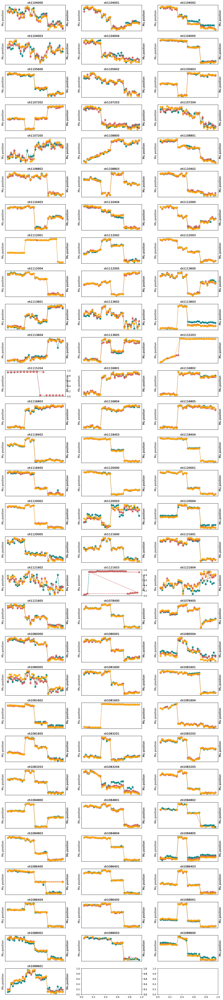

In [18]:
fig, axs = plt.subplots(int(np.ceil(len(good_chs)/3)), 3, figsize=(13.5, 60))
for i, (ax0, channel) in enumerate(zip(axs.flatten(), good_chs)):
    try:
        for ax, ipeak, col in zip([ax0, ax0.twinx(), ax0.twinx()], [0, 5, 6], ['teal', 'indianred', 'orange']):
            ax.errorbar(list(all_params_ch[channel]['mus_peaks'][all_fitted_peaks[ipeak]].keys()), 
                        list(all_params_ch[channel]['mus_peaks'][all_fitted_peaks[ipeak]].values()),
                        yerr=list(all_params_ch[channel]['mus_err_peaks'][all_fitted_peaks[ipeak]].values()), 
                        marker='*', linestyle='--', markersize=10, label=f'{all_fitted_peaks[ipeak]} keV', color=col)
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xticks([])
            ax.set_yticks([])
            ax.set_title(channel, fontsize=12)
            ax.set_ylabel('Mu position', fontsize=12)
    except: continue
plt.tight_layout()
plt.show()

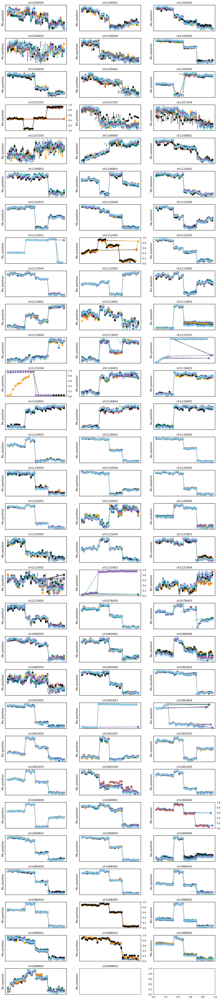

In [19]:
fig, axs = plt.subplots(int(np.ceil(len(good_chs)/3)), 3, figsize=(13.5, 60))
for i, (ax, channel) in enumerate(zip(axs.flatten(), good_chs)):
    try:
        ax.errorbar(list(all_params_ch[channel]['mus_peaks'][all_fitted_peaks[0]].keys()), 
                    list(all_params_ch[channel]['mus_peaks'][all_fitted_peaks[0]].values()),
                    yerr=list(all_params_ch[channel]['mus_err_peaks'][all_fitted_peaks[0]].values()), 
                    marker='*', linestyle='--', markersize=10, label=f'{all_fitted_peaks[0]} keV')
        
        for peak, col in zip(all_fitted_peaks[1:], ['indianred', 'orange', 'k', 'teal', '#9467bd', 'skyblue']):
            ax2 = ax.twinx()
            ax2.errorbar(list(all_params_ch[channel]['mus_peaks'][peak].keys()), 
                         list(all_params_ch[channel]['mus_peaks'][peak].values()),
                         yerr=list(all_params_ch[channel]['mus_err_peaks'][peak].values()), 
                         marker='*', linestyle='--', markersize=10, label=f'{peak} keV', color=col)
            ax2.set_yticklabels([])
            ax2.set_yticks([])
    
    except:
        pass

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(channel, fontsize=12)
    ax.set_ylabel('Mu position', fontsize=12)
        
plt.tight_layout()
plt.show()

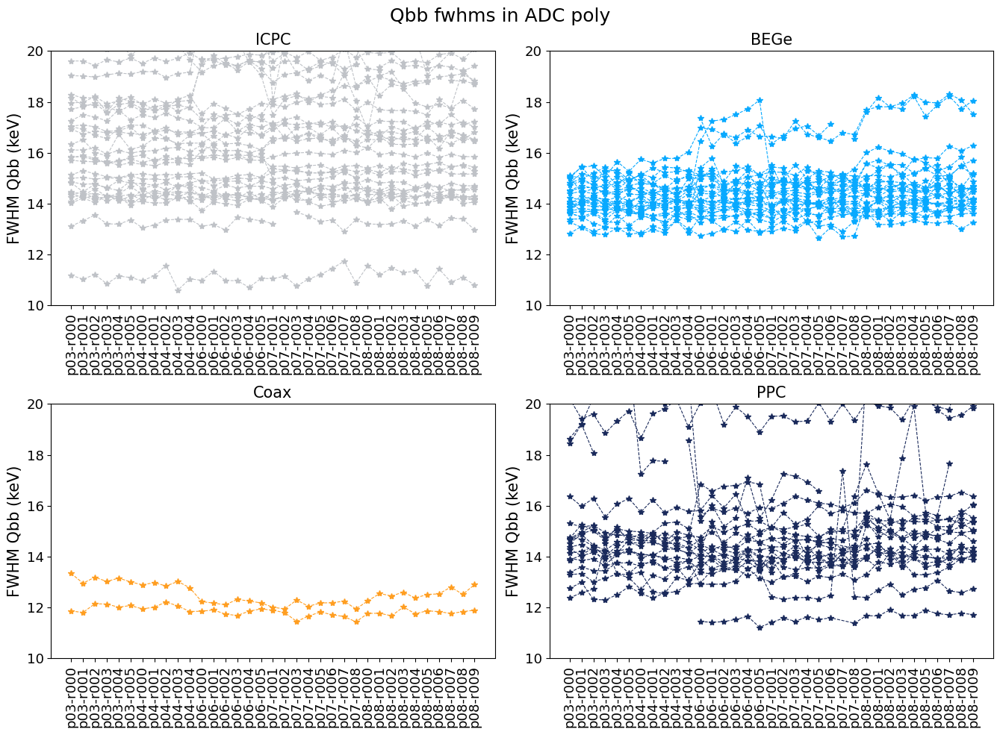

In [20]:
pf.plot_variable_for_det_type(all_params_ch, all_params_ch.keys(), ge_all, ge_rawid, 'Qbb_fwhms_in_ADC_poly',
                              'Gain', errs=False, ylims=(10, 20), title='Qbb fwhms in ADC poly')

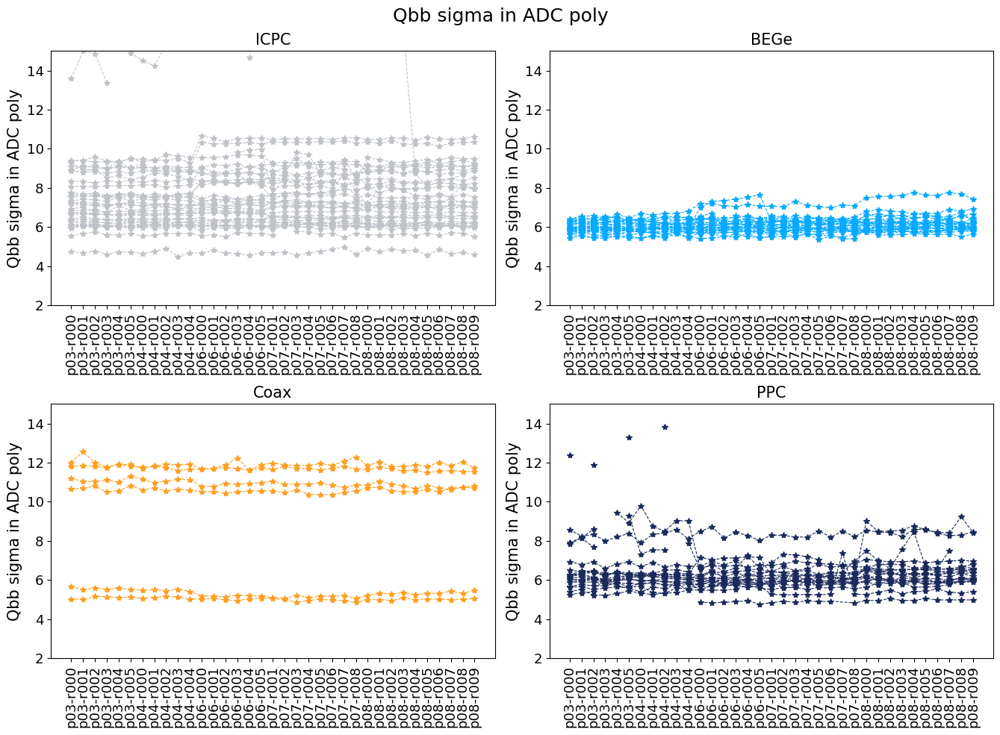

In [21]:
fig, axs = plt.subplots(2, 2, figsize=(13.5, 10))
for ax, d_type, col in zip(axs.flatten(), pf.type_mapping.values(), ['#BFC2C7', '#07A9FF', '#FF9E21', '#1A2A5B']):
    for channel in good_chs:
        det_type = pf.get_det_type(pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid))
        if det_type==d_type:
            qbb_fwhm_poly_ch   = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].values()))
            qbb_fwhm_poly_keys = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].keys()))
            sigmas = qbb_fwhm_poly_ch/2.355
            ax.errorbar(qbb_fwhm_poly_keys, sigmas, yerr=np.zeros(len(sigmas)),
                     marker='*', linestyle='--', markersize=6, label=channel, color=col, linewidth=0.8)
            
            ax.tick_params(axis='x', labelsize=13, rotation=90)
            ax.tick_params(axis='y', labelsize=13)
            ax.set_title(f'{d_type}', fontsize=15)
            ax.set_ylabel('Qbb sigma in ADC poly', fontsize=15)
            ax.set_ylim(2, 15)
fig.suptitle(f'Qbb sigma in ADC poly', fontsize=18)
plt.tight_layout()
plt.show()

### Compare with the quad and lin methods

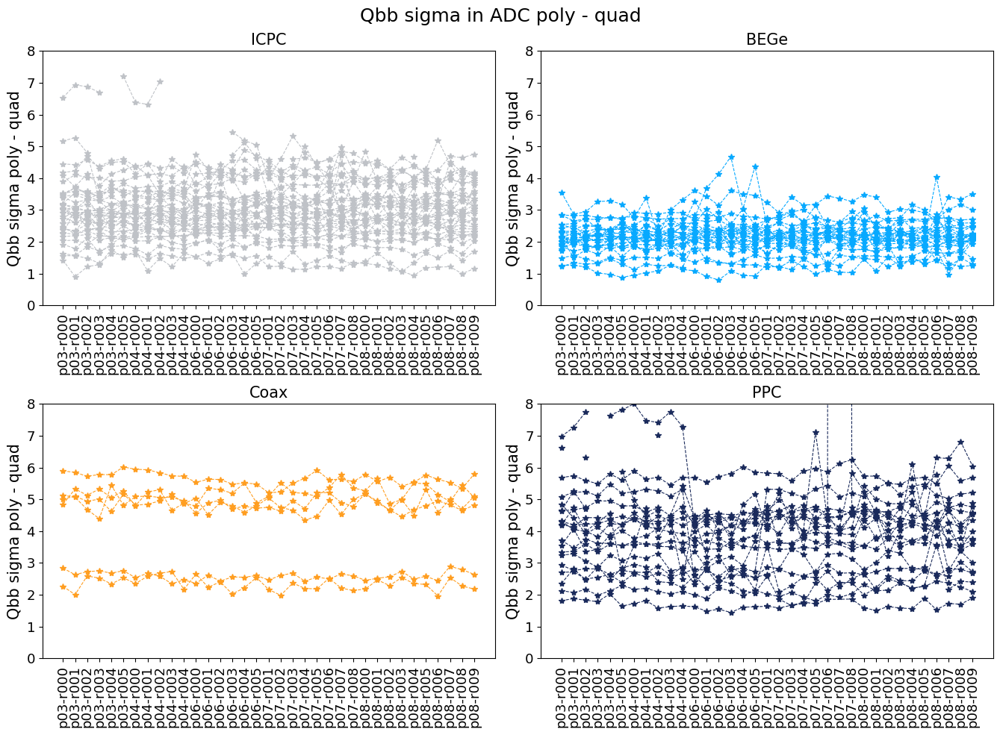

In [22]:
fig, axs = plt.subplots(2, 2, figsize=(13.5, 10))
for ax, d_type, col in zip(axs.flatten(), pf.type_mapping.values(), ['#BFC2C7', '#07A9FF', '#FF9E21', '#1A2A5B']):
    for channel in good_chs:
        det_type = pf.get_det_type(pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid))
        if det_type==d_type:
            qbb_fwhm_poly_ch   = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].values()))
            qbb_fwhm_poly_keys = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].keys()))
            sigmas0 = qbb_fwhm_poly_ch/2.355
            sigmas1 = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_quad'].values()))/2.355
            sigmas2 = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_lin'] .values()))/2.355
            ax.errorbar(qbb_fwhm_poly_keys, sigmas0-sigmas1, yerr=np.zeros(len(sigmas0)),
                     marker='*', linestyle='--', markersize=6, label=channel, color=col, linewidth=0.8)
            
            ax.tick_params(axis='x', labelsize=13, rotation=90)
            ax.tick_params(axis='y', labelsize=13)
            ax.set_title(f'{d_type}', fontsize=15)
            ax.set_ylabel('Qbb sigma poly - quad', fontsize=15)
            ax.set_ylim(0, 8)
fig.suptitle(f'Qbb sigma in ADC poly - quad', fontsize=18)
plt.tight_layout()
plt.show()

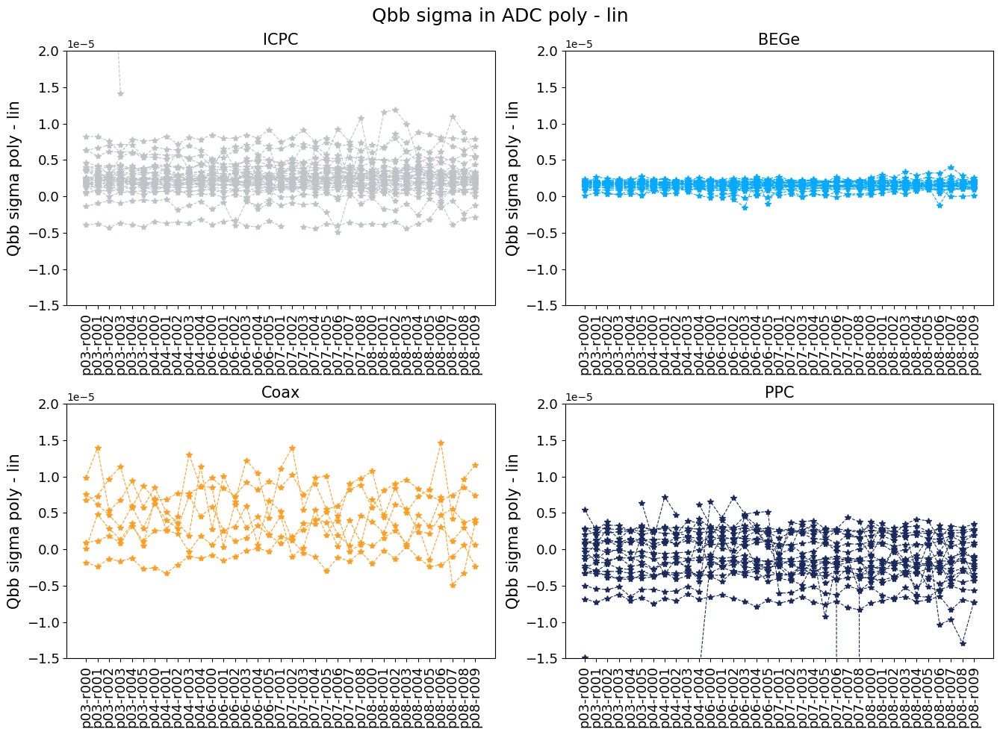

In [23]:
fig, axs = plt.subplots(2, 2, figsize=(13.5, 10))
for ax, d_type, col in zip(axs.flatten(), pf.type_mapping.values(), ['#BFC2C7', '#07A9FF', '#FF9E21', '#1A2A5B']):
    for channel in good_chs:
        det_type = pf.get_det_type(pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid))
        if det_type==d_type:
            qbb_fwhm_poly_ch   = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].values()))
            qbb_fwhm_poly_keys = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_poly'].keys()))
            sigmas0 = qbb_fwhm_poly_ch/2.355
            sigmas1 = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_quad'].values()))/2.355
            sigmas2 = np.array(list(all_params_ch[channel]['Qbb_fwhms_in_ADC_lin'].values()))/2.355
            ax.errorbar(qbb_fwhm_poly_keys, sigmas0-sigmas2, yerr=np.zeros(len(sigmas0)),
                     marker='*', linestyle='--', markersize=6, label=channel, color=col, linewidth=0.8)
            
            ax.tick_params(axis='x', labelsize=13, rotation=90)
            ax.tick_params(axis='y', labelsize=13)
            ax.set_title(f'{d_type}', fontsize=15)
            ax.set_ylabel('Qbb sigma poly - lin', fontsize=15)
            ax.set_ylim(-0.000015, 0.00002)
fig.suptitle(f'Qbb sigma in ADC poly - lin', fontsize=18)
plt.tight_layout()
plt.show()

## Make partitions using poly method

## Compare partitions with the mean of the sigma as thr

In [24]:
color_list = ['teal', 'grey', 'orange', 'indianred']

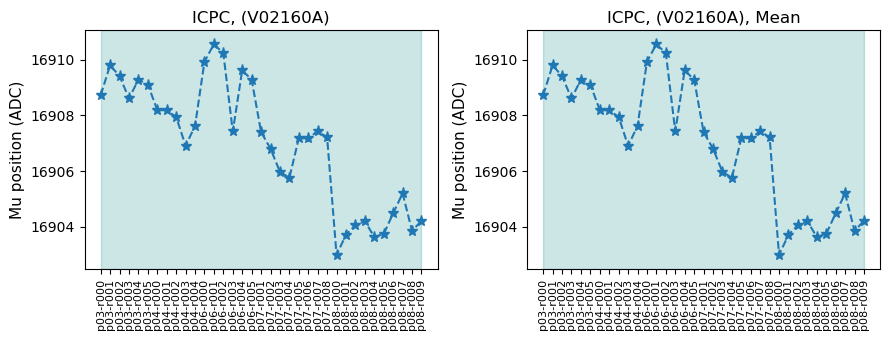

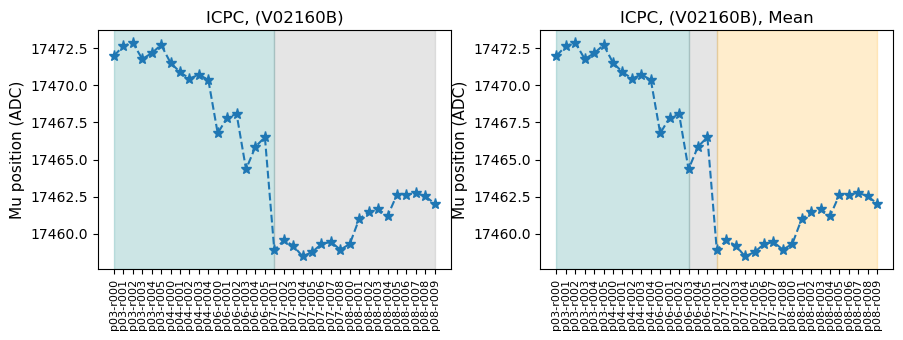

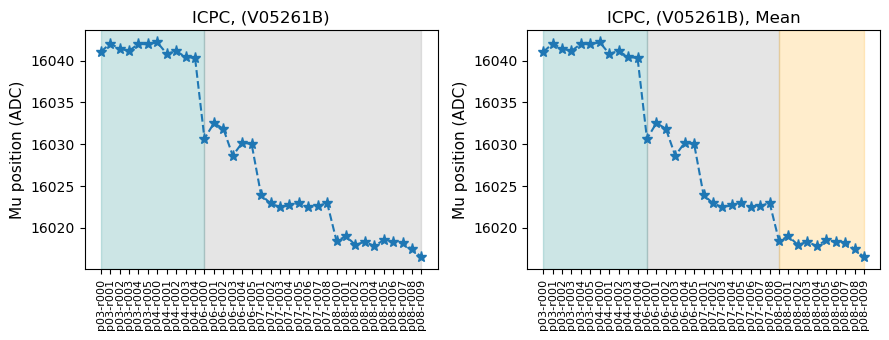

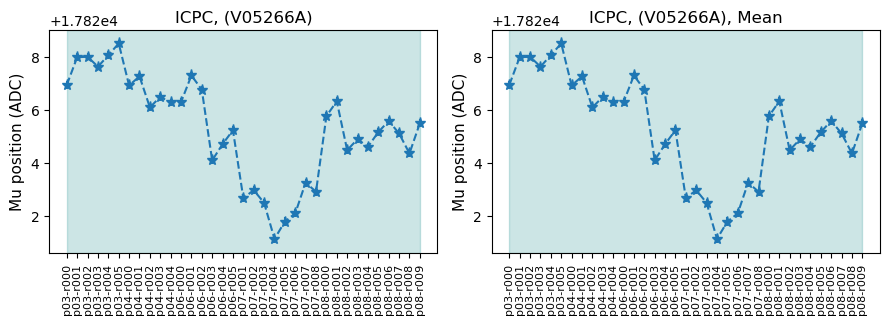

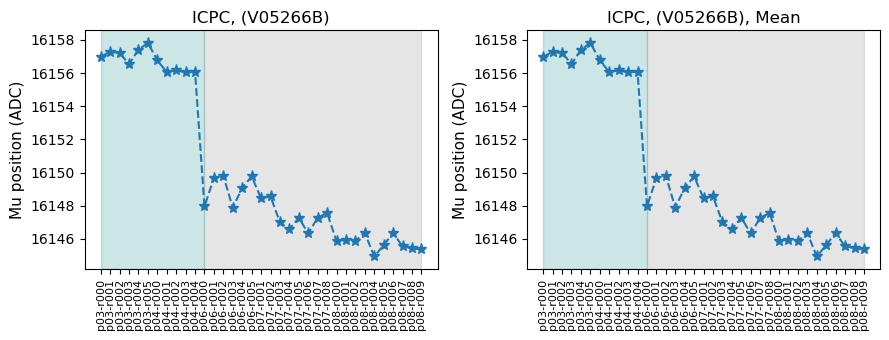

...

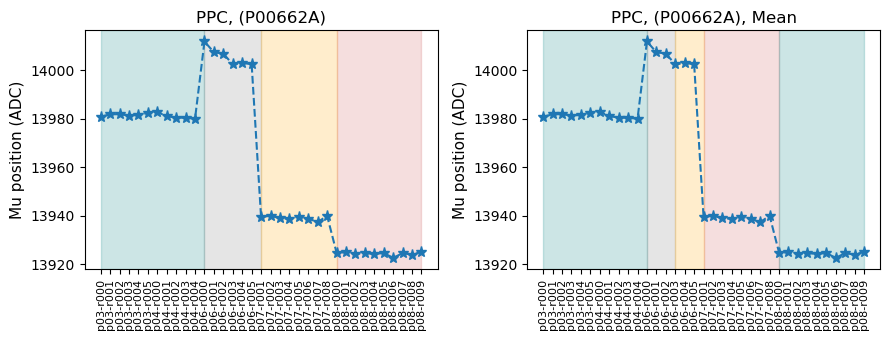

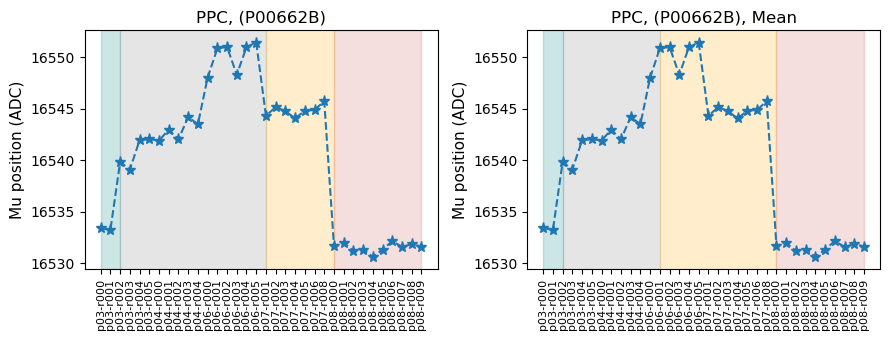

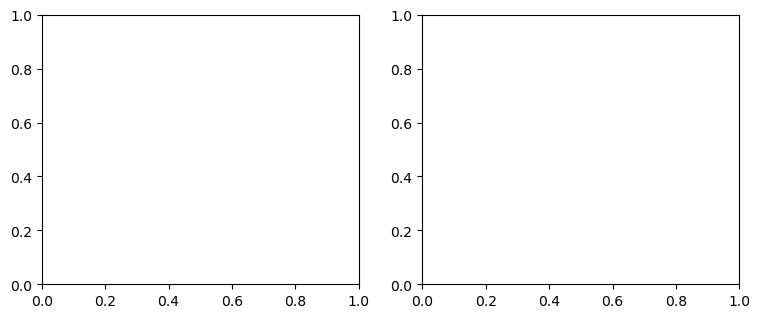

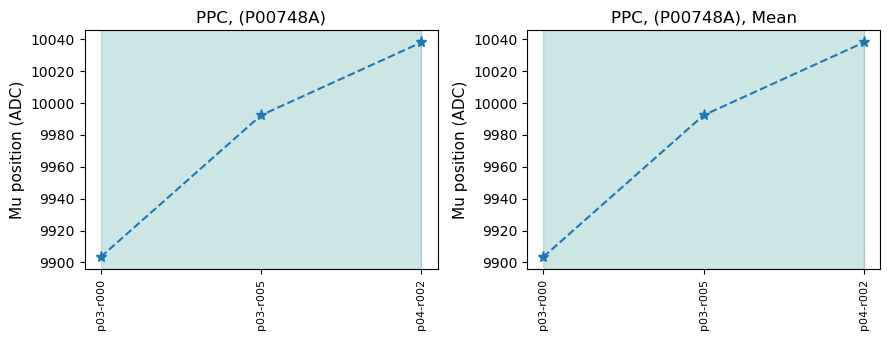

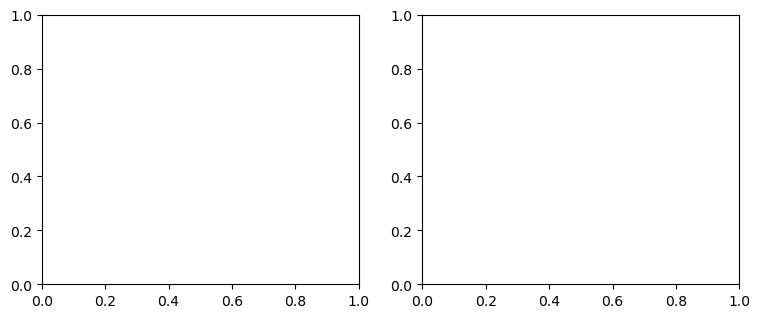

In [25]:
for i,channel in enumerate(all_params_ch.keys()):
    try:
        fig, (ax0, ax1)  = plt.subplots(1, 2, figsize=(9, 3.5))
        det_name = pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid)
        det_type = pf.get_det_type(det_name)
        for ax, mean_part, title in zip([ax0, ax1], [False, True], ['', ', Mean']):
            ax.errorbar(list(all_params_ch[channel]['mus_peaks'][peak].keys()), 
                        list(all_params_ch[channel]['mus_peaks'][peak].values()),
                        yerr=list(all_params_ch[channel]['mus_err_peaks'][peak].values()), 
                        marker='*', linestyle='--', markersize=8, label=det_type)
            
            ax.tick_params(axis='x', labelsize=8, rotation=90)
            ax.tick_params(axis='y', labelsize=10)
            ax.set_ylabel('Mu position (ADC)', fontsize=11)

            partition_change = pf.compute_partitions_poly(all_params_ch, channel, peak, mean_part=mean_part)
            for i,col in zip(range(len(partition_change)-1), cycle(color_list)):
                ax.axvspan(list(all_params_ch[channel]['mus_peaks'][peak].keys())[partition_change[i]], 
                           list(all_params_ch[channel]['mus_peaks'][peak].keys())[partition_change[i+1]], alpha=0.2, color=col)
    
            ax.set_title(f'{det_type}, ({det_name}){title}', fontsize=12)
        
        plt.tight_layout()
        plt.show()
    except KeyError:
        continue

-------------------------------------------------------------------------------------------


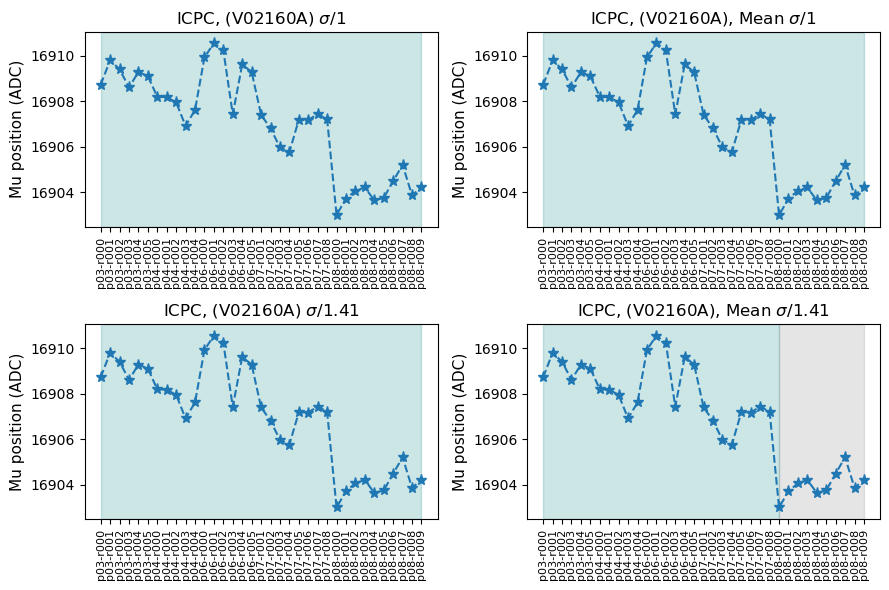

-------------------------------------------------------------------------------------------


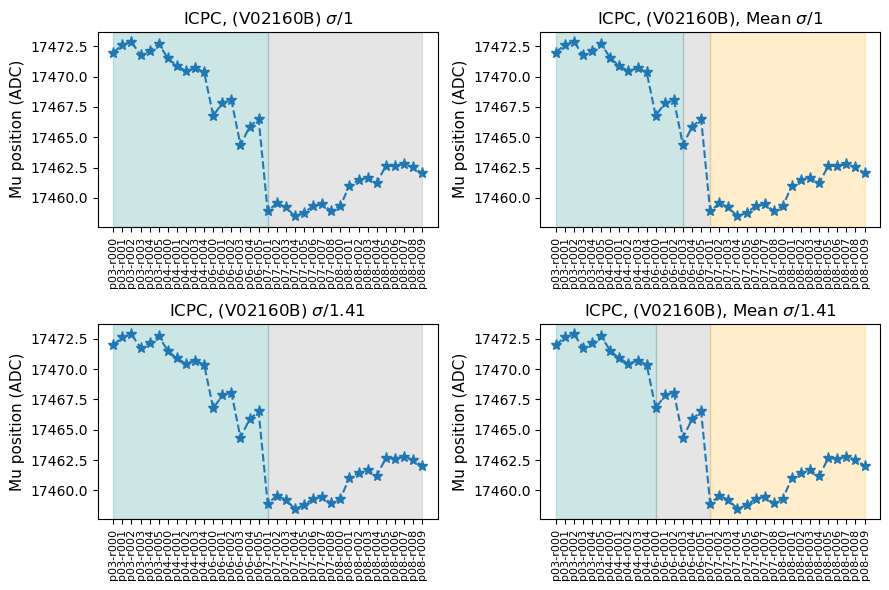

-------------------------------------------------------------------------------------------


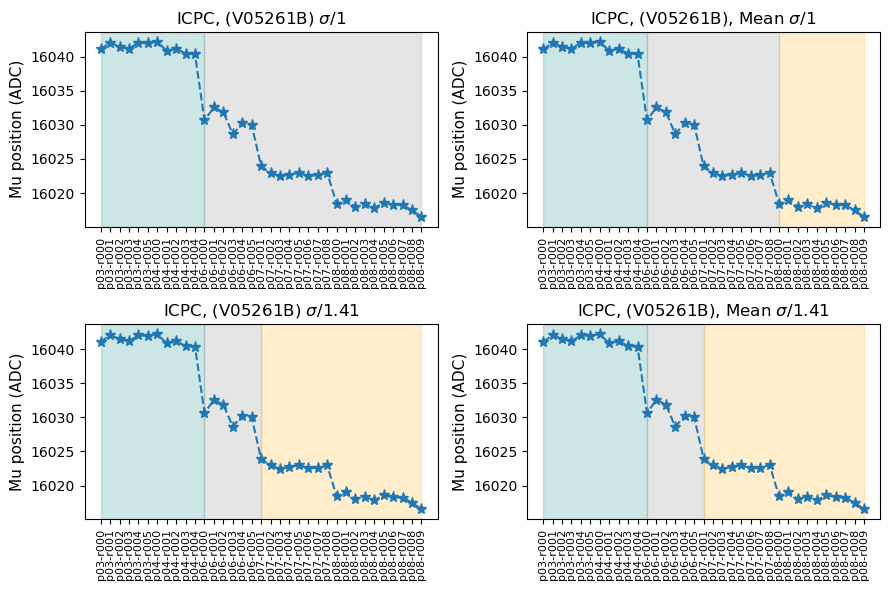

-------------------------------------------------------------------------------------------


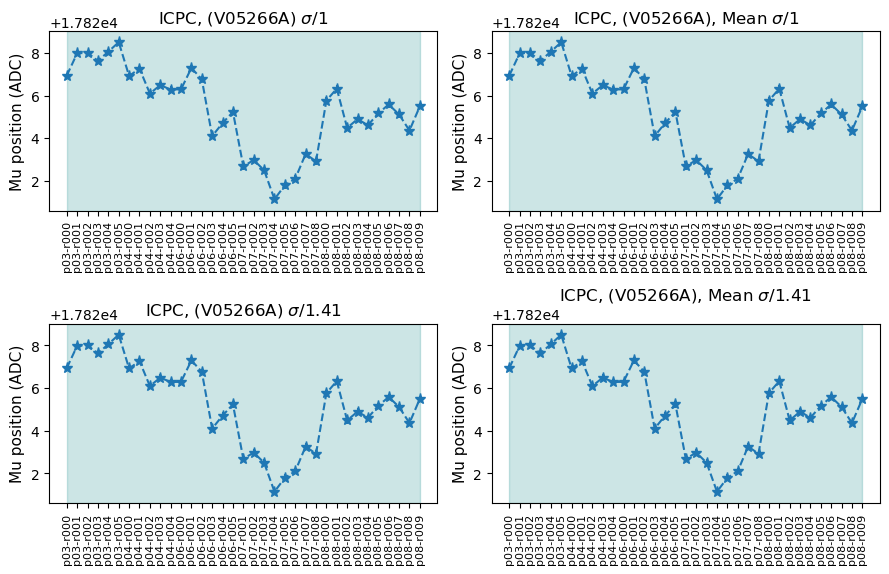

-------------------------------------------------------------------------------------------


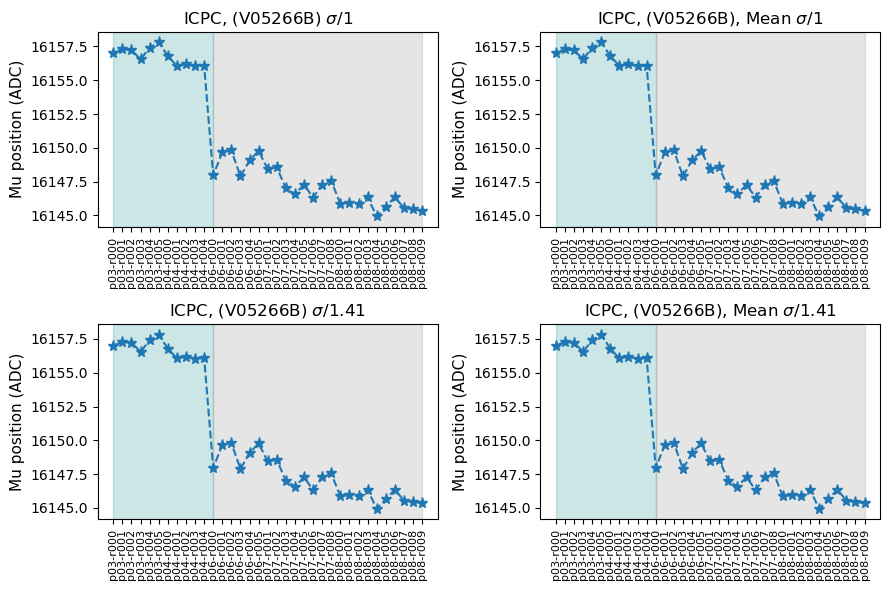

-------------------------------------------------------------------------------------------


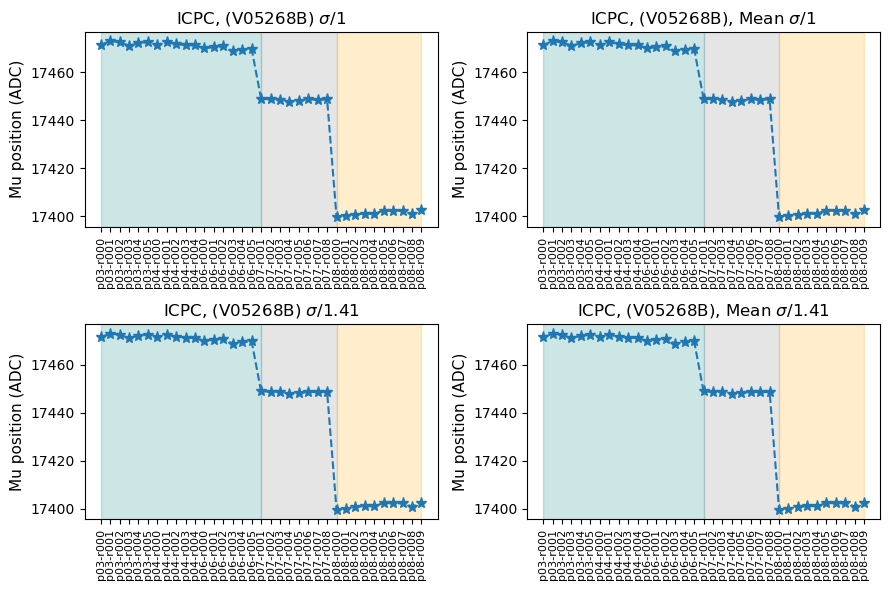

-------------------------------------------------------------------------------------------


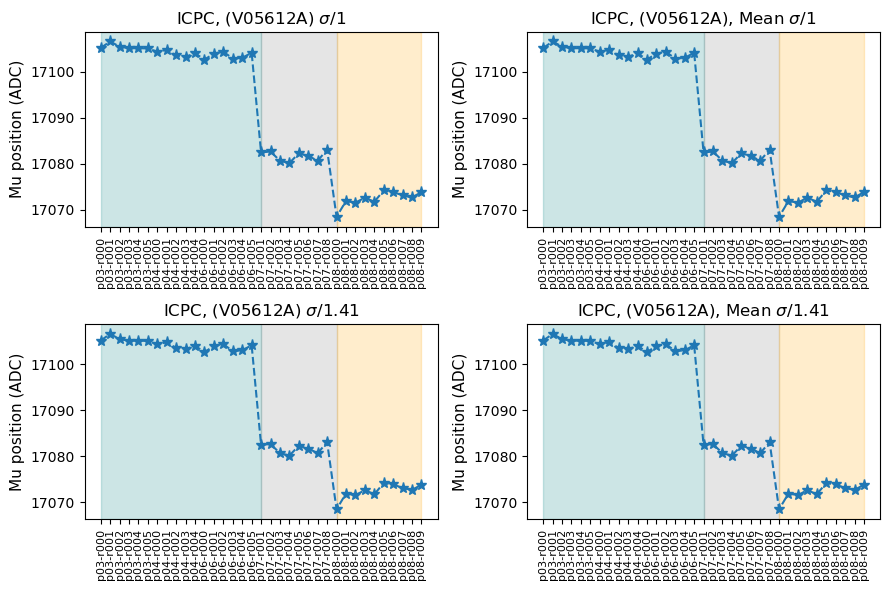

-------------------------------------------------------------------------------------------


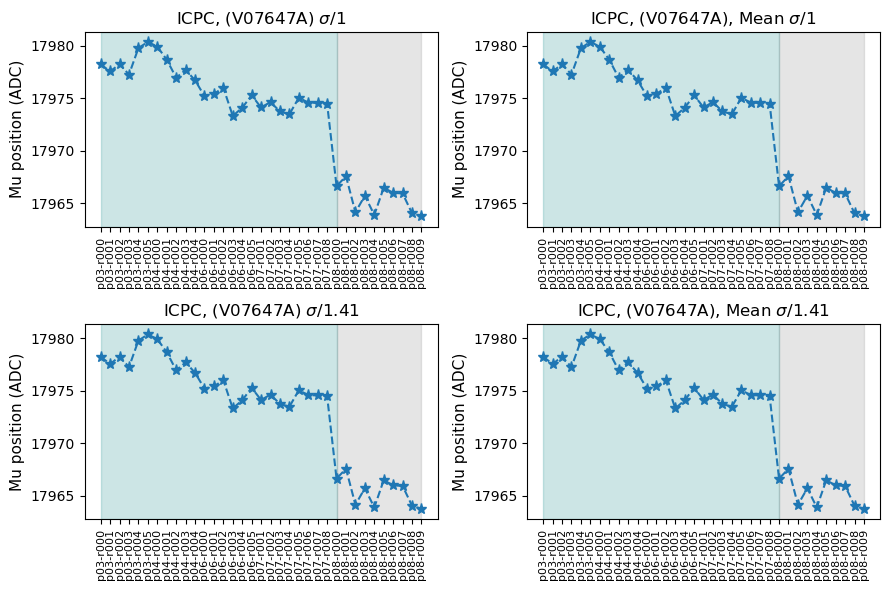

-------------------------------------------------------------------------------------------


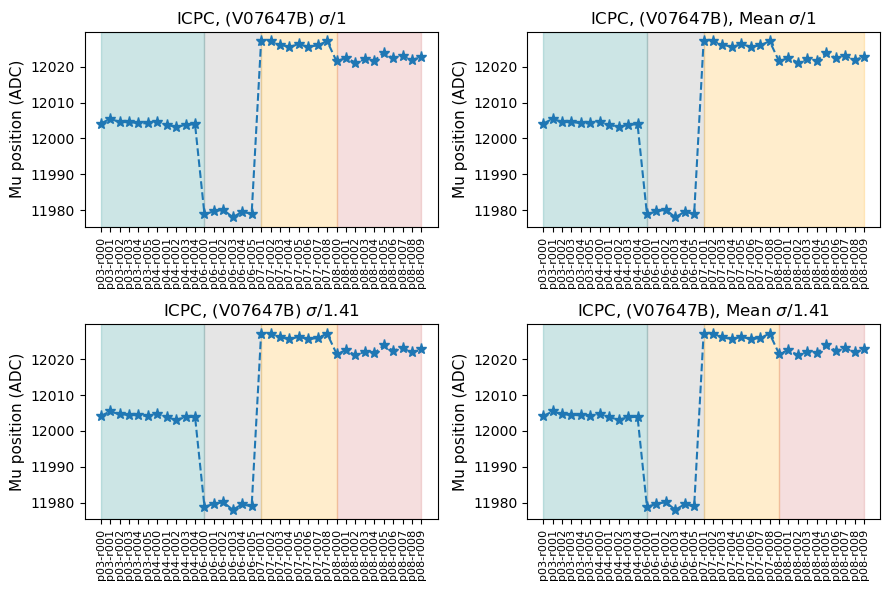

-------------------------------------------------------------------------------------------


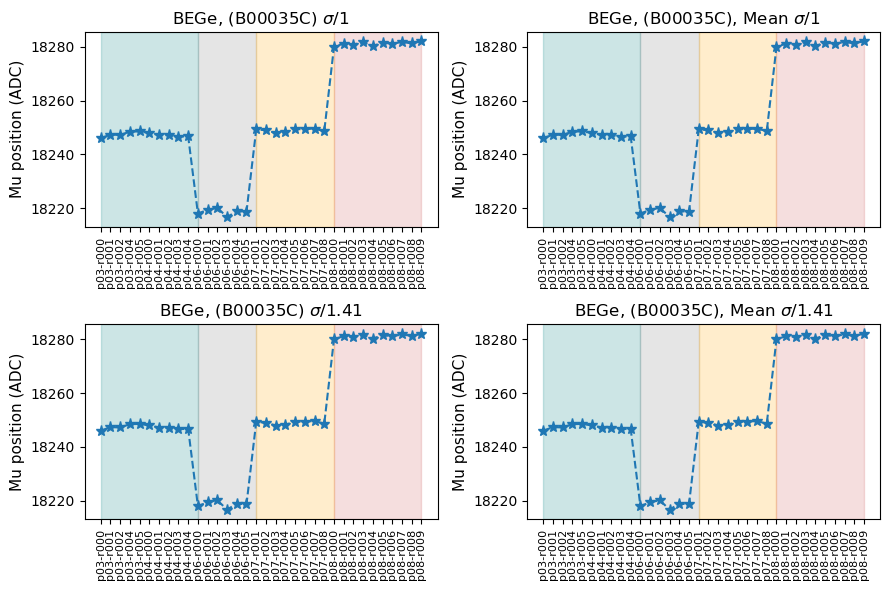

-------------------------------------------------------------------------------------------


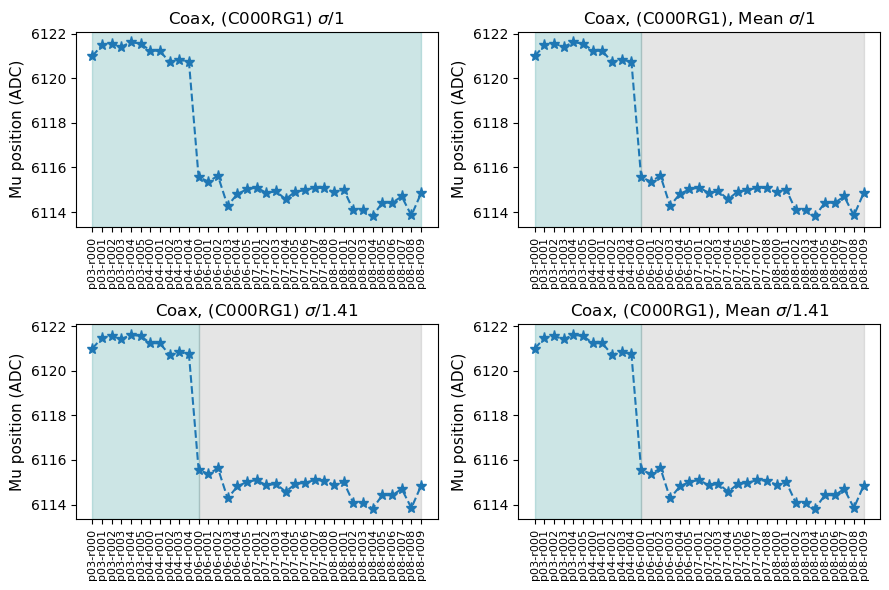

-------------------------------------------------------------------------------------------


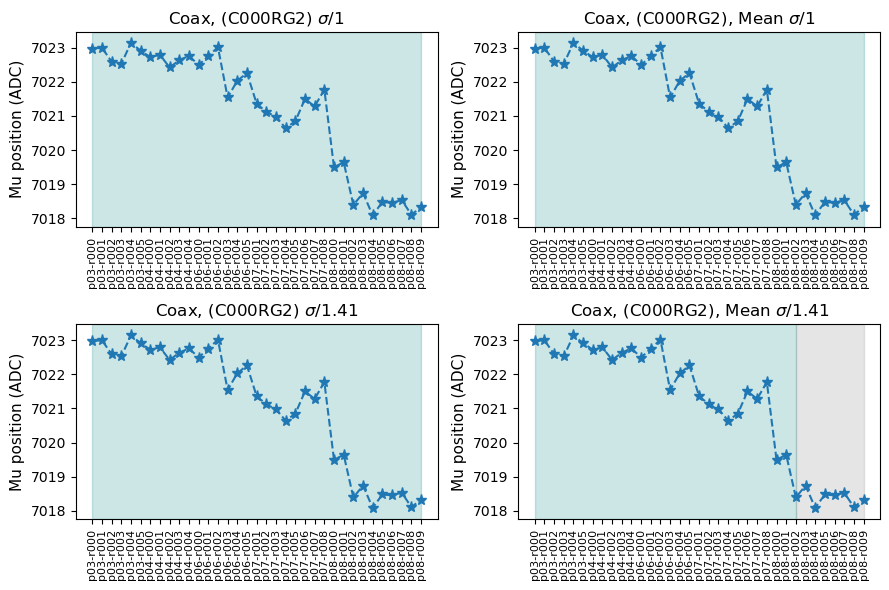

-------------------------------------------------------------------------------------------


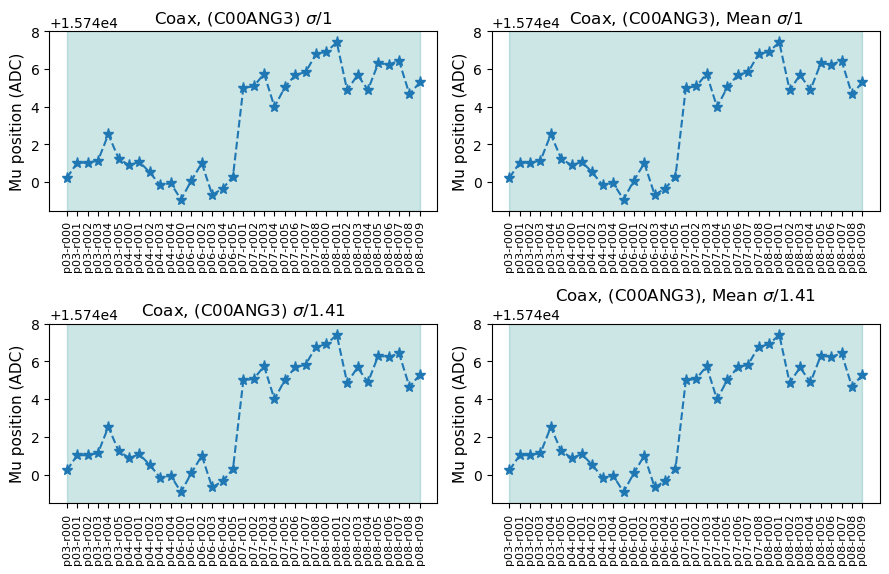

-------------------------------------------------------------------------------------------


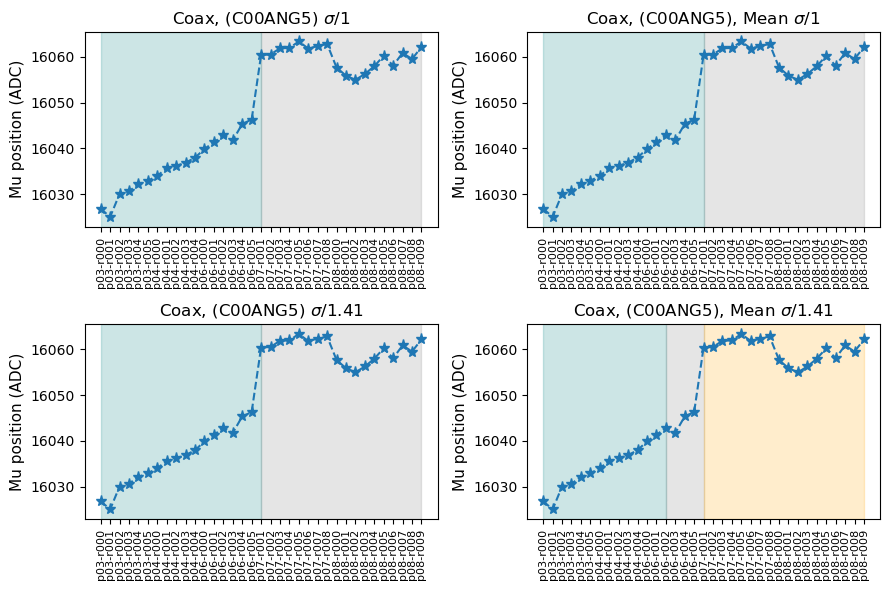

-------------------------------------------------------------------------------------------


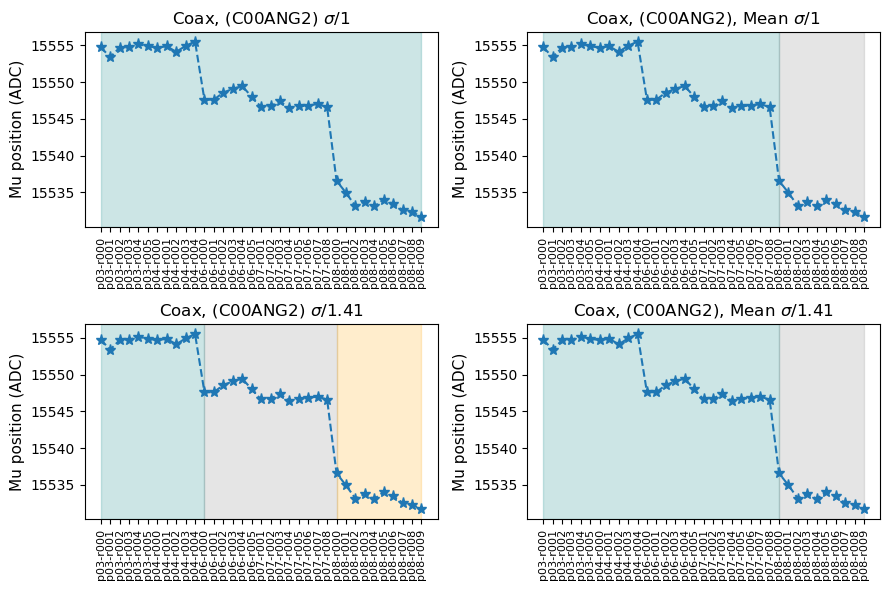

-------------------------------------------------------------------------------------------


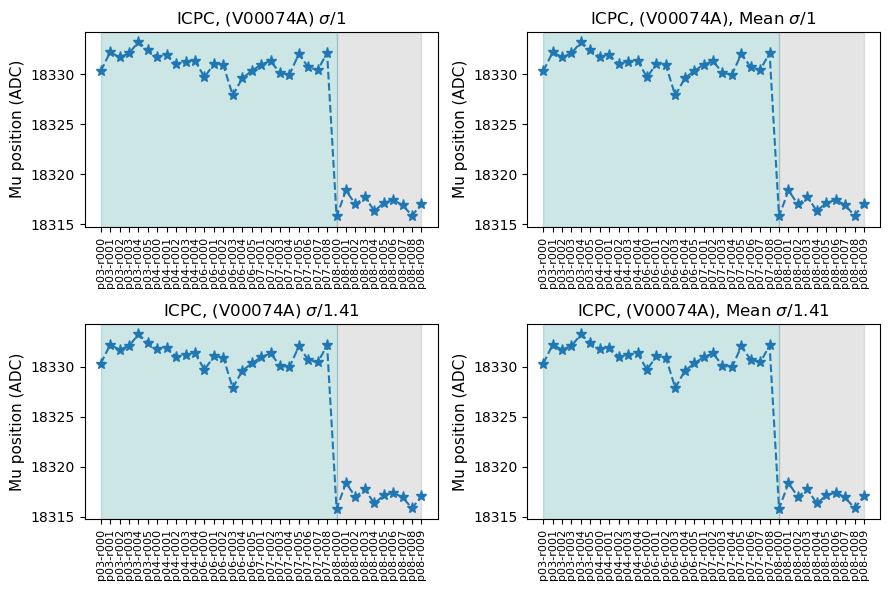

-------------------------------------------------------------------------------------------


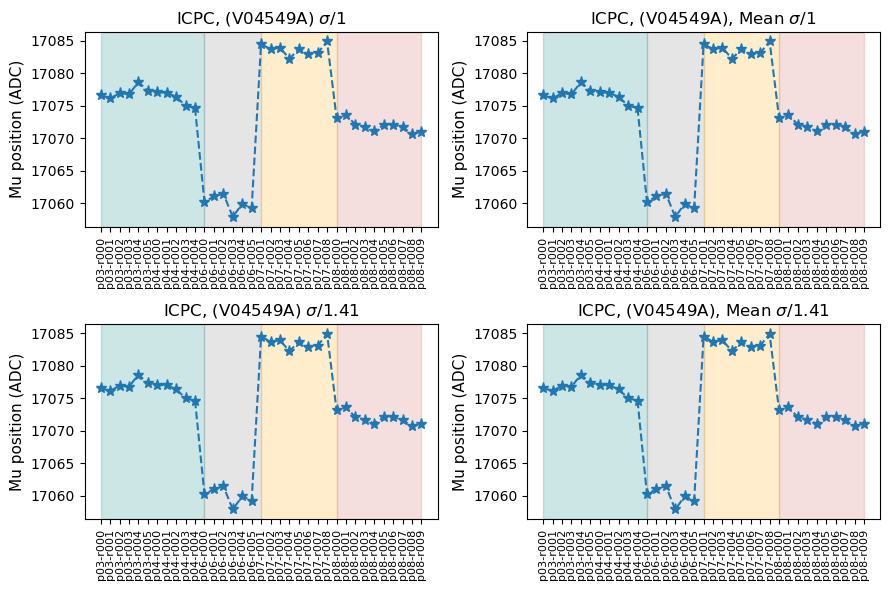

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


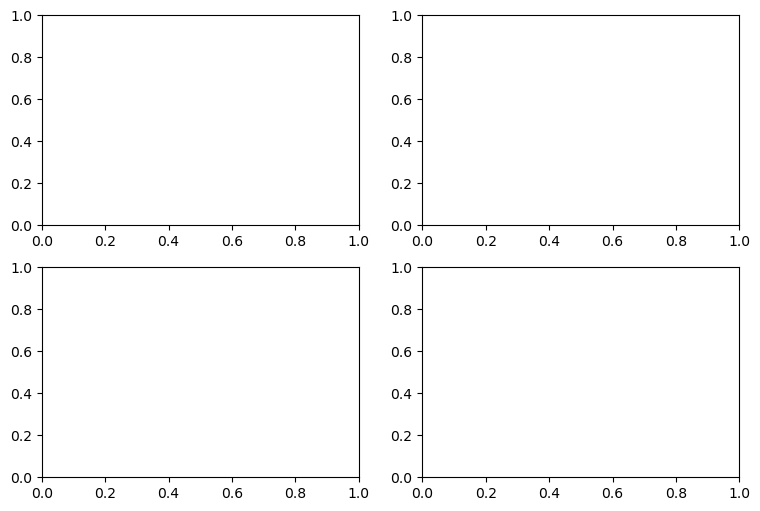

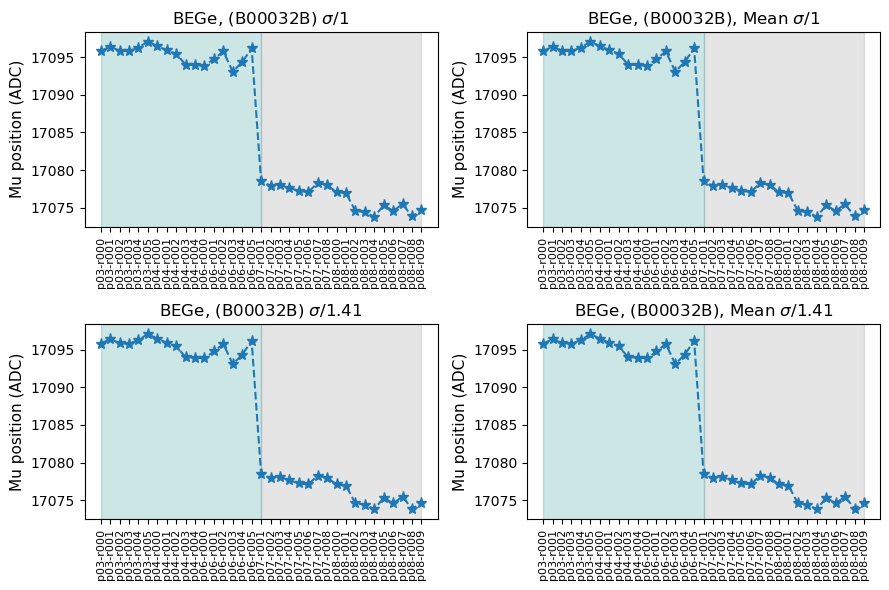

-------------------------------------------------------------------------------------------


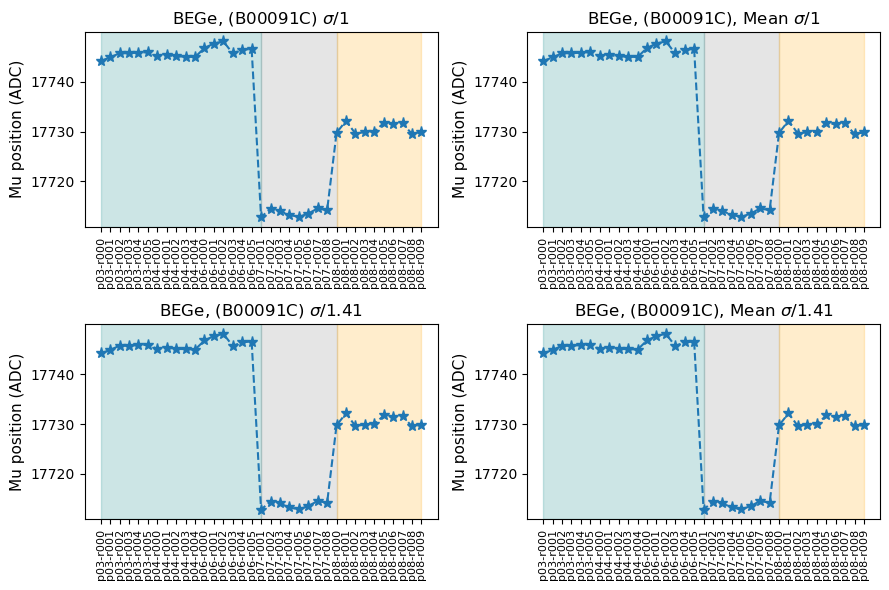

-------------------------------------------------------------------------------------------


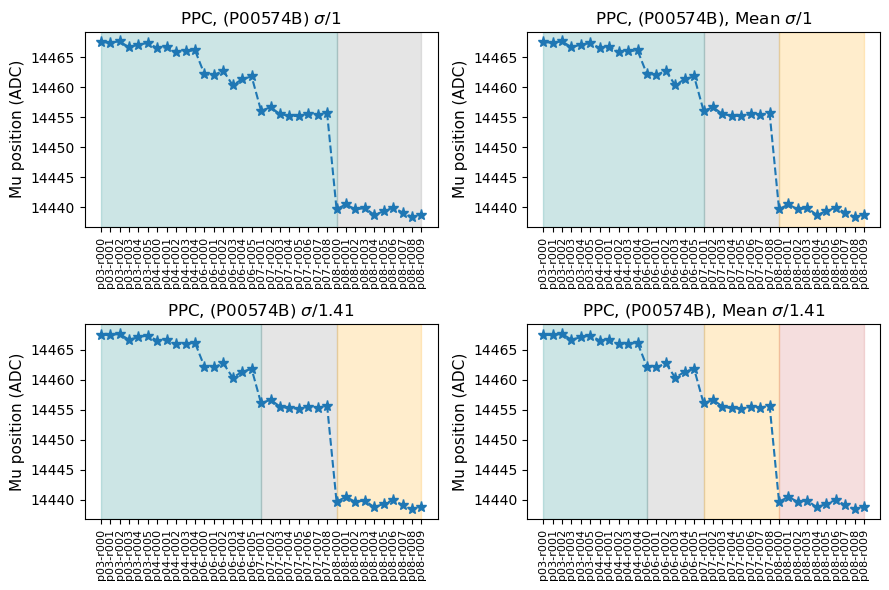

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


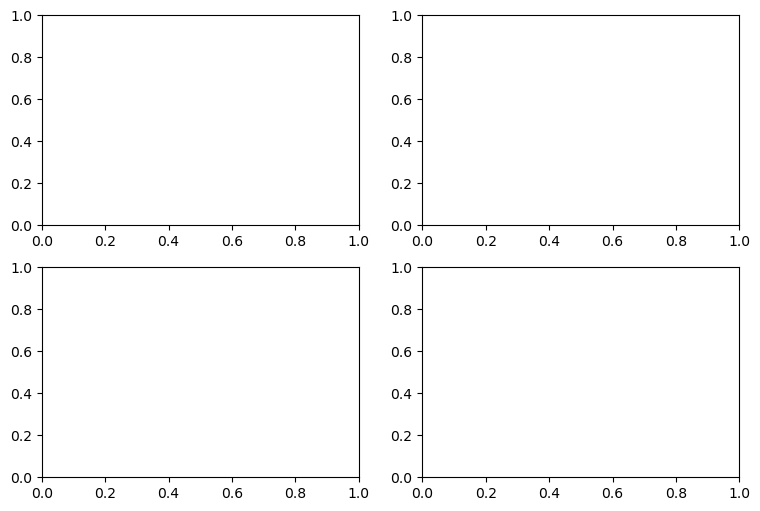

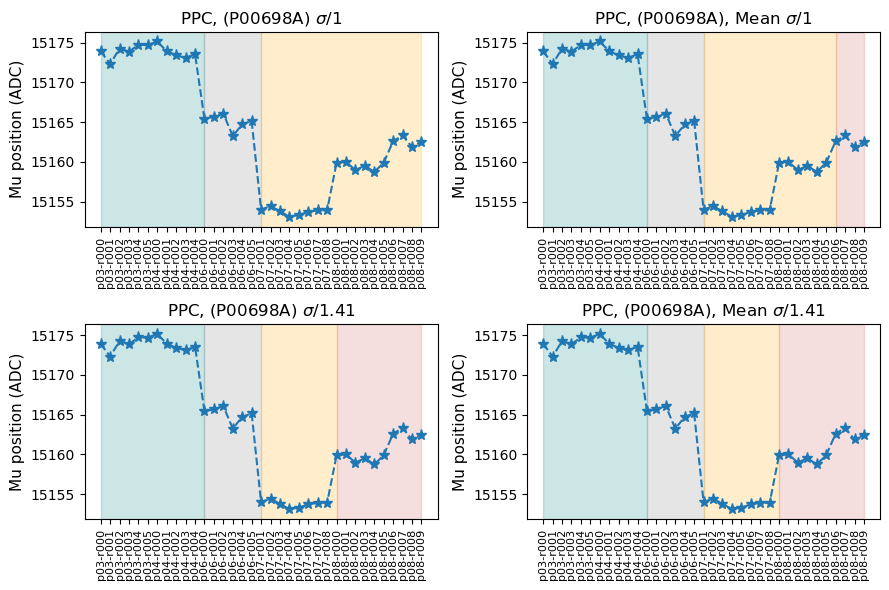

-------------------------------------------------------------------------------------------


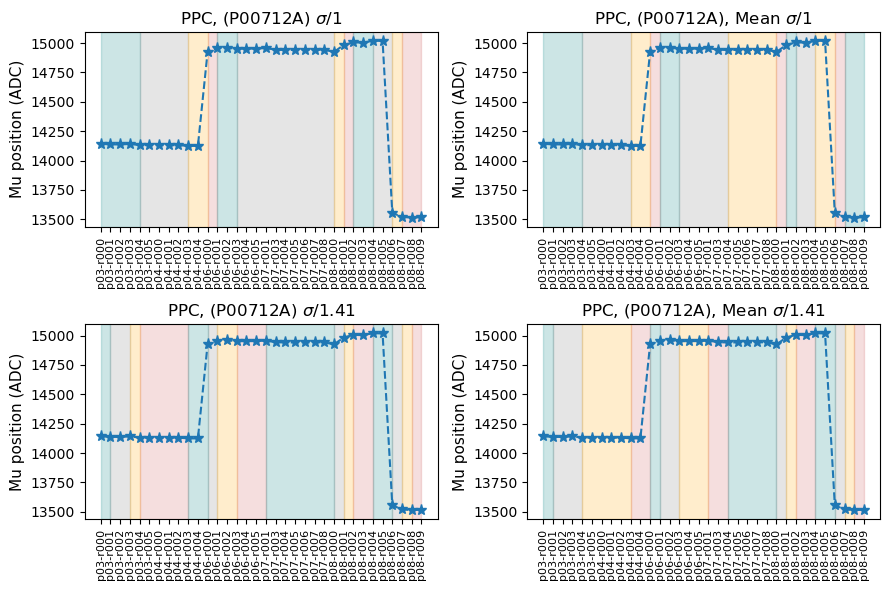

-------------------------------------------------------------------------------------------


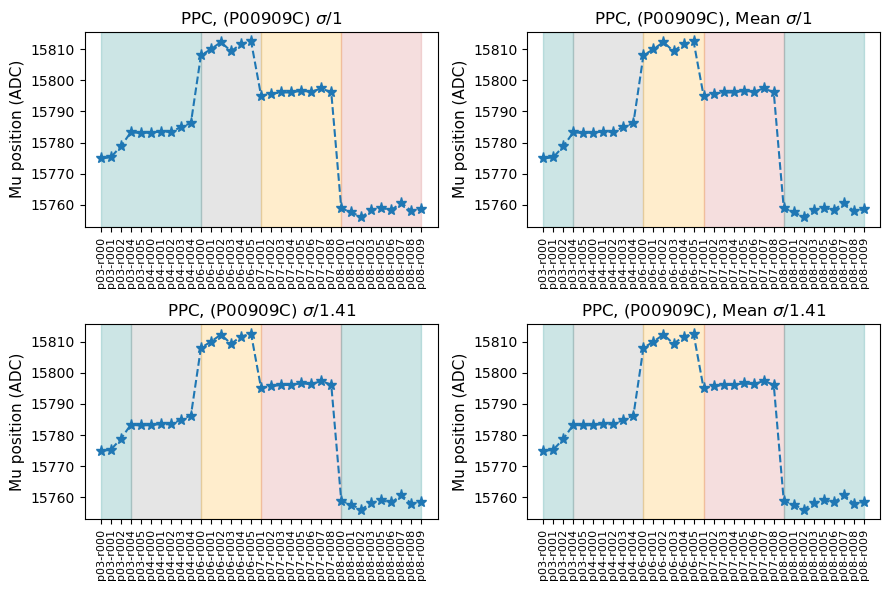

-------------------------------------------------------------------------------------------


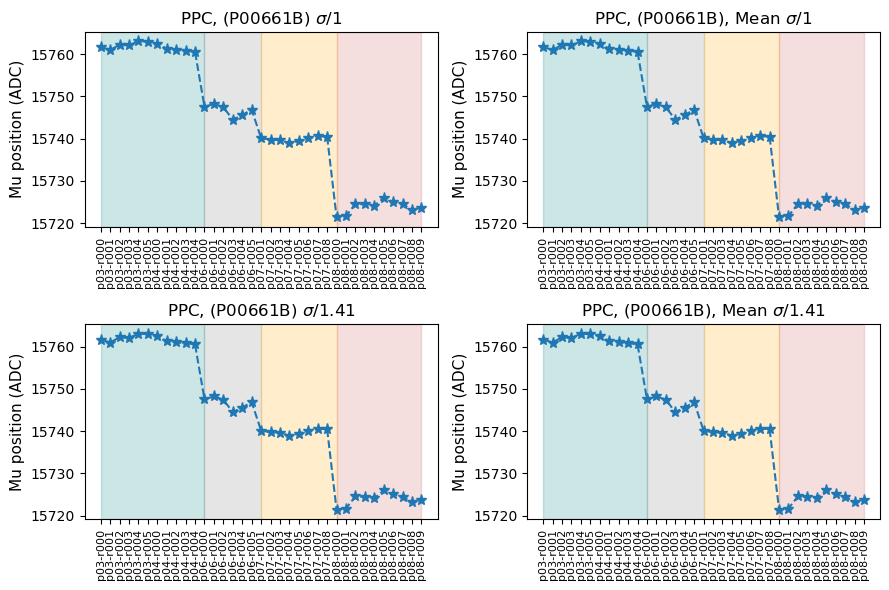

-------------------------------------------------------------------------------------------


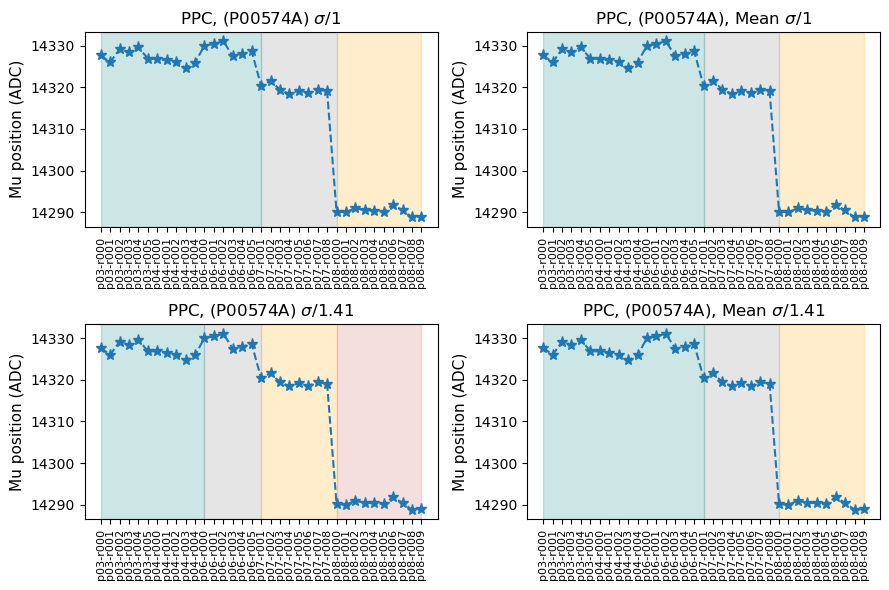

-------------------------------------------------------------------------------------------


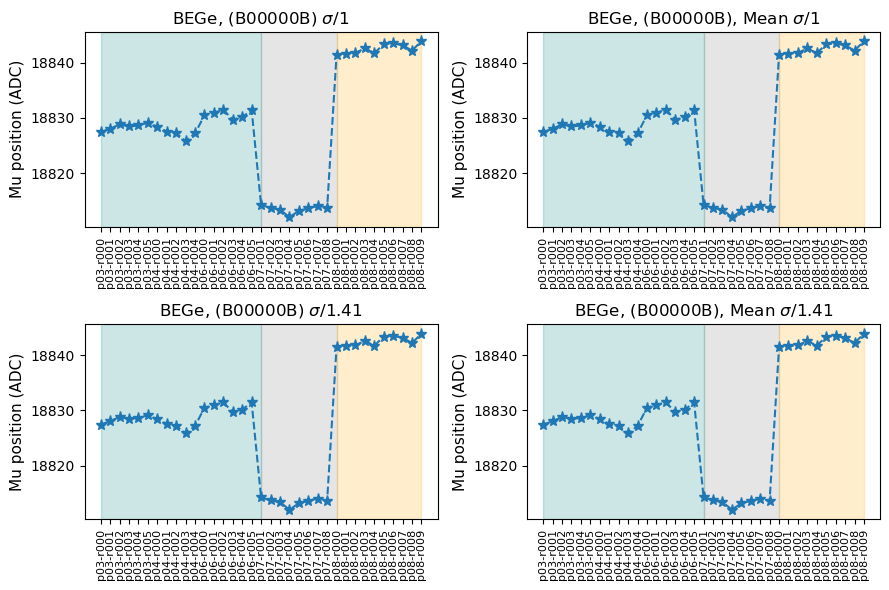

-------------------------------------------------------------------------------------------


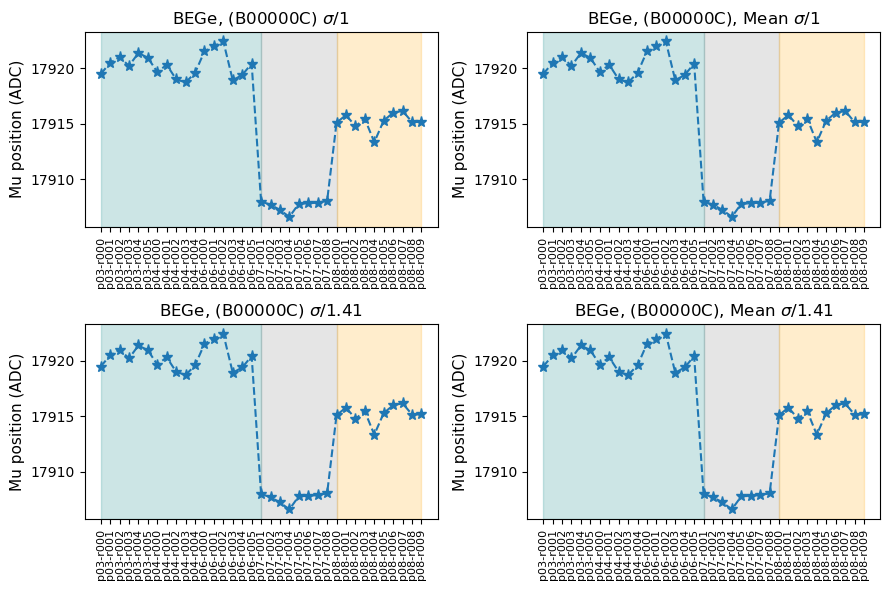

-------------------------------------------------------------------------------------------


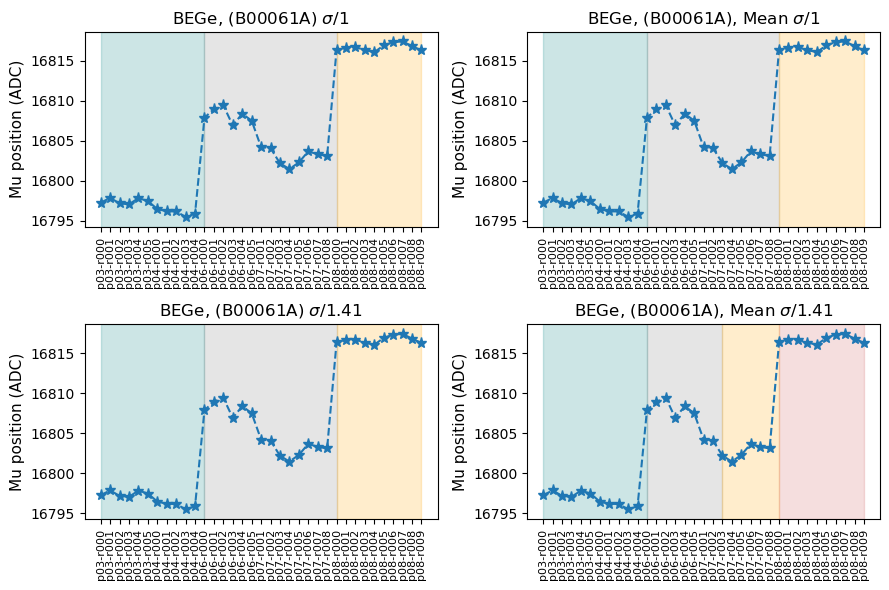

-------------------------------------------------------------------------------------------


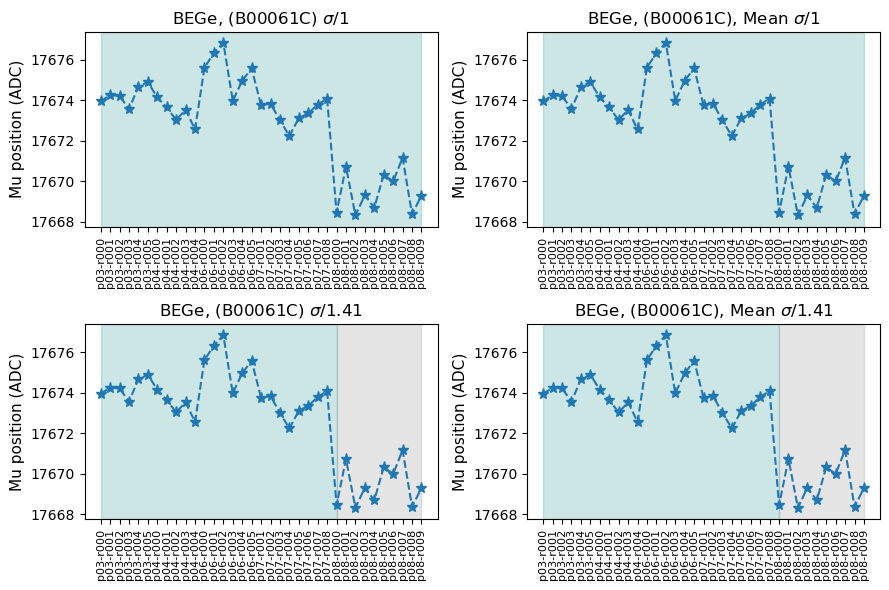

-------------------------------------------------------------------------------------------


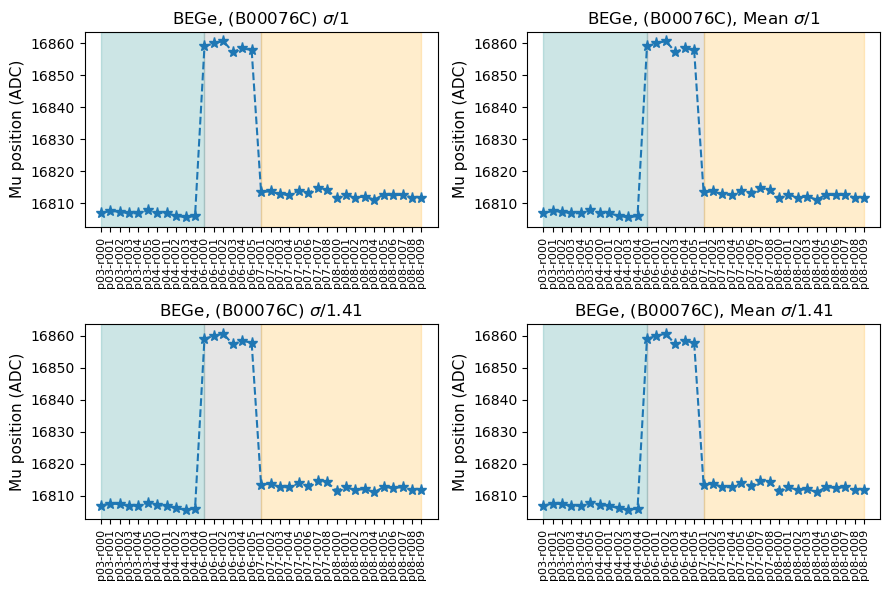

-------------------------------------------------------------------------------------------


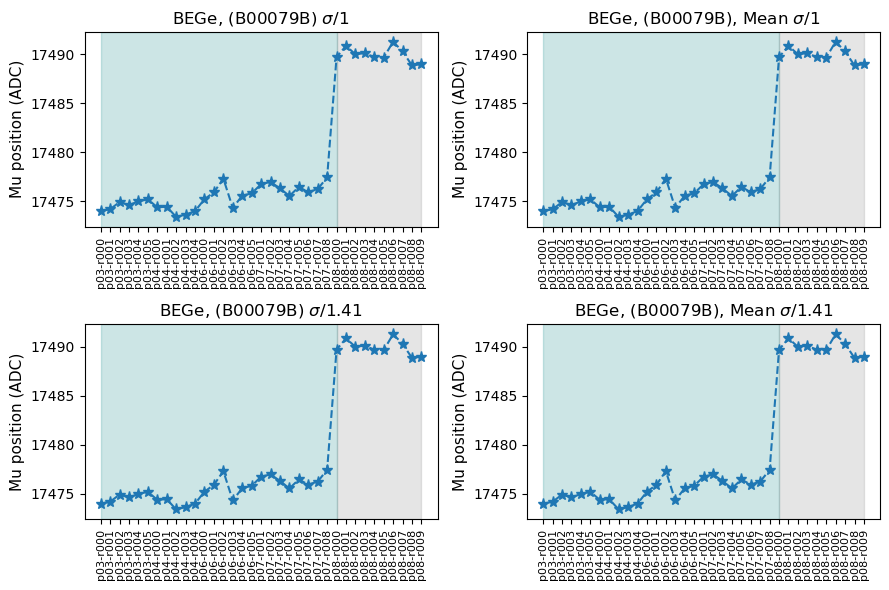

-------------------------------------------------------------------------------------------


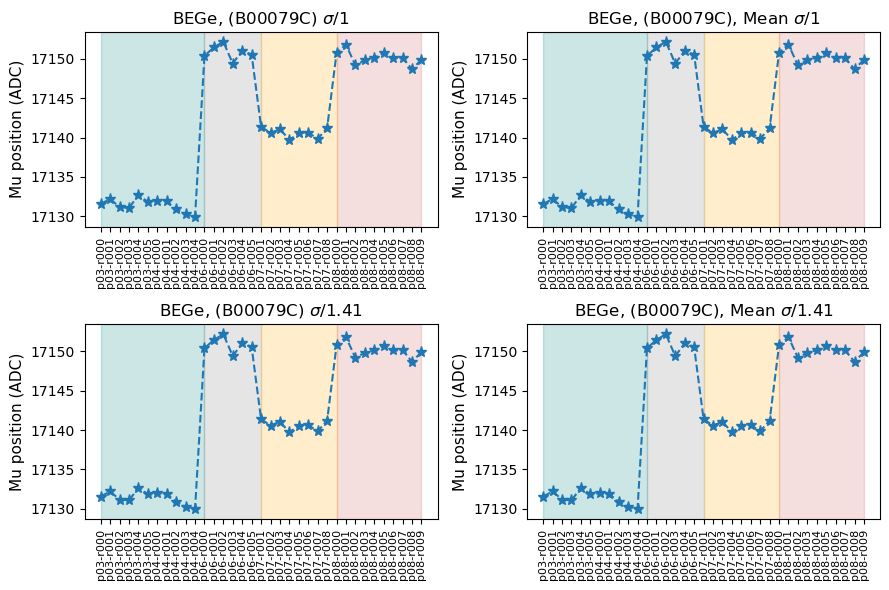

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


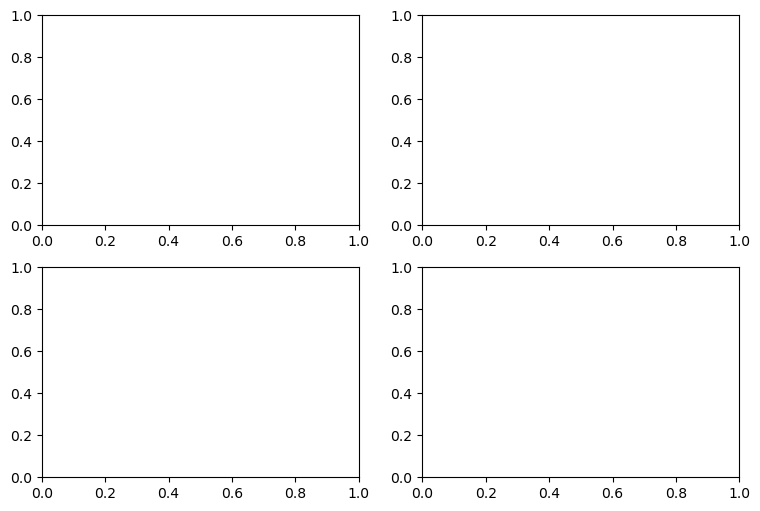

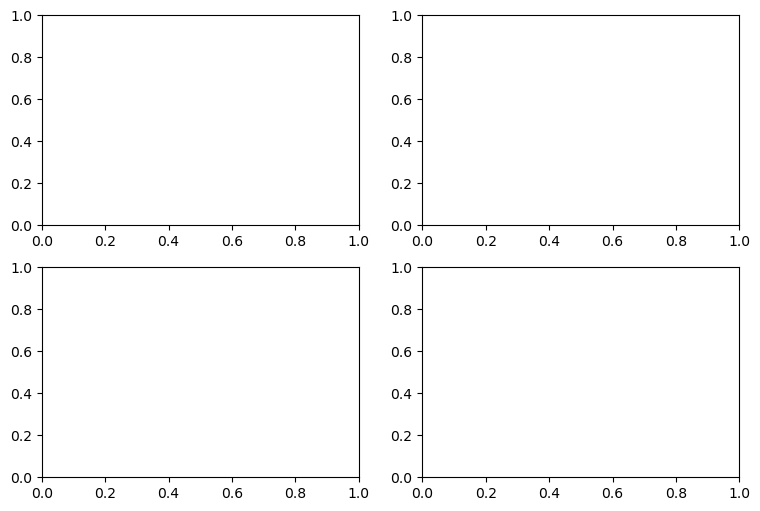

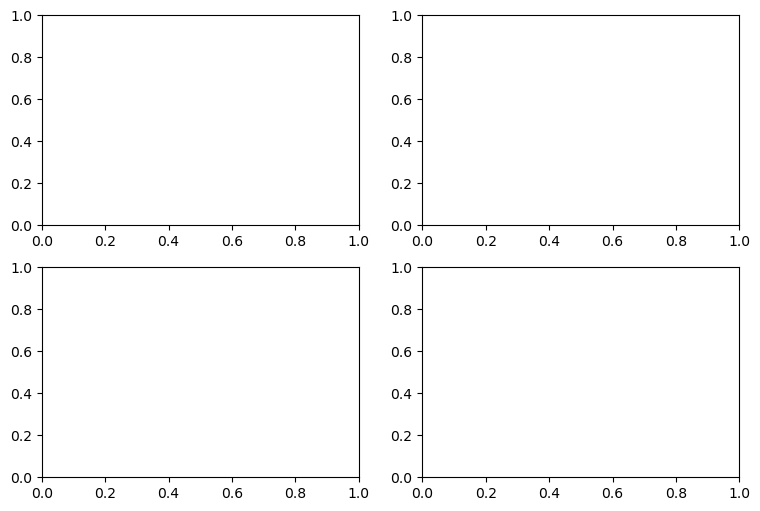

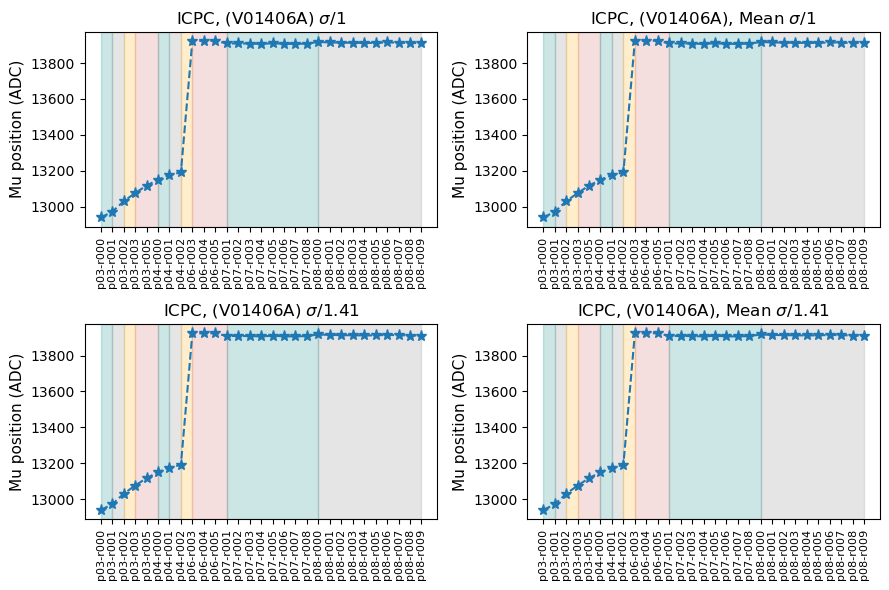

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


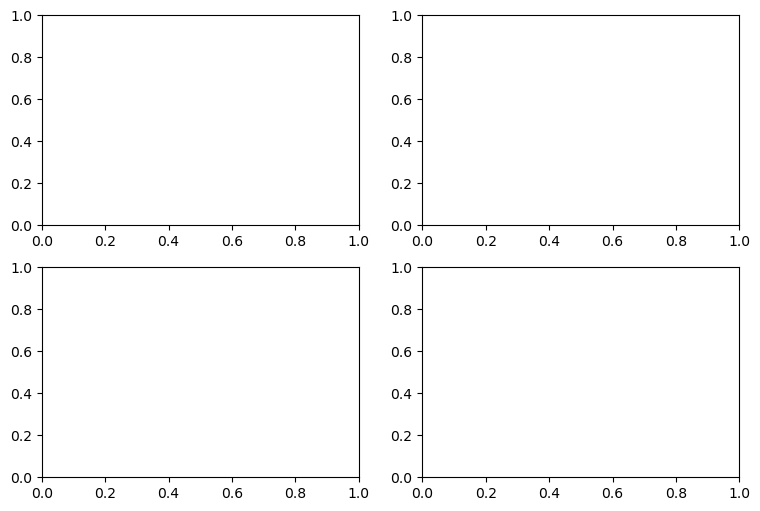

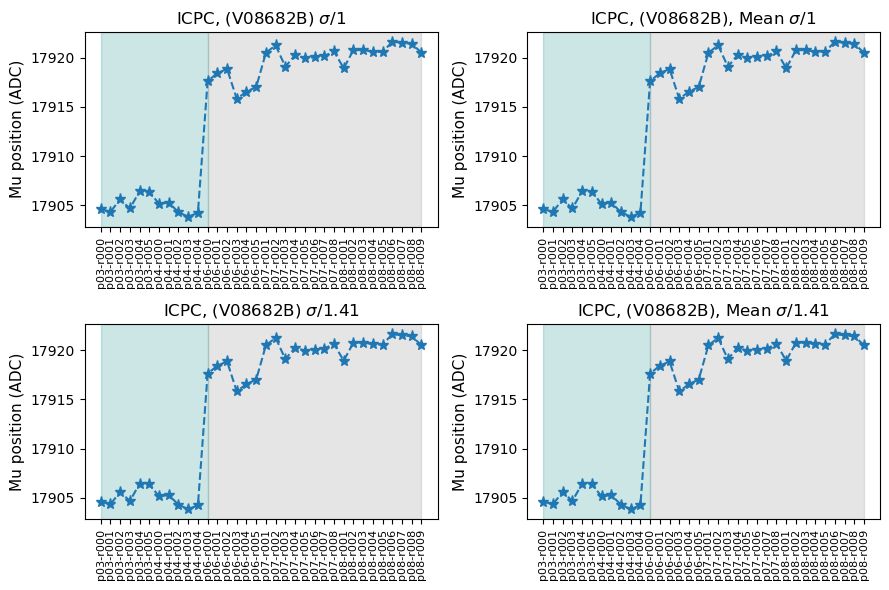

-------------------------------------------------------------------------------------------


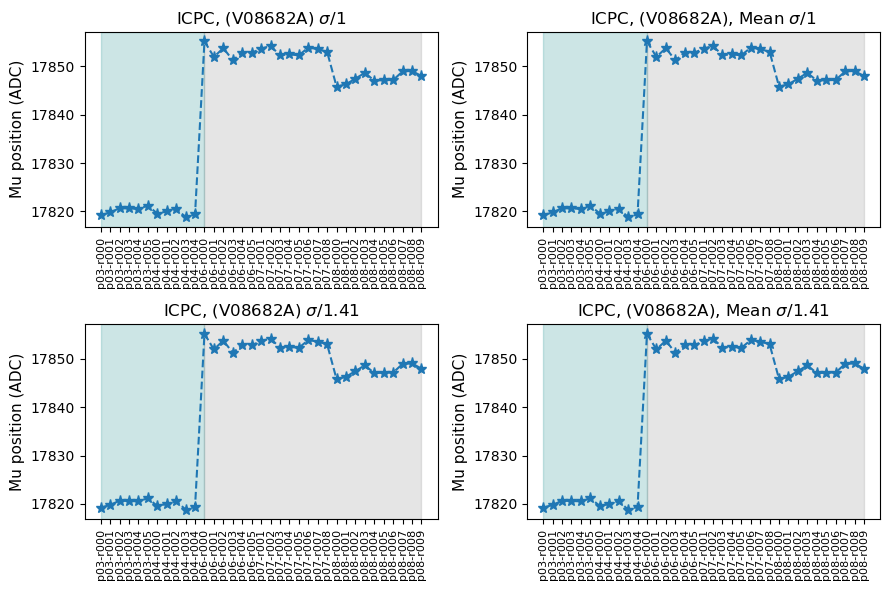

-------------------------------------------------------------------------------------------


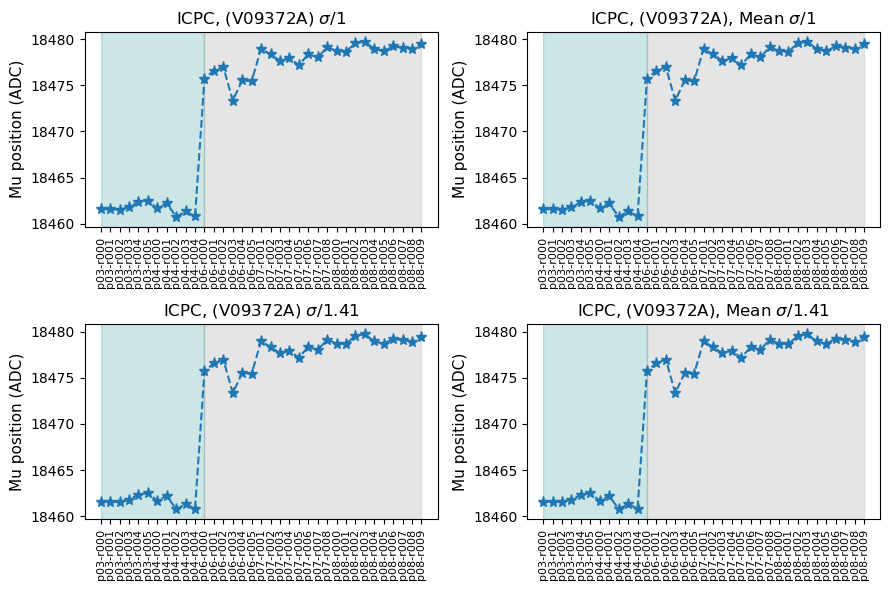

-------------------------------------------------------------------------------------------


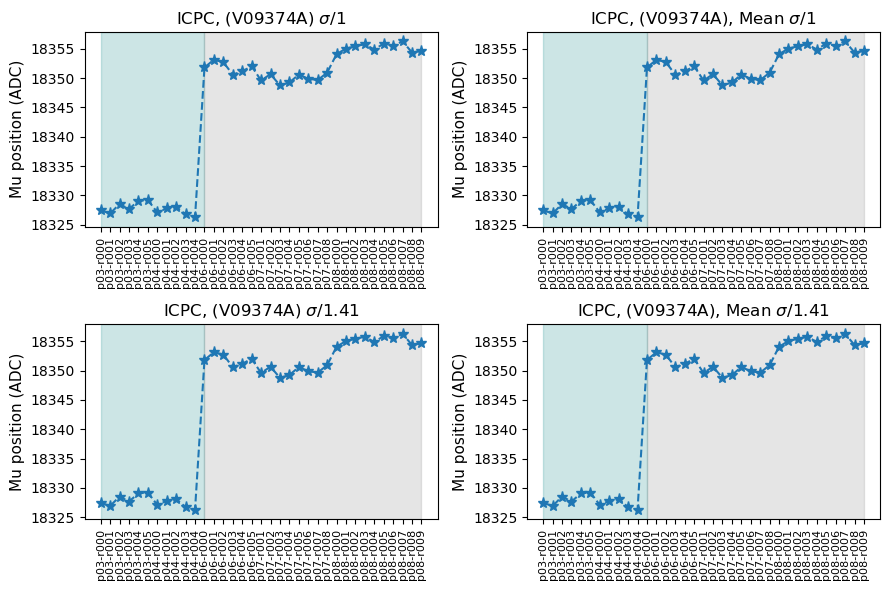

-------------------------------------------------------------------------------------------


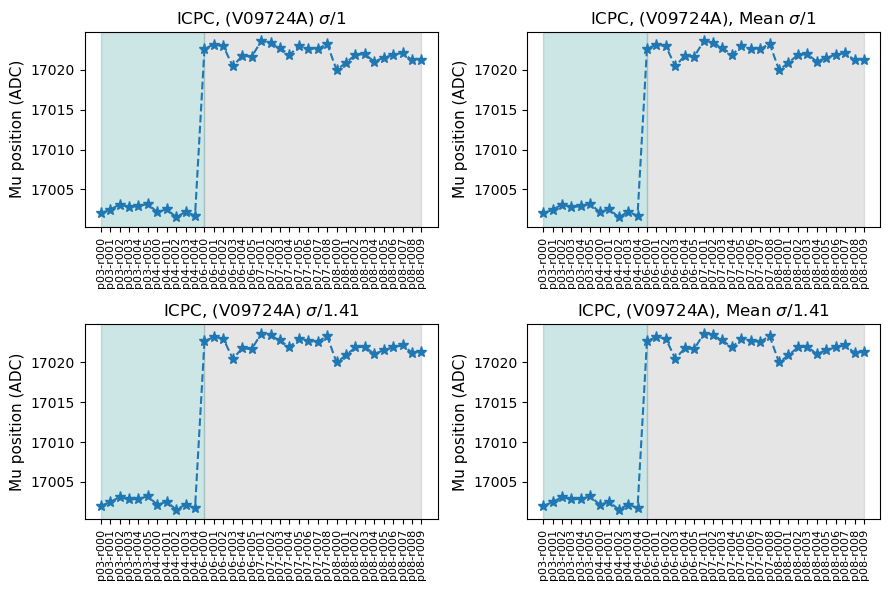

-------------------------------------------------------------------------------------------


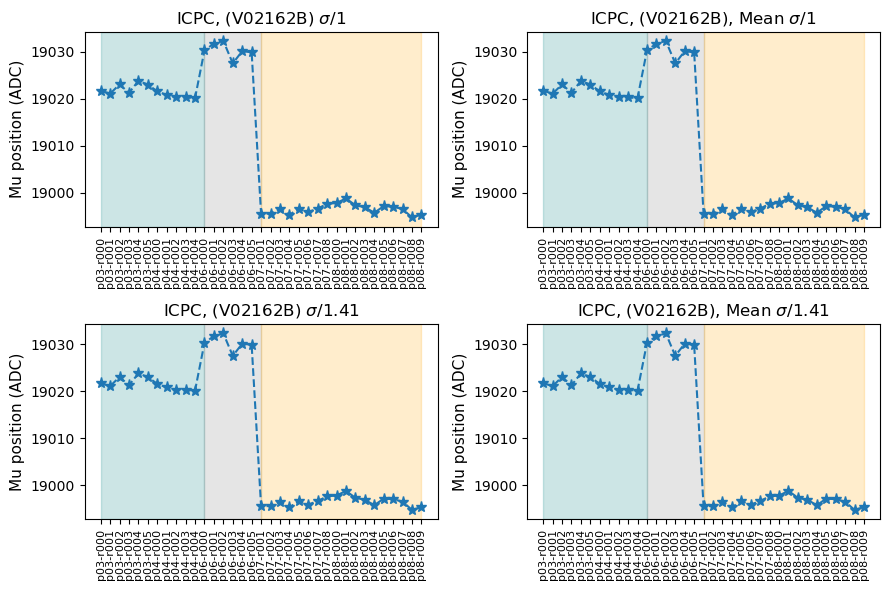

-------------------------------------------------------------------------------------------


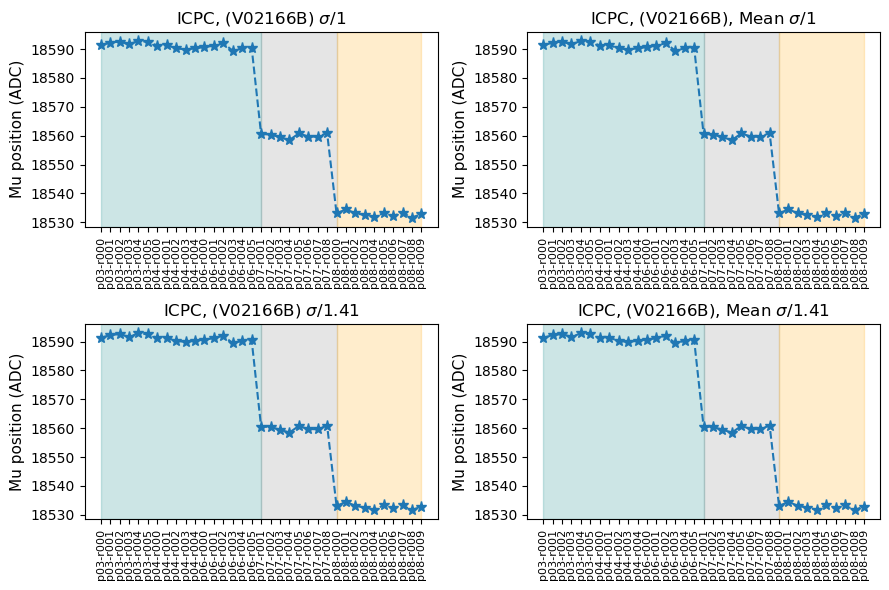

-------------------------------------------------------------------------------------------


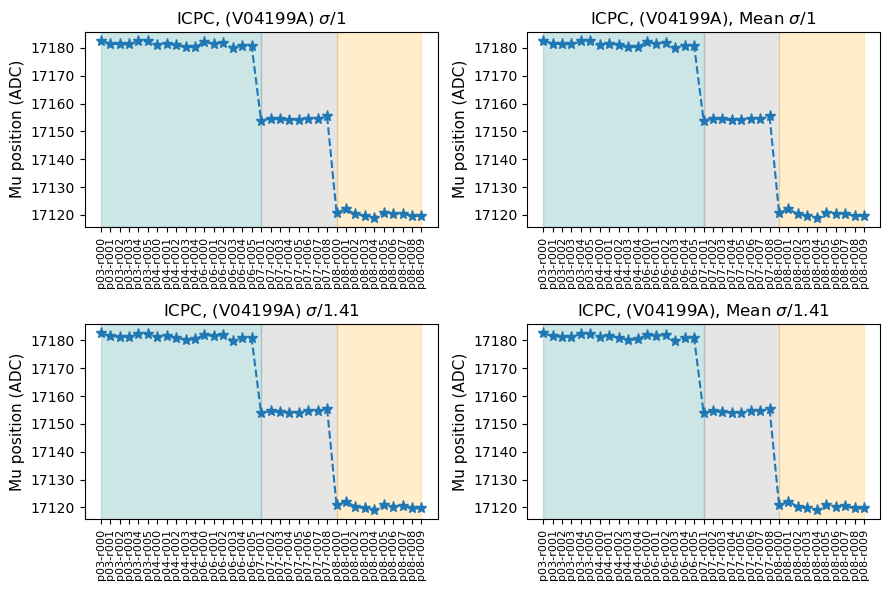

-------------------------------------------------------------------------------------------


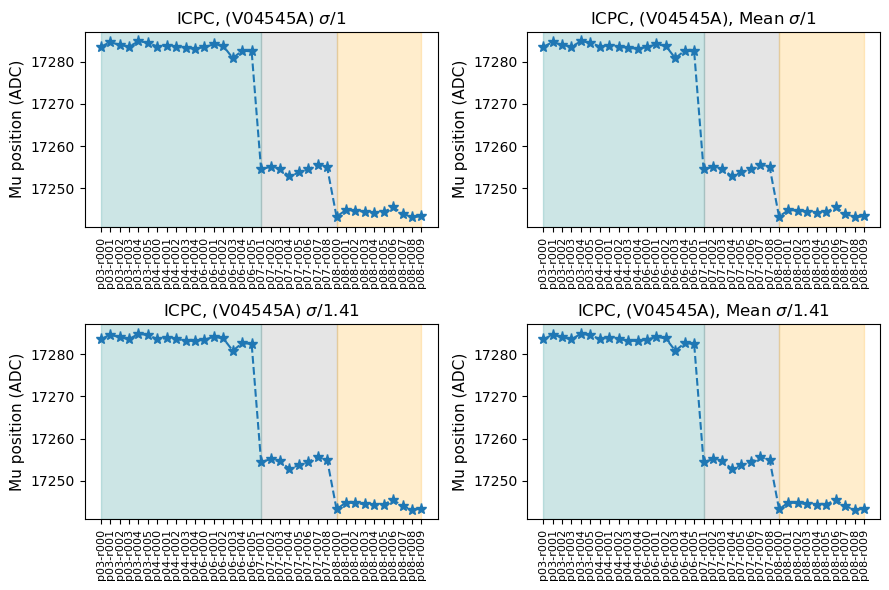

-------------------------------------------------------------------------------------------


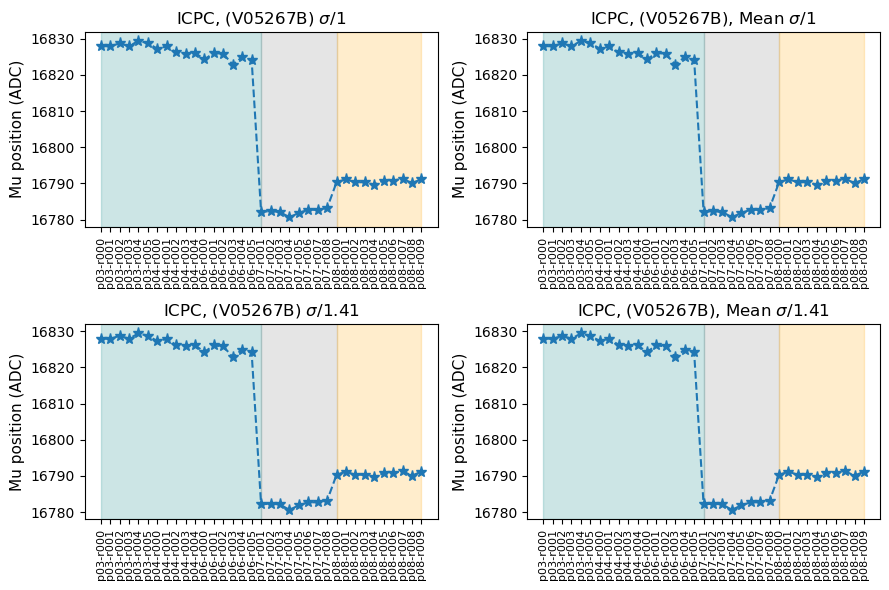

-------------------------------------------------------------------------------------------


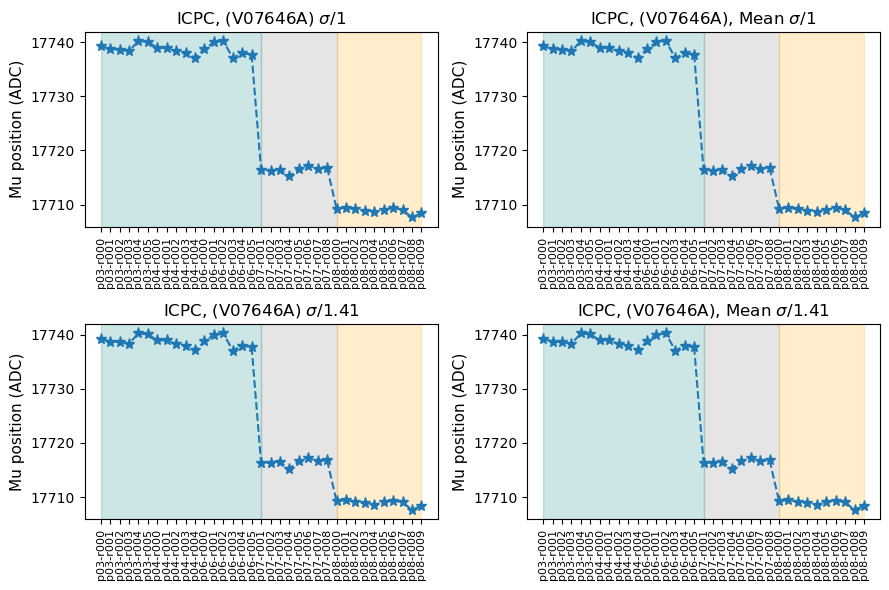

-------------------------------------------------------------------------------------------


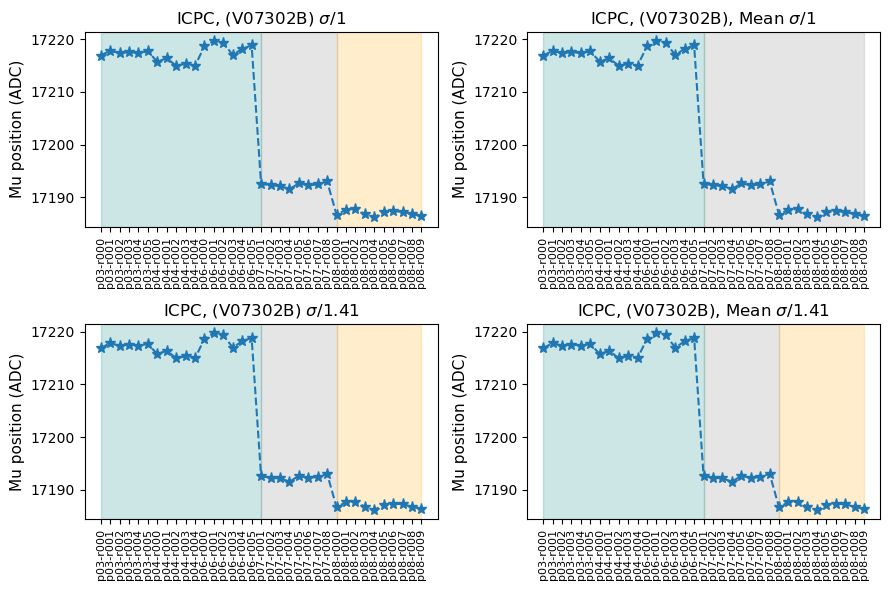

-------------------------------------------------------------------------------------------


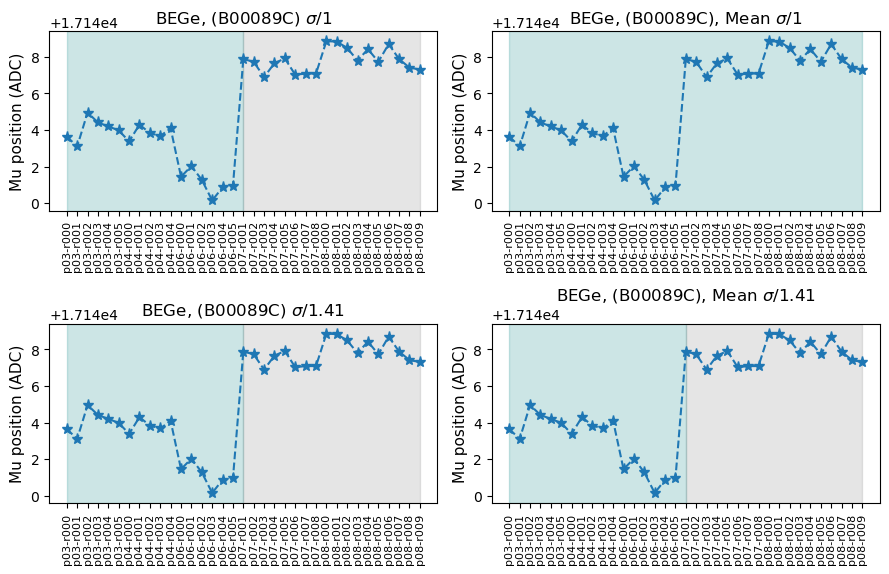

-------------------------------------------------------------------------------------------


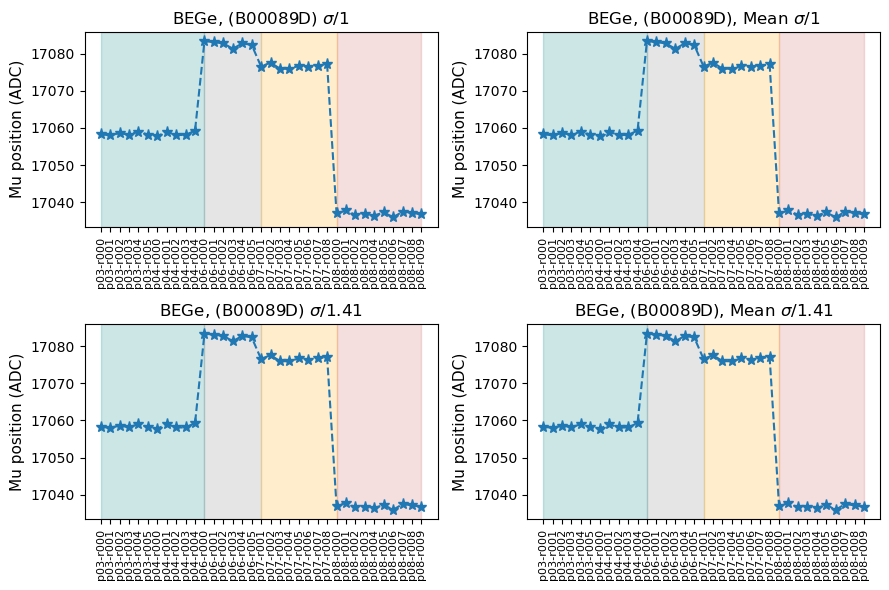

-------------------------------------------------------------------------------------------


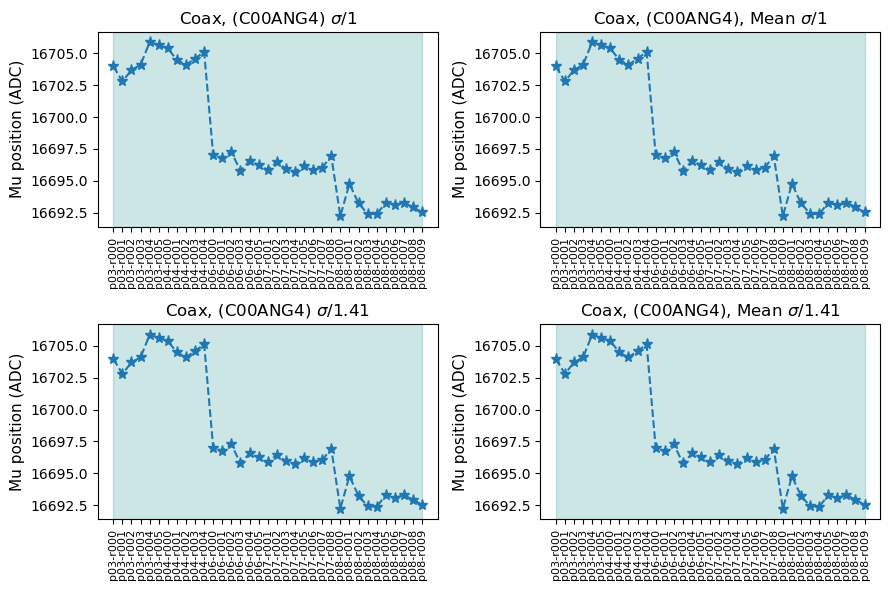

-------------------------------------------------------------------------------------------


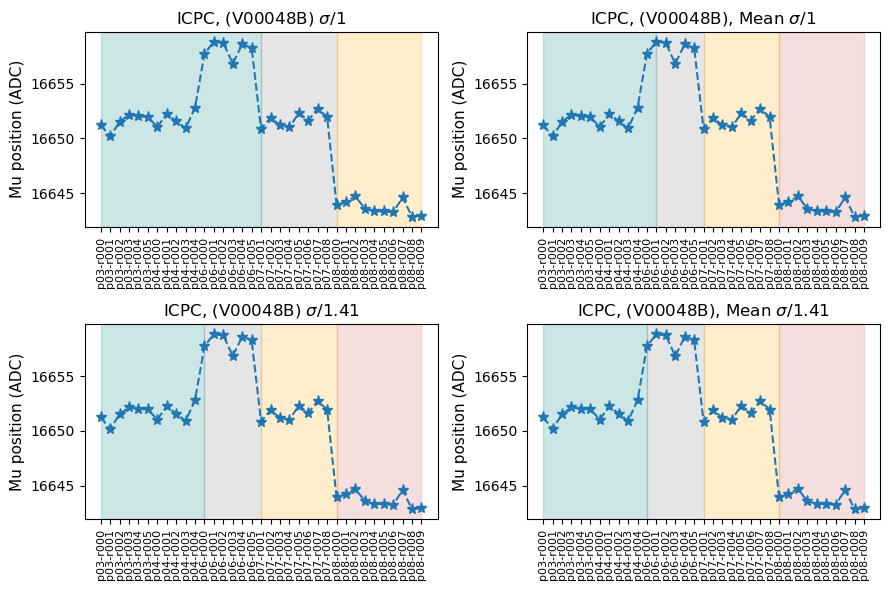

-------------------------------------------------------------------------------------------


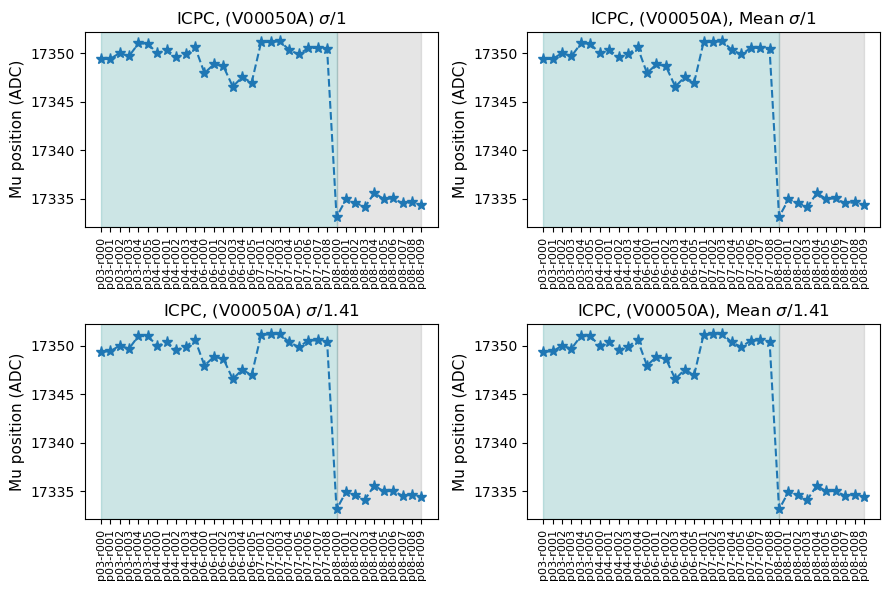

-------------------------------------------------------------------------------------------


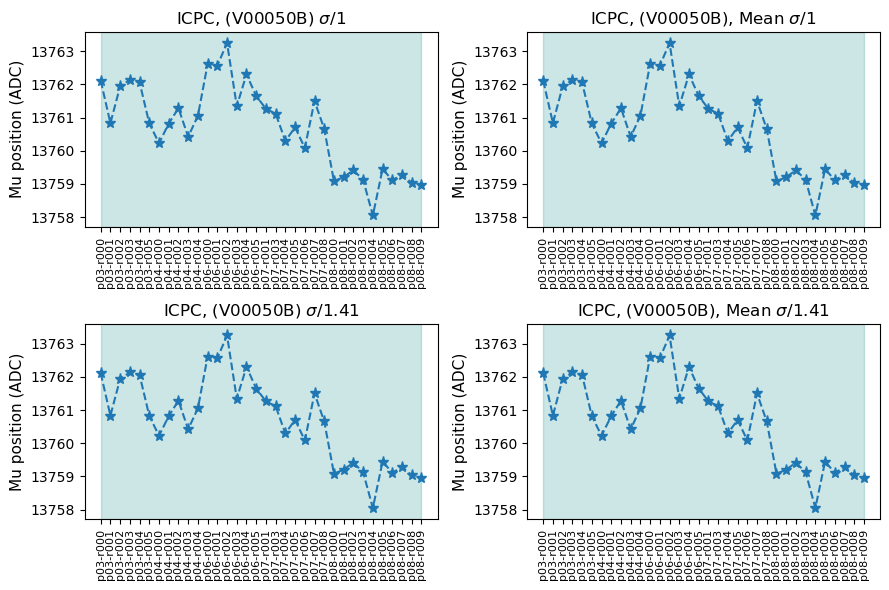

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


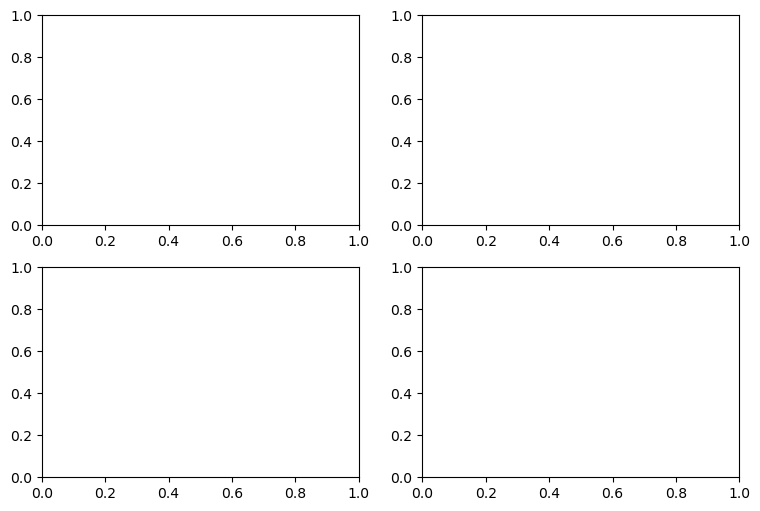

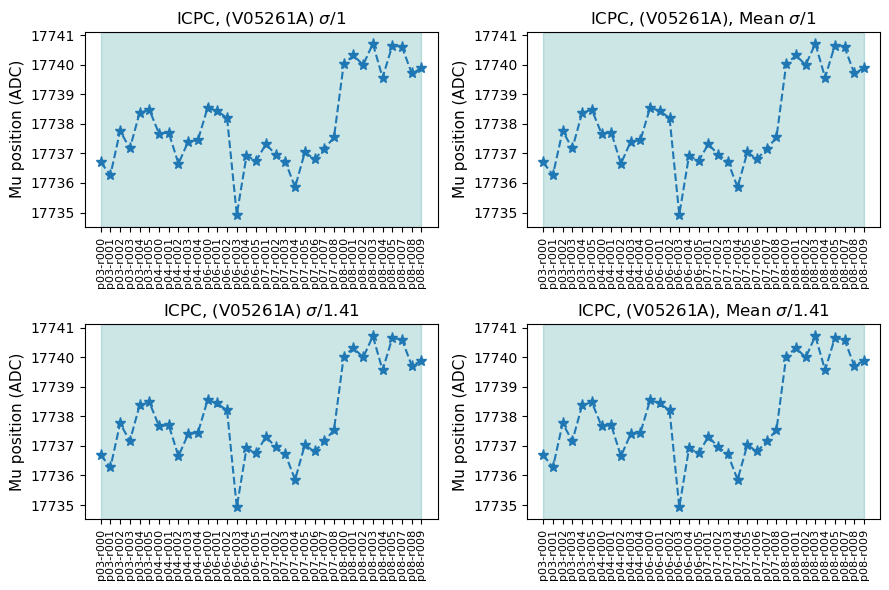

-------------------------------------------------------------------------------------------


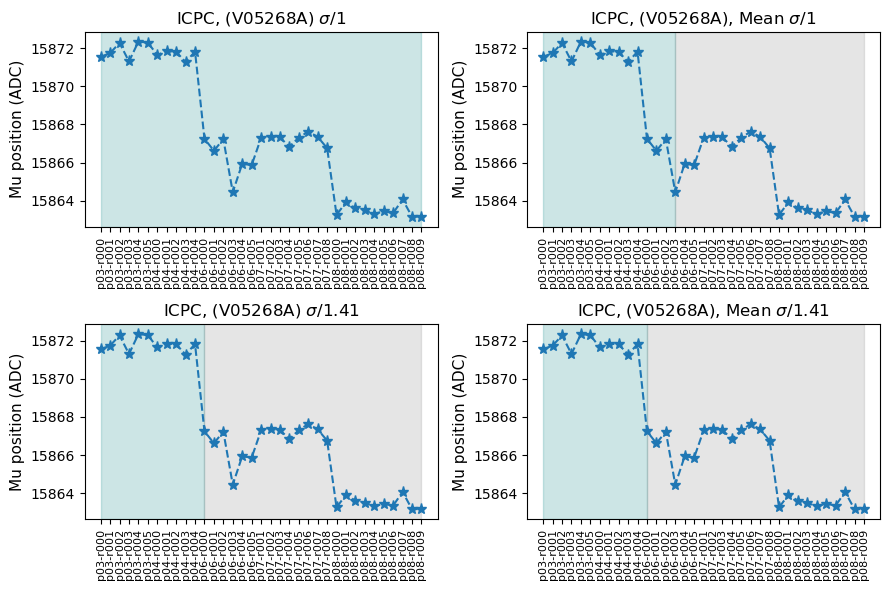

-------------------------------------------------------------------------------------------


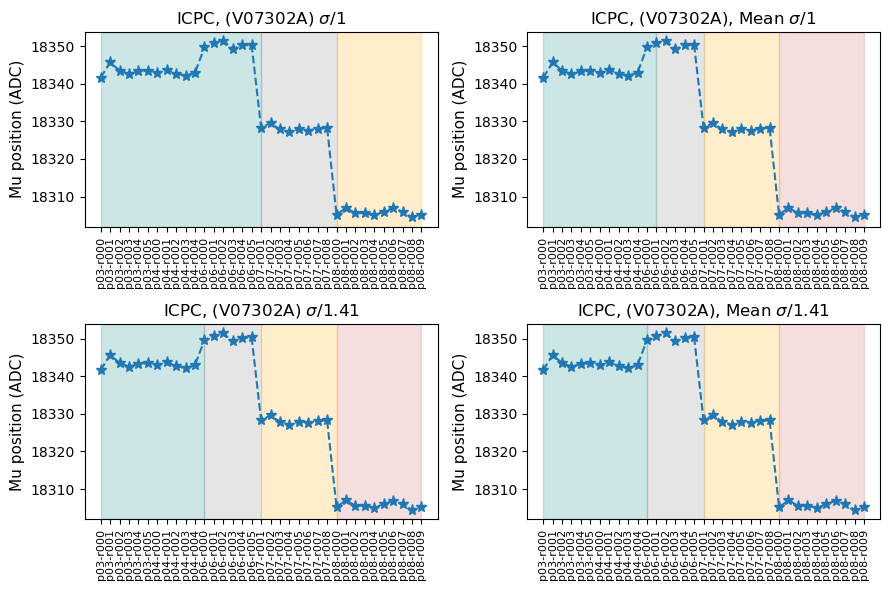

-------------------------------------------------------------------------------------------


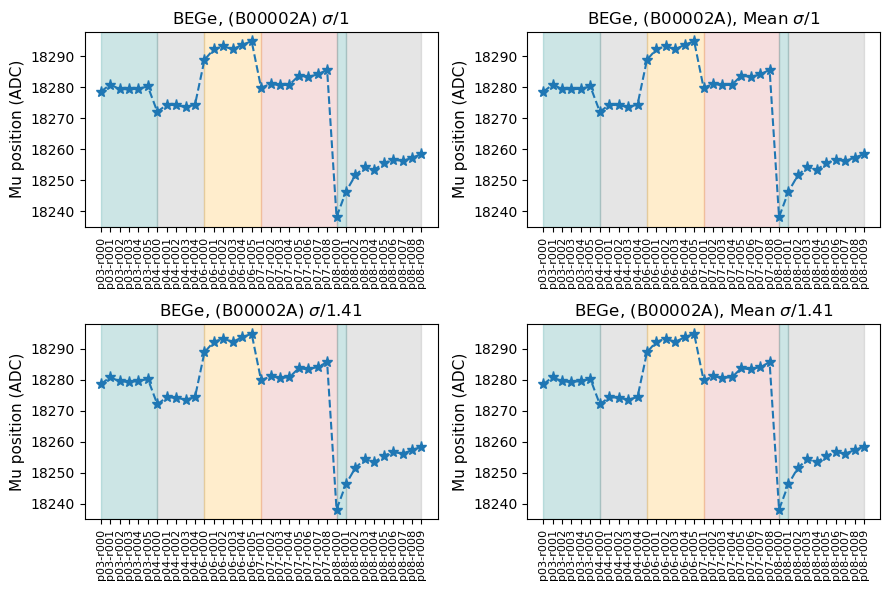

-------------------------------------------------------------------------------------------


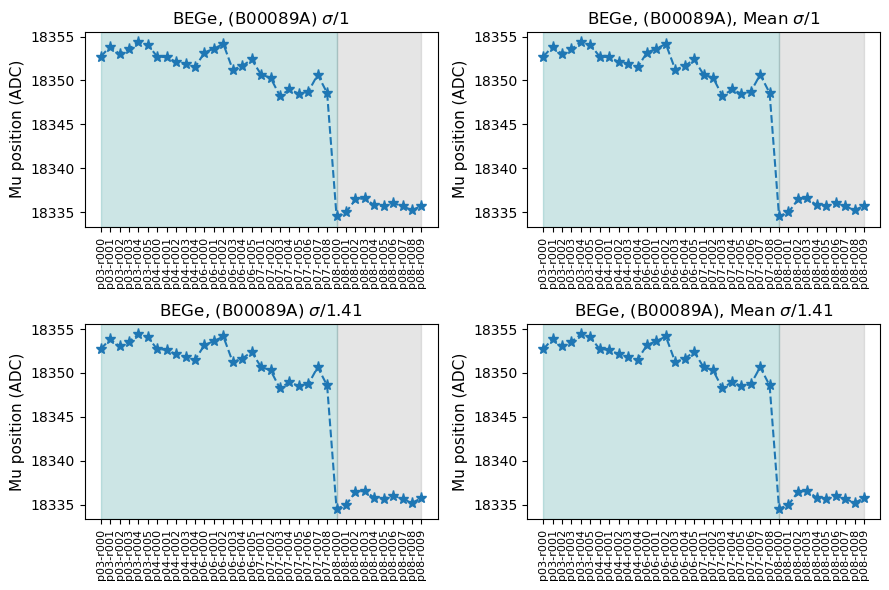

-------------------------------------------------------------------------------------------


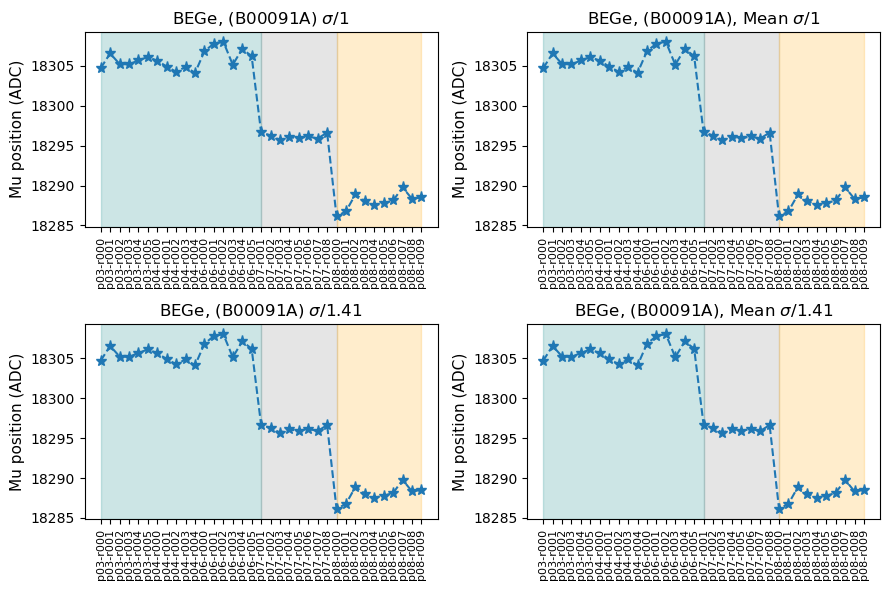

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


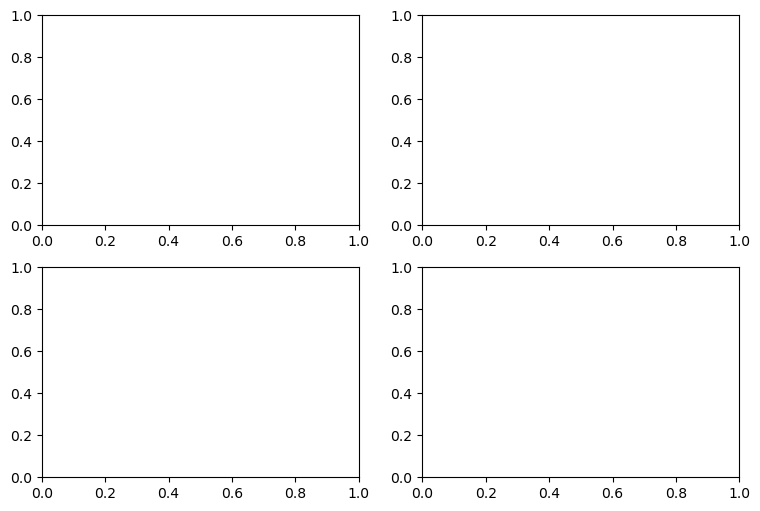

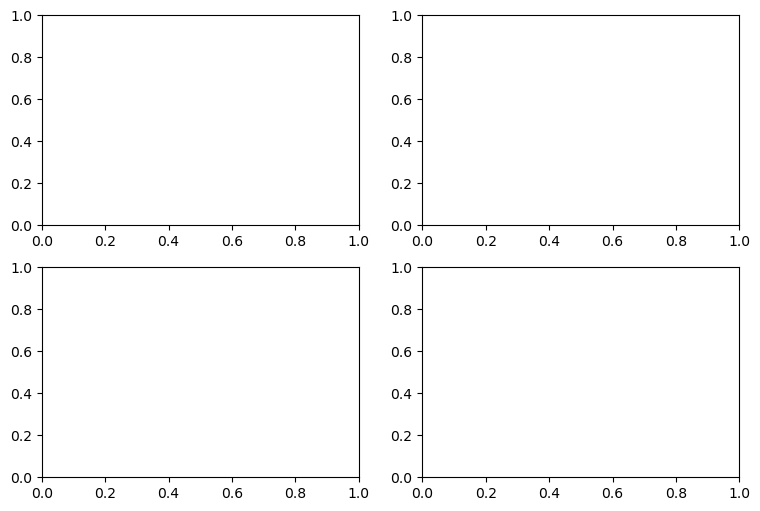

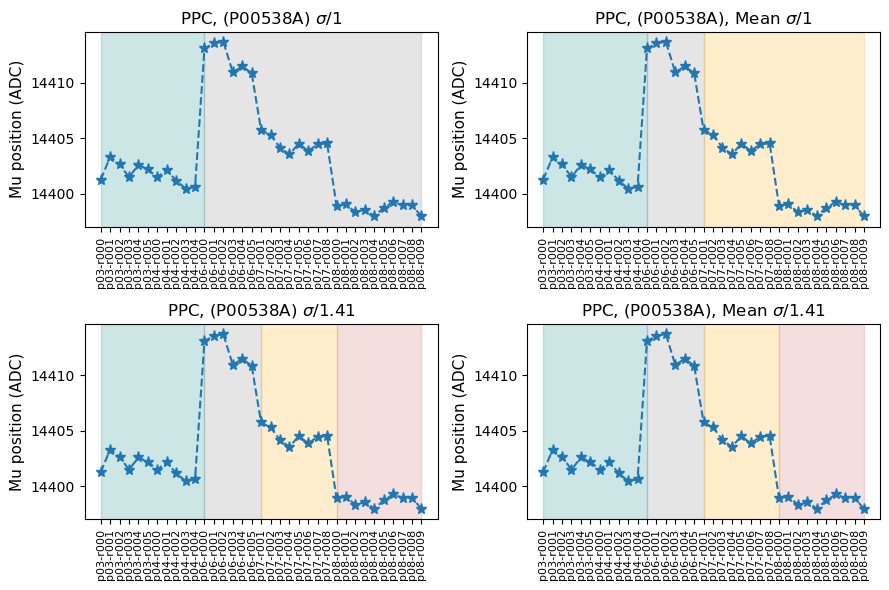

-------------------------------------------------------------------------------------------


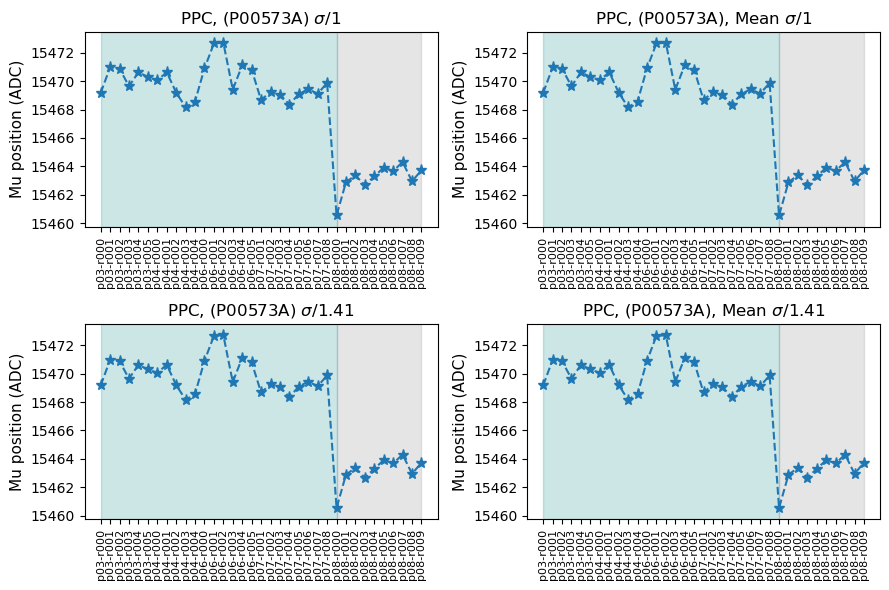

-------------------------------------------------------------------------------------------


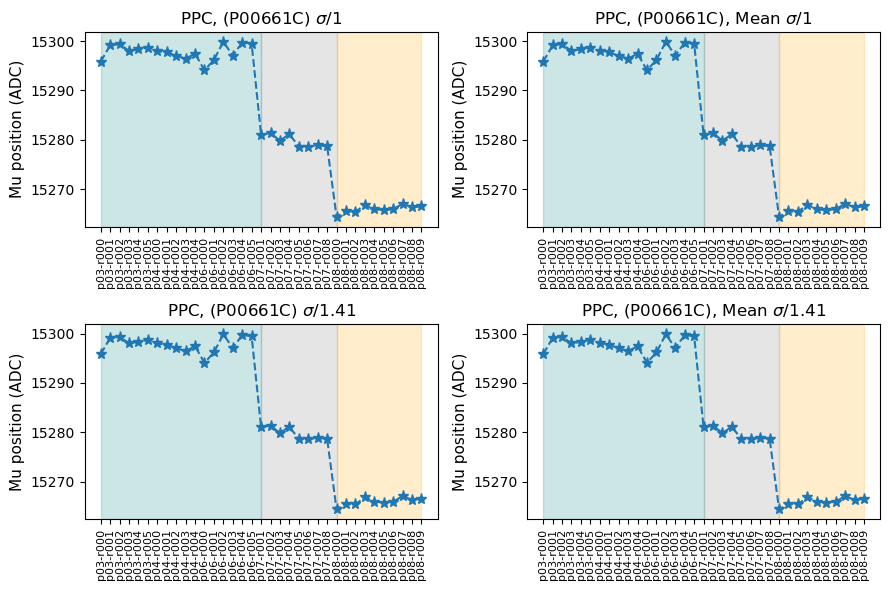

-------------------------------------------------------------------------------------------


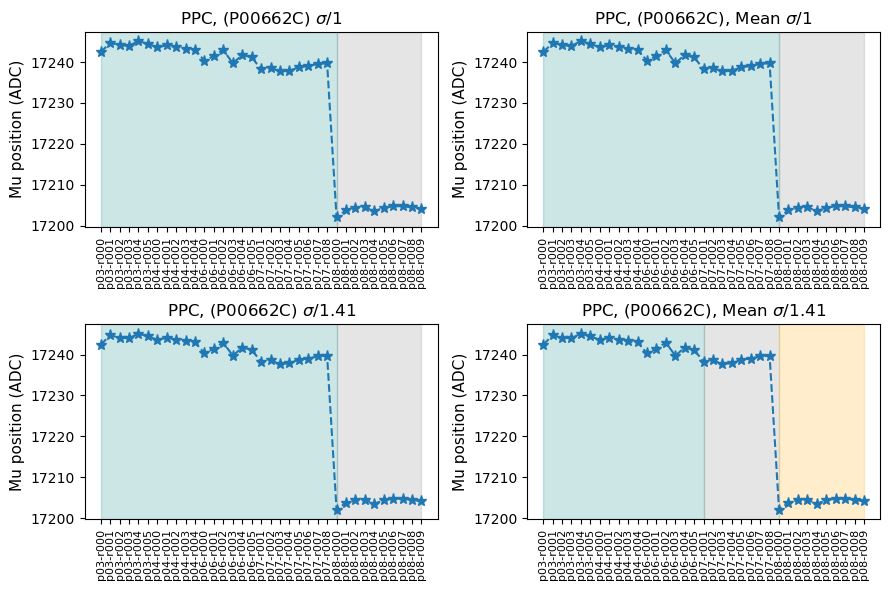

-------------------------------------------------------------------------------------------


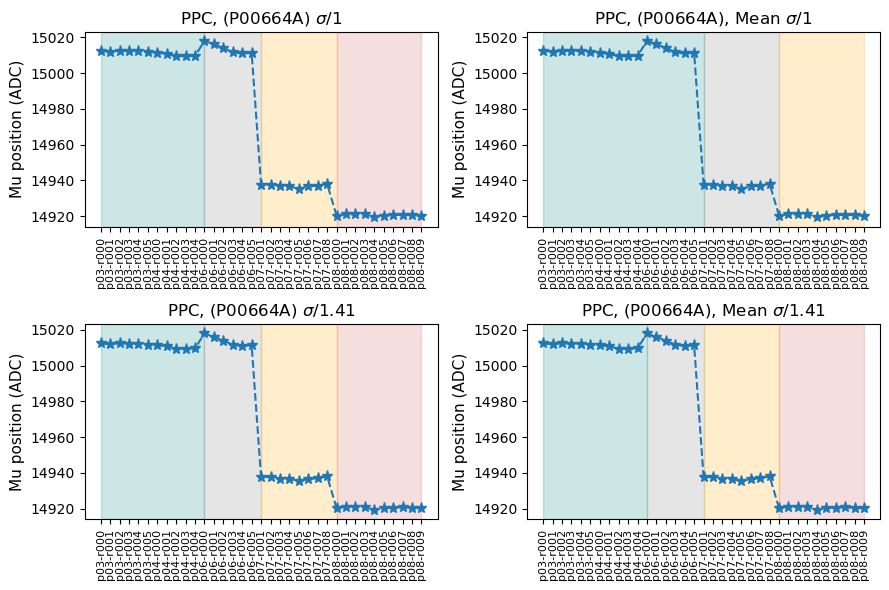

-------------------------------------------------------------------------------------------


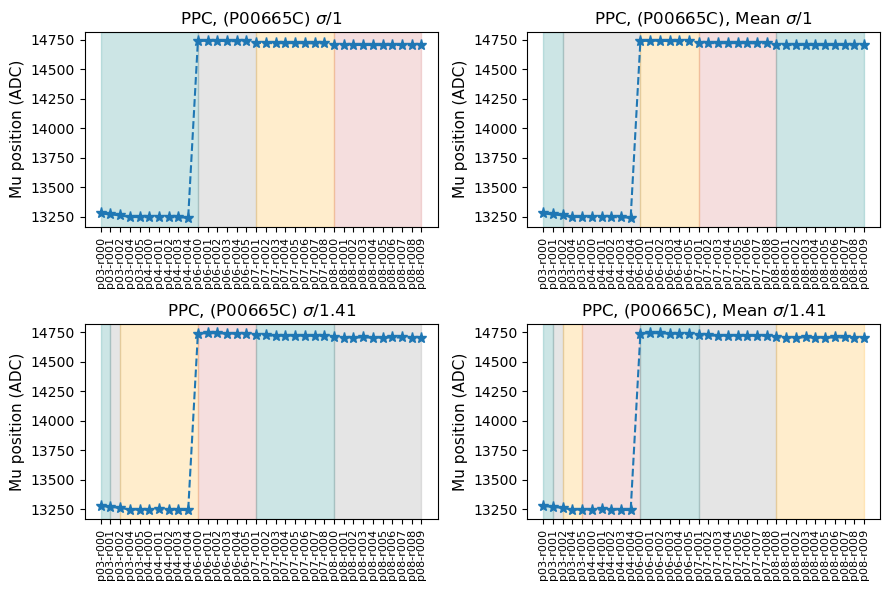

-------------------------------------------------------------------------------------------


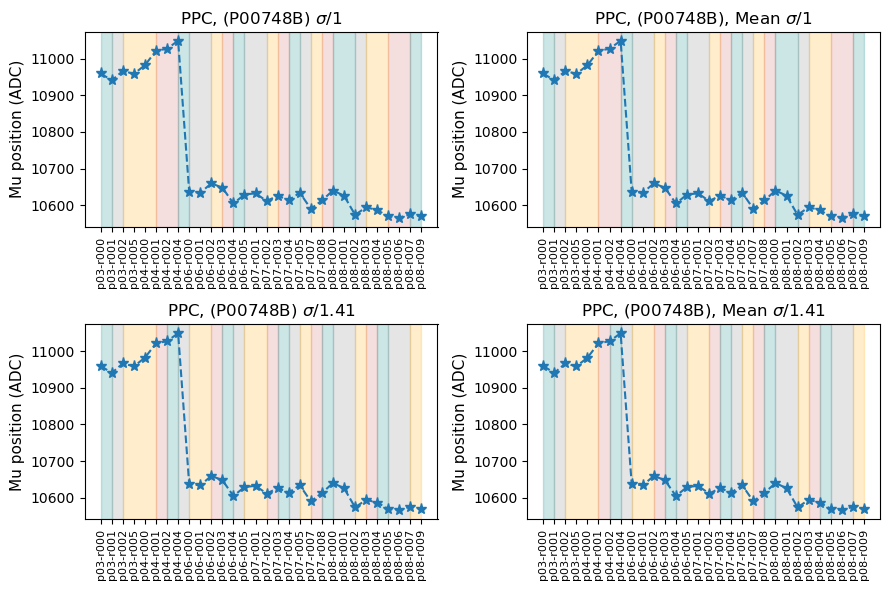

-------------------------------------------------------------------------------------------


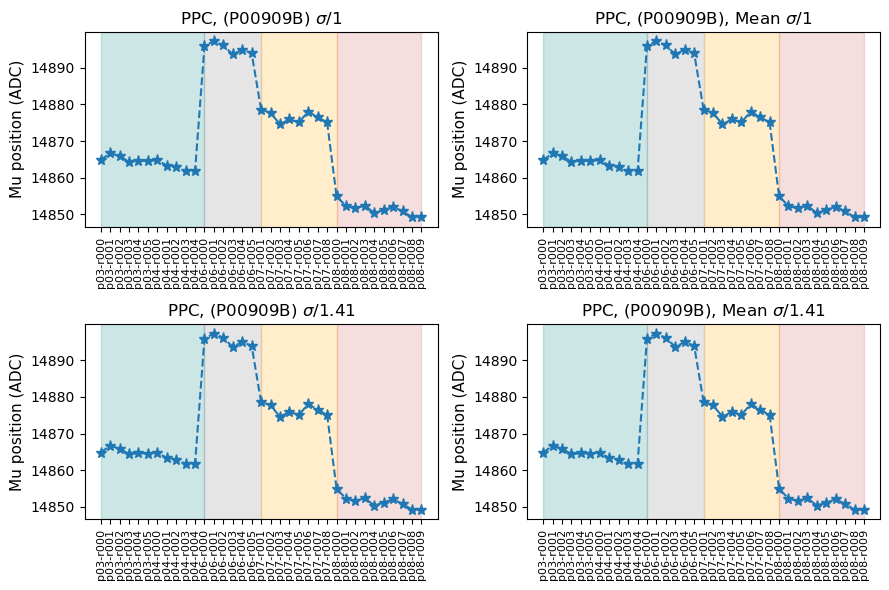

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


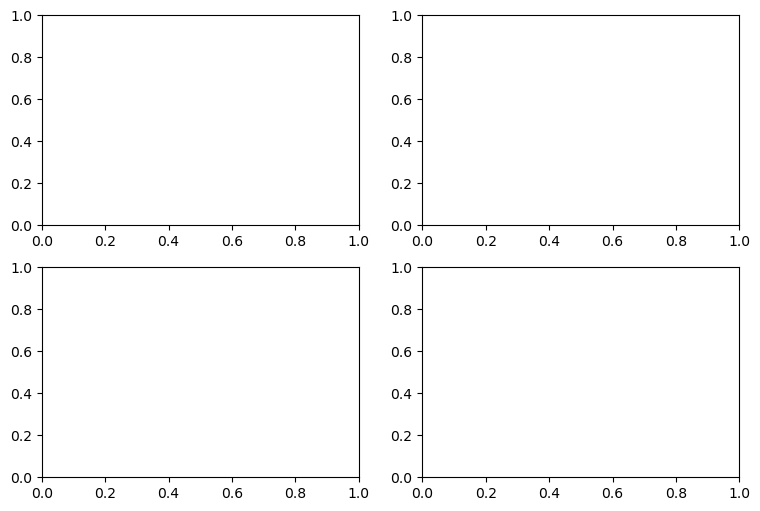

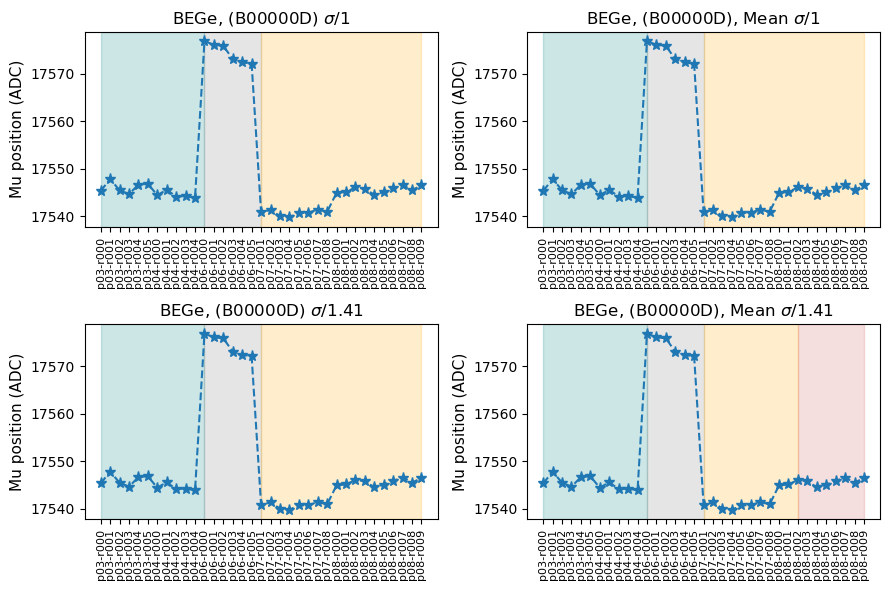

-------------------------------------------------------------------------------------------


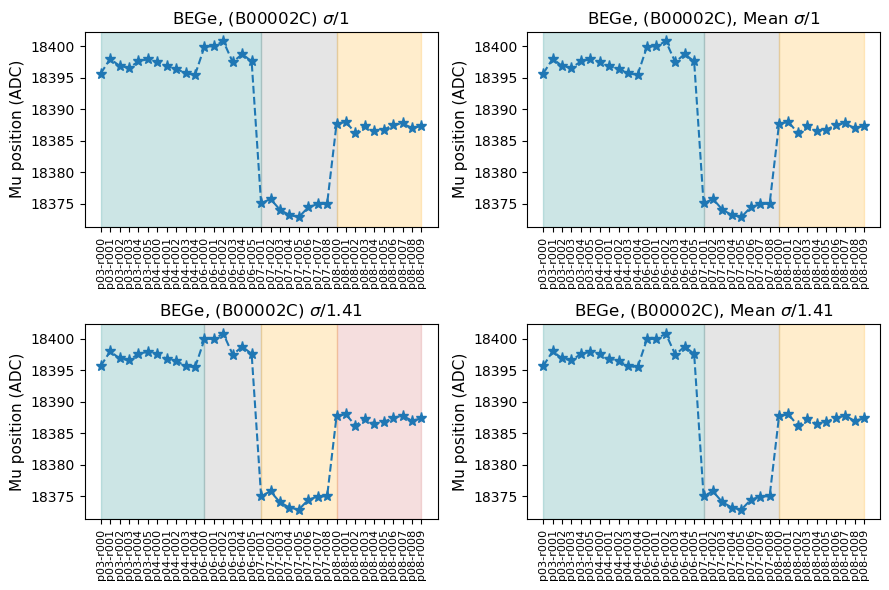

-------------------------------------------------------------------------------------------


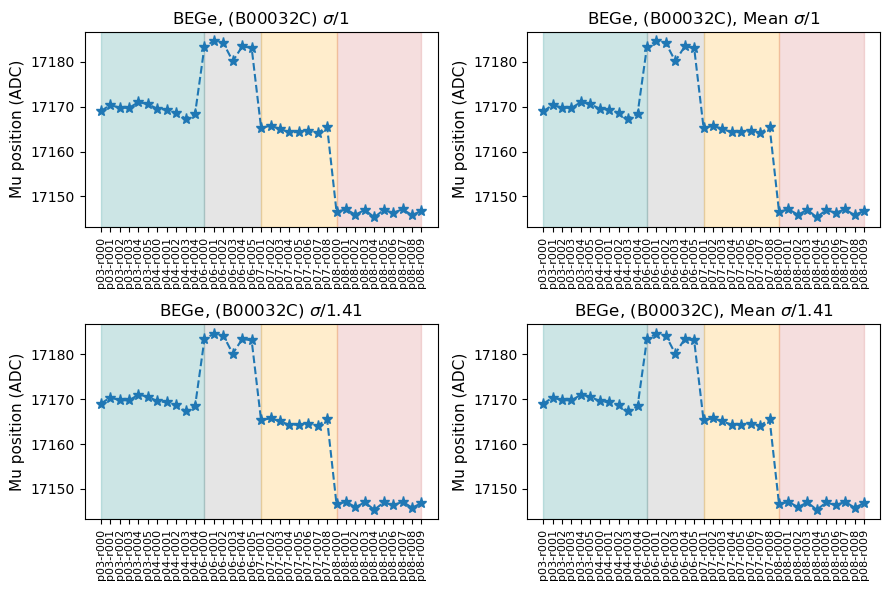

-------------------------------------------------------------------------------------------


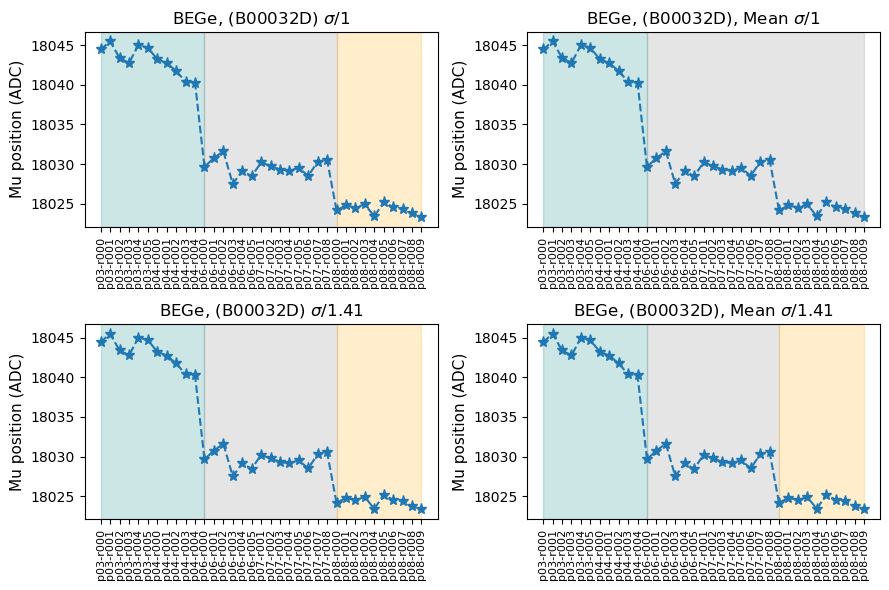

-------------------------------------------------------------------------------------------


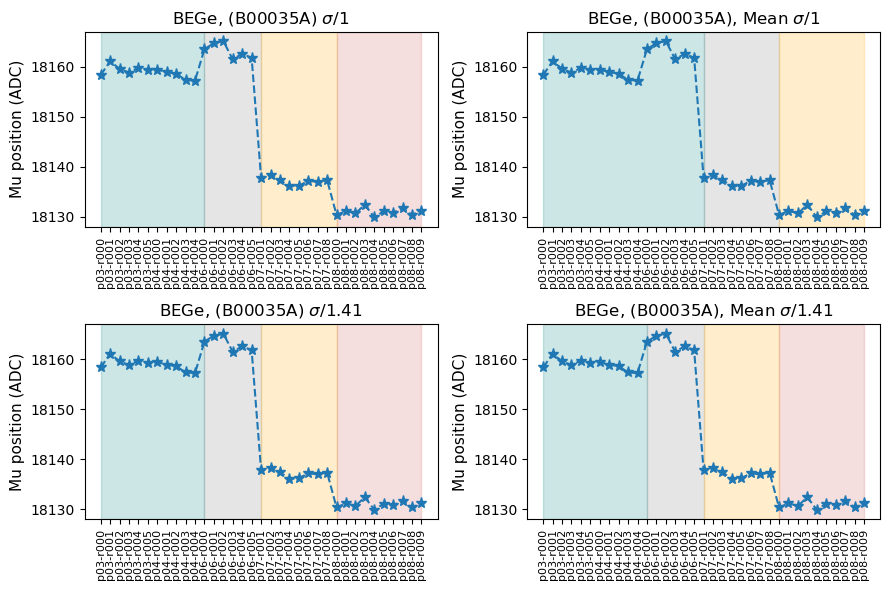

-------------------------------------------------------------------------------------------


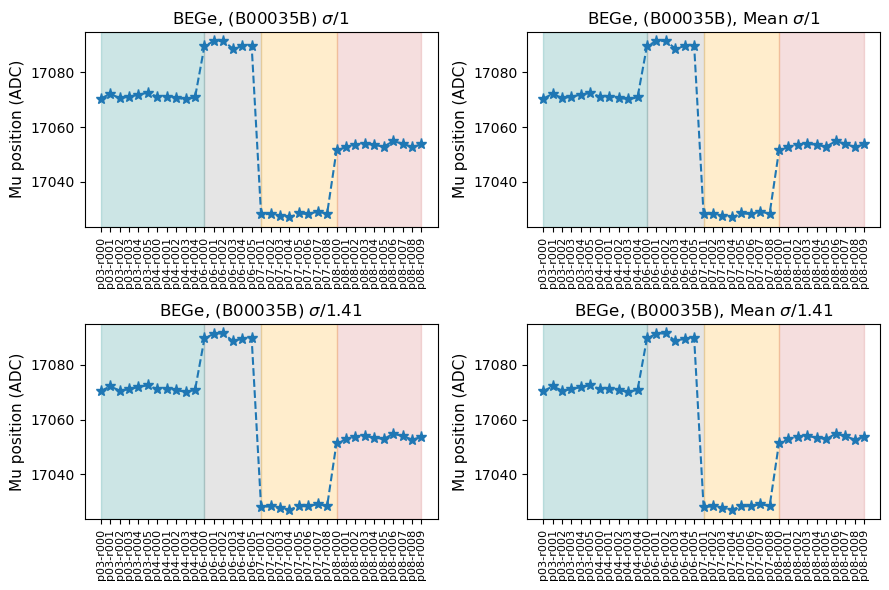

-------------------------------------------------------------------------------------------


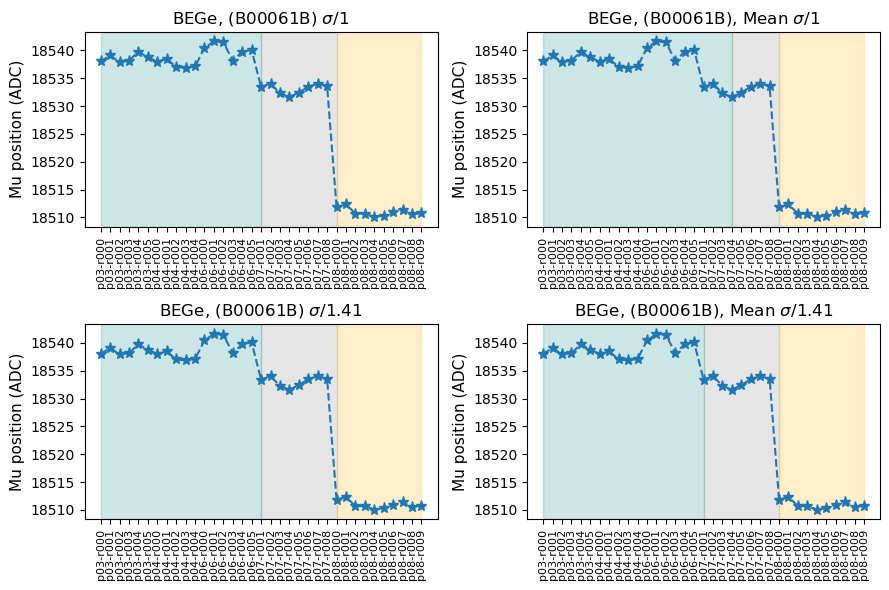

-------------------------------------------------------------------------------------------


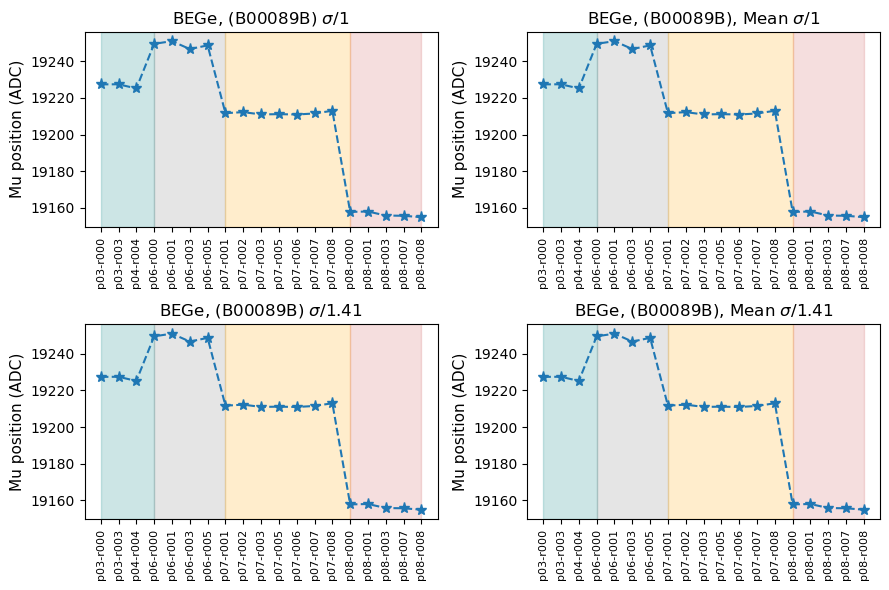

-------------------------------------------------------------------------------------------


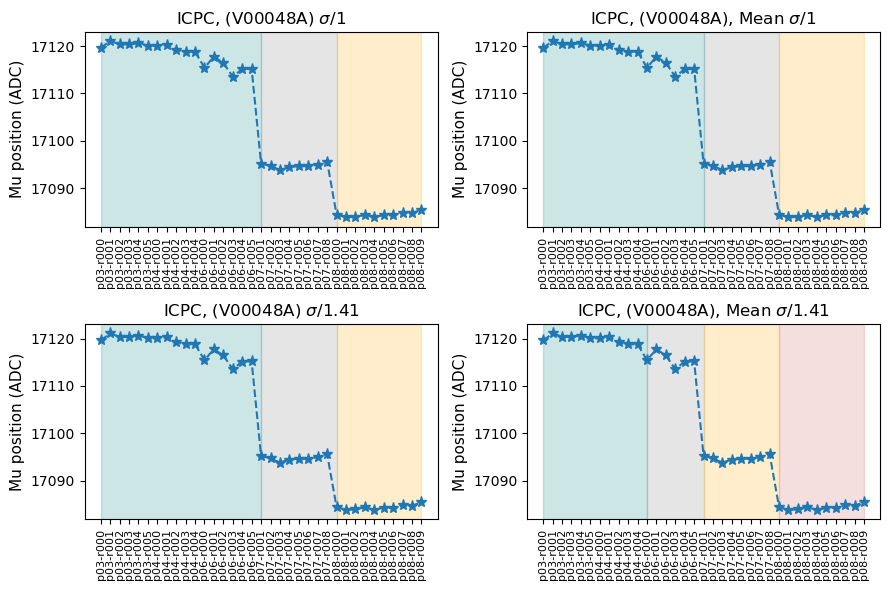

-------------------------------------------------------------------------------------------


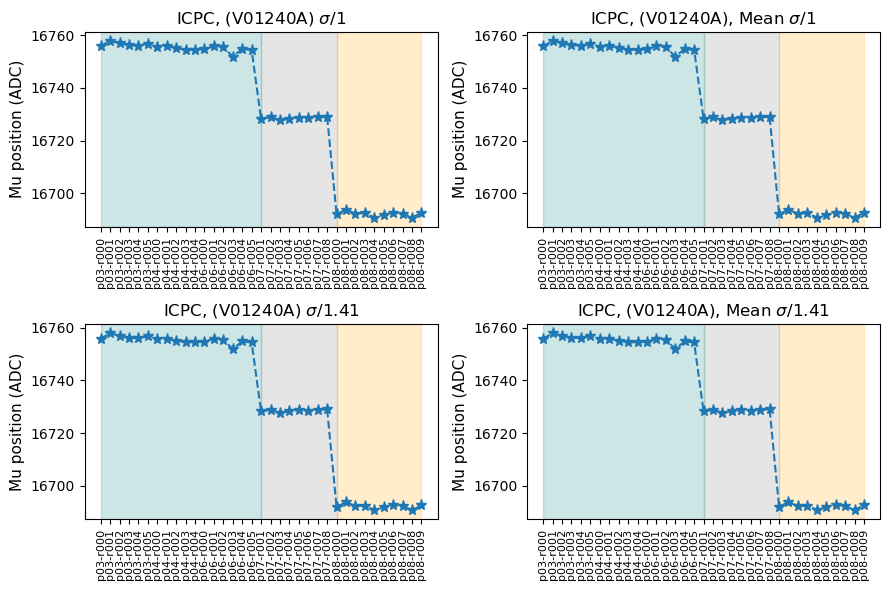

-------------------------------------------------------------------------------------------


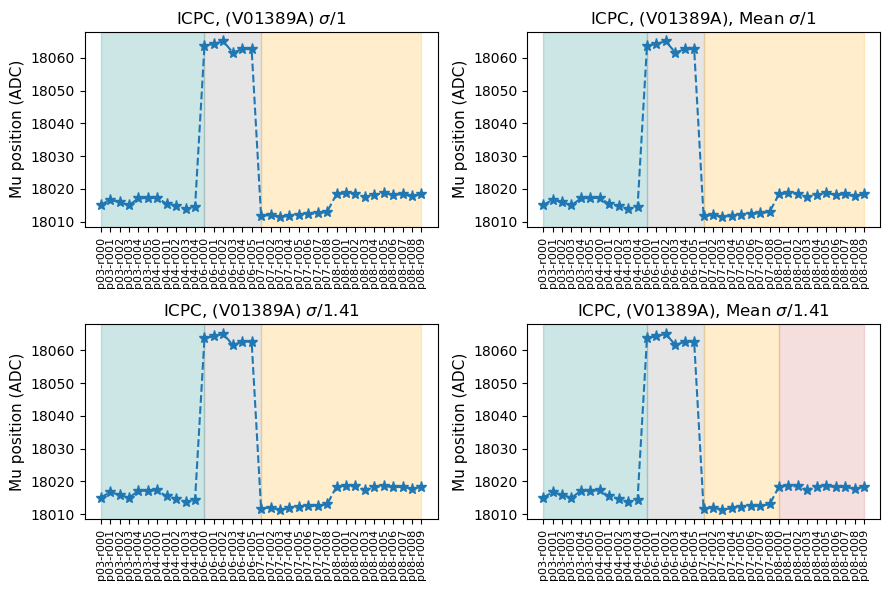

-------------------------------------------------------------------------------------------


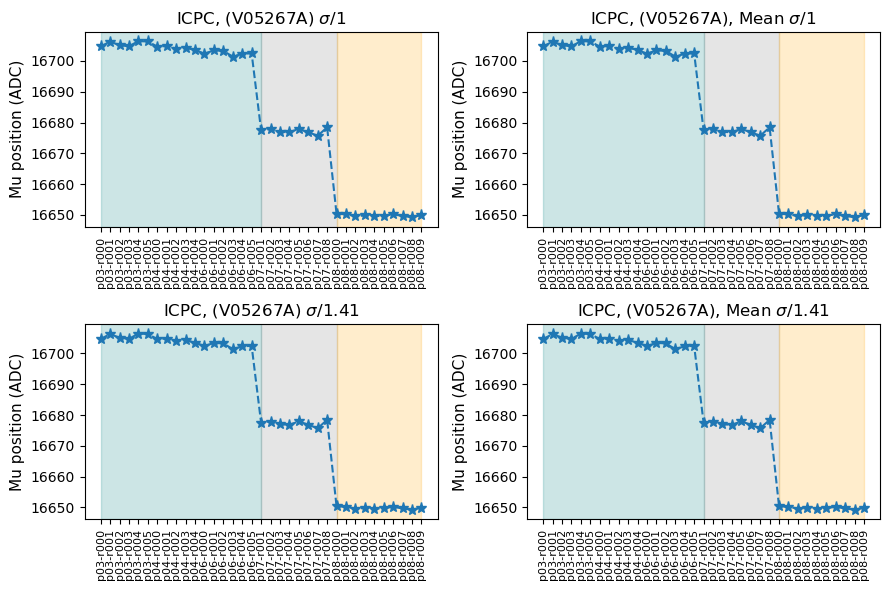

-------------------------------------------------------------------------------------------


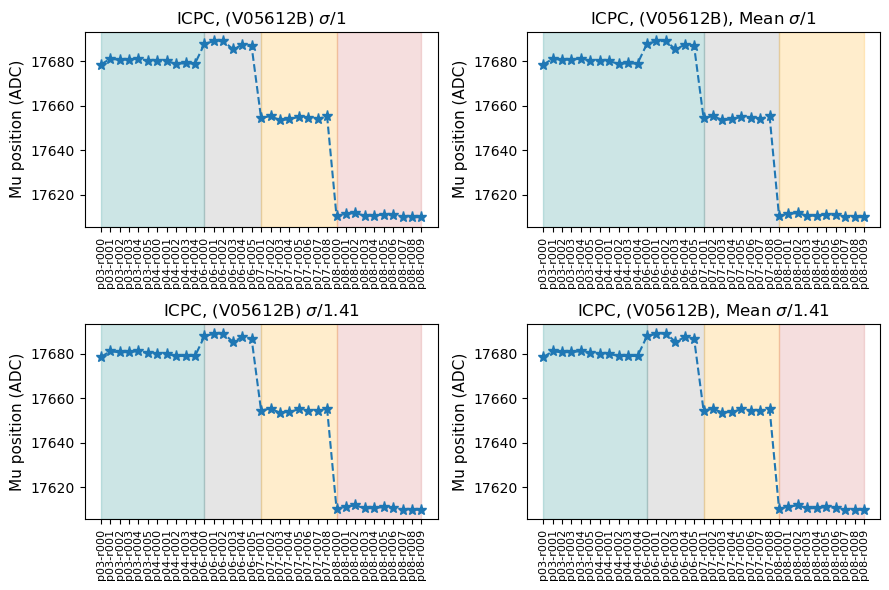

-------------------------------------------------------------------------------------------


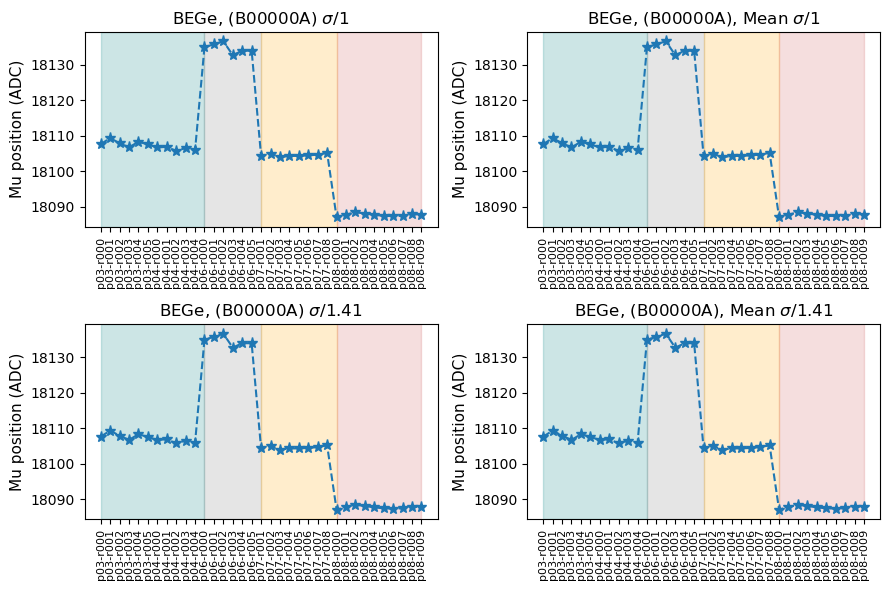

-------------------------------------------------------------------------------------------


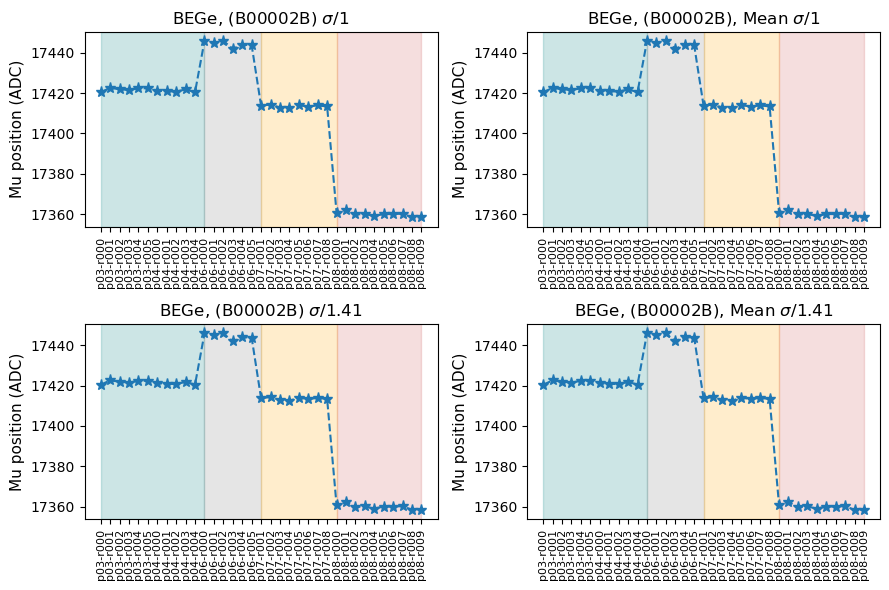

-------------------------------------------------------------------------------------------


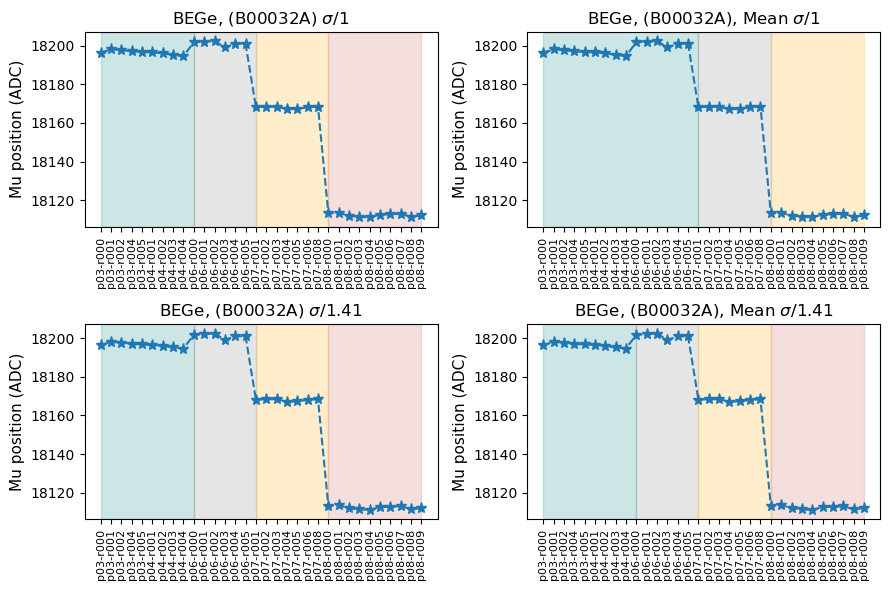

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


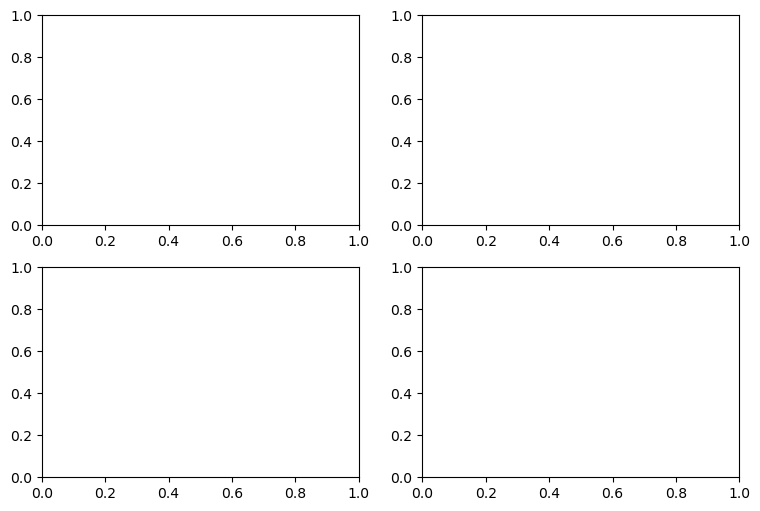

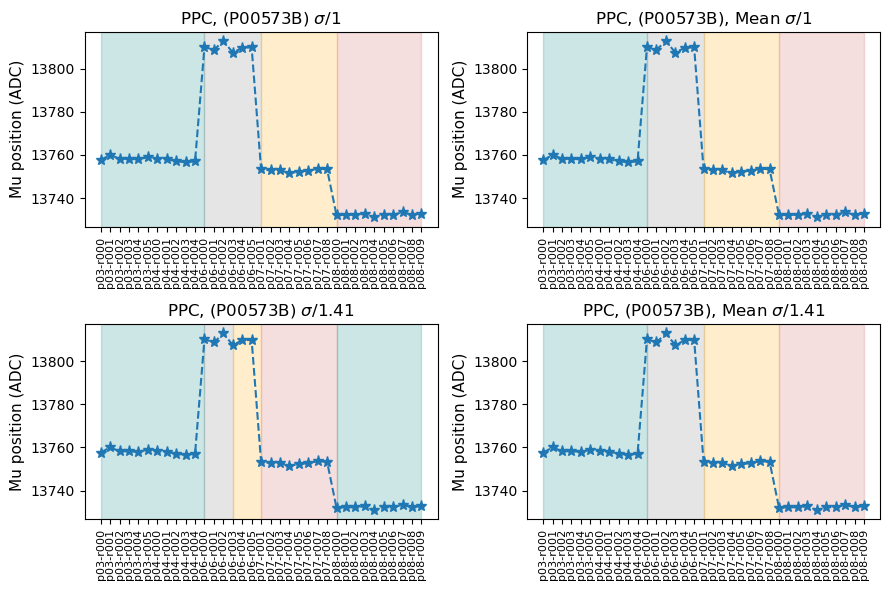

-------------------------------------------------------------------------------------------


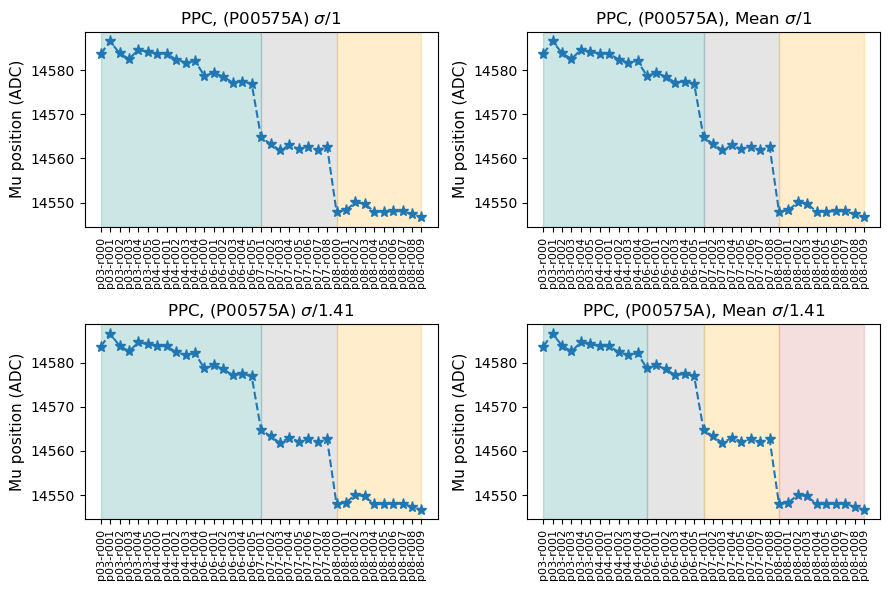

-------------------------------------------------------------------------------------------


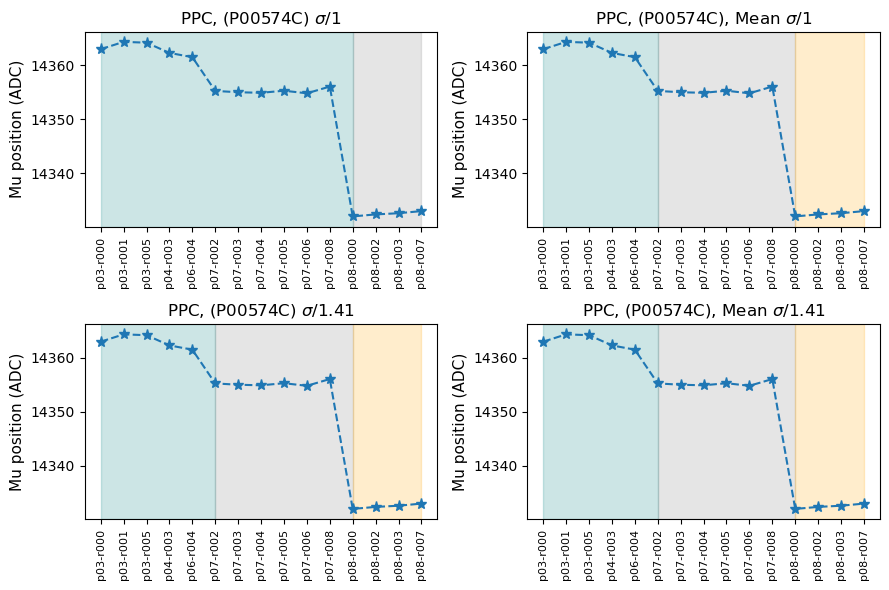

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


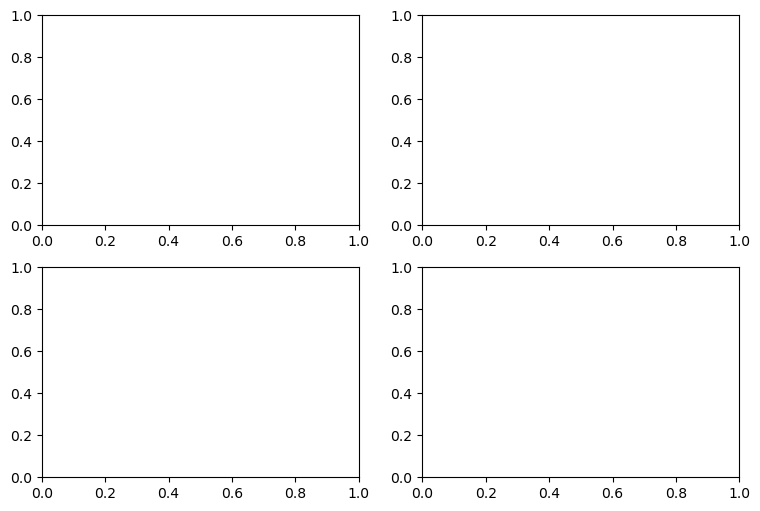

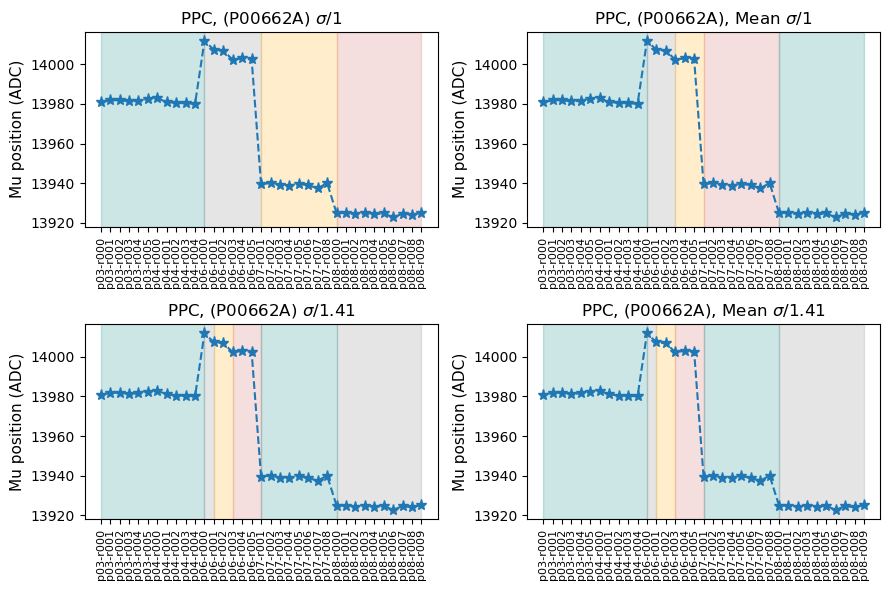

-------------------------------------------------------------------------------------------


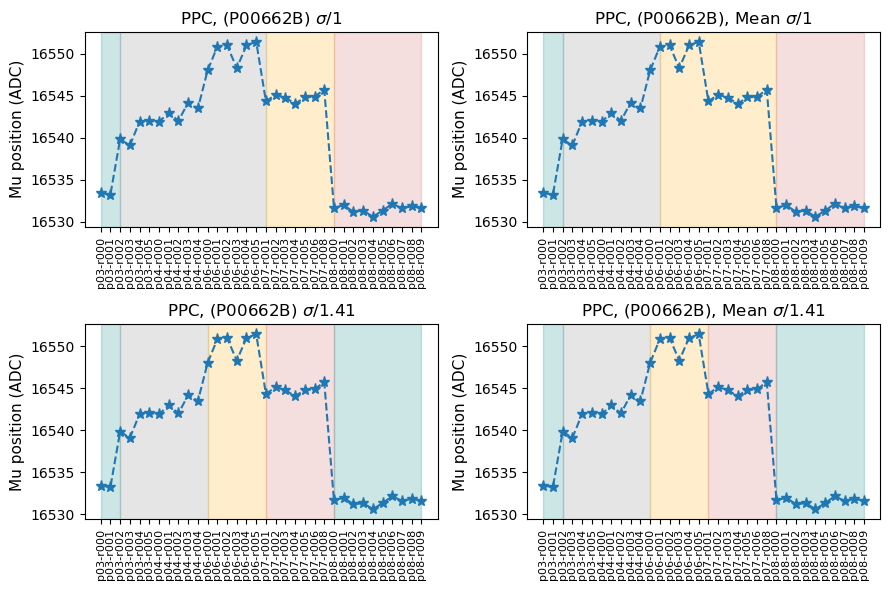

-------------------------------------------------------------------------------------------
-------------------------------------------------------------------------------------------


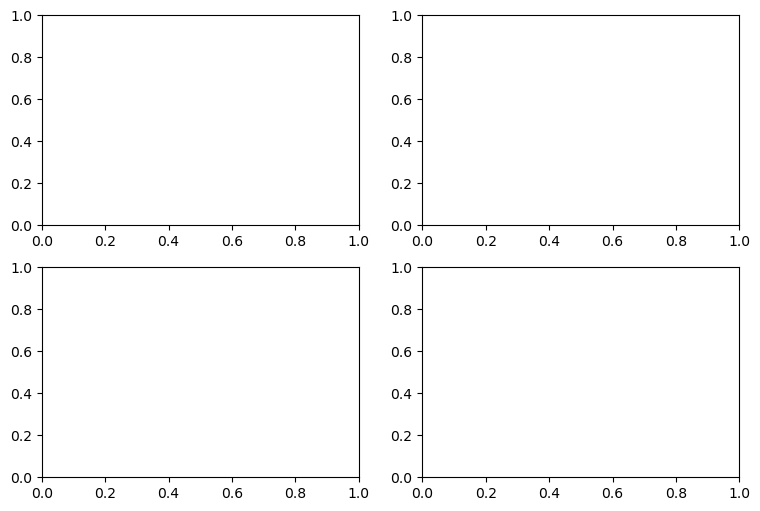

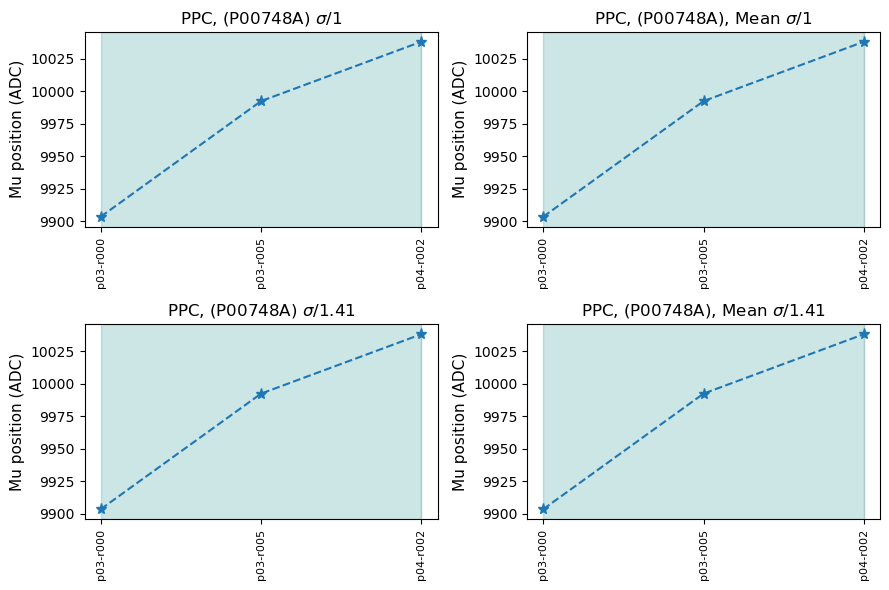

-------------------------------------------------------------------------------------------


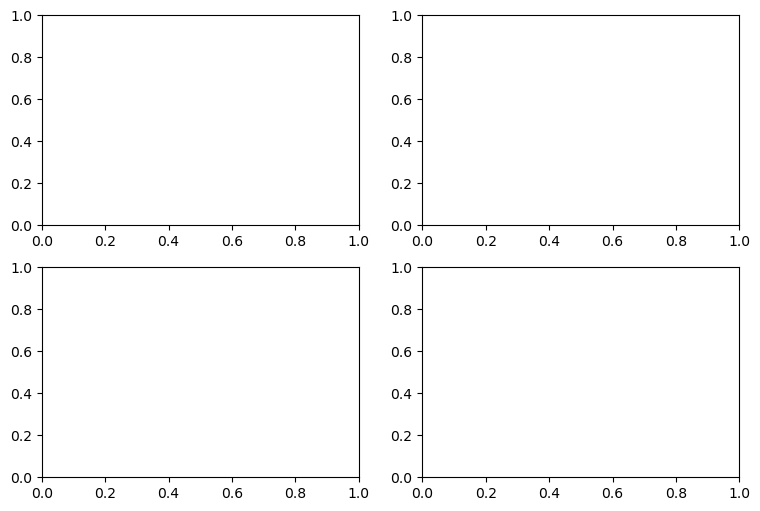

In [26]:
for i,channel in enumerate(all_params_ch.keys()):
    print('-------------------------------------------------------------------------------------------')
    try:
        fig, (axs0, axs1)  = plt.subplots(2, 2, figsize=(9, 6))
        det_name = pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid)
        det_type = pf.get_det_type(det_name)
        for axs, div_sigma_by in zip([axs0, axs1], [1, np.sqrt(2)]):
            for ax, mean_part, title in zip(axs, [False, True], ['', ', Mean']):
                ax.errorbar(list(all_params_ch[channel]['mus_peaks'][peak].keys()), 
                            list(all_params_ch[channel]['mus_peaks'][peak].values()),
                            yerr=list(all_params_ch[channel]['mus_err_peaks'][peak].values()), 
                            marker='*', linestyle='--', markersize=8, label=det_type)
                
                ax.tick_params(axis='x', labelsize=8, rotation=90)
                ax.tick_params(axis='y', labelsize=10)
                ax.set_ylabel('Mu position (ADC)', fontsize=11)
                partition_change = pf.compute_partitions_poly(all_params_ch, channel, peak, mean_part=mean_part, divide_sigma_by=div_sigma_by)
                for i,col in zip(range(len(partition_change)-1), cycle(color_list)):
                    ax.axvspan(list(all_params_ch[channel]['mus_peaks'][peak].keys())[partition_change[i]], 
                               list(all_params_ch[channel]['mus_peaks'][peak].keys())[partition_change[i+1]], alpha=0.2, color=col)
        
                ax.set_title(f'{det_type}, ({det_name}){title} $\sigma$/{np.round(div_sigma_by, decimals=2)}', fontsize=12)
        
        plt.tight_layout()
        plt.show()
    except KeyError:
        continue

In [27]:
good_icpcs = []
good_beges = []
good_coaxs = []
good_ppcs  = []
for channel in good_chs:
    det_name = pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid)
    if det_name.startswith('V'):
        good_icpcs.append(channel)
    elif det_name.startswith('B'):
        good_beges.append(channel)
    elif det_name.startswith('C'):
        good_coaxs.append(channel)
    elif det_name.startswith('P'):
        good_ppcs .append(channel)

In [28]:
len(good_icpcs), len(good_beges), len(good_coaxs), len(good_ppcs)

(37, 26, 6, 20)

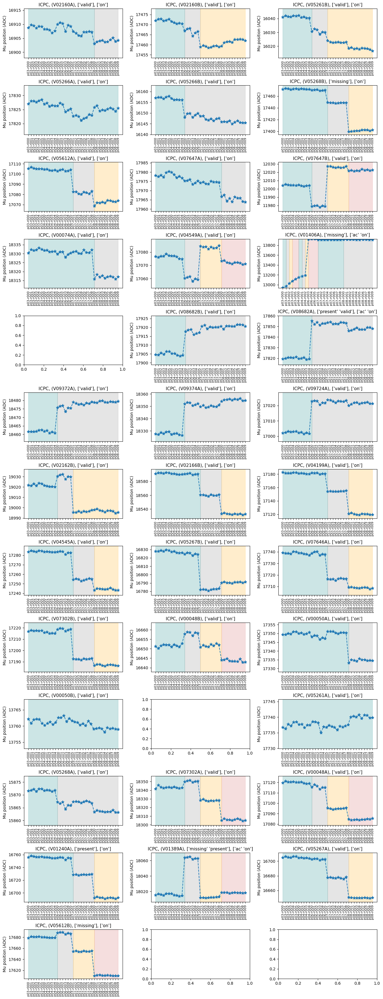

In [29]:
pf.plot_mus_and_partitions(all_params_ch, psd_status, usability, good_icpcs, all_fitted_peaks[6], ge_all, ge_rawid,
                           ncol=3, figsize=(13.5, 35), mean_part=True, divide_sigma_by=np.sqrt(2))

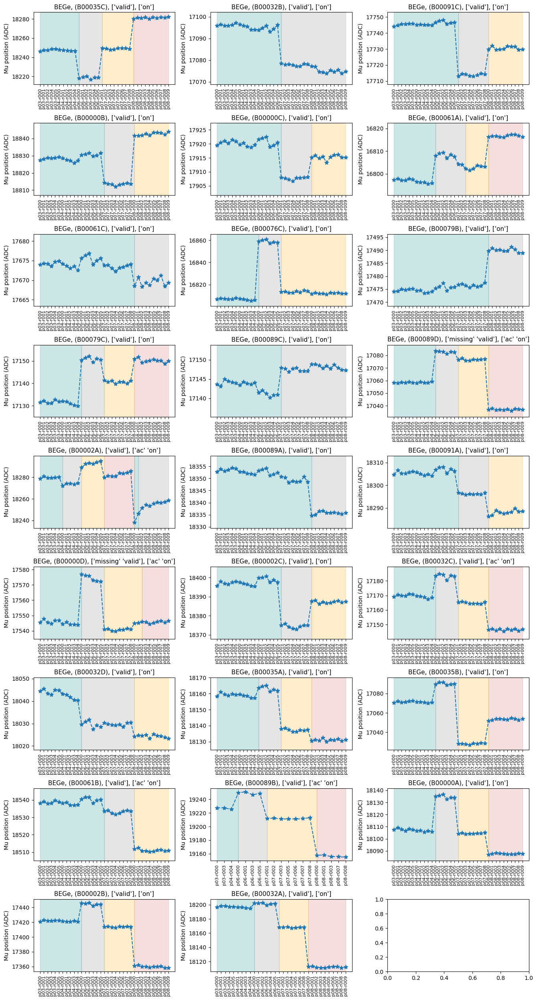

In [30]:
pf.plot_mus_and_partitions(all_params_ch, psd_status, usability, good_beges, all_fitted_peaks[6], ge_all, ge_rawid,
                           ncol=3, figsize=(13.5, 25), mean_part=True, divide_sigma_by=np.sqrt(2))

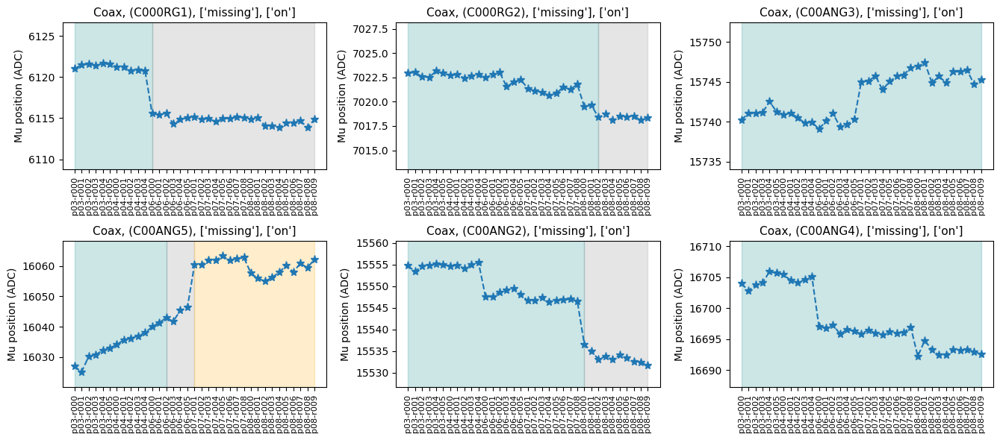

In [31]:
pf.plot_mus_and_partitions(all_params_ch, psd_status, usability, good_coaxs, all_fitted_peaks[6], ge_all, ge_rawid,
                           ncol=3, figsize=(13.5, 6), mean_part=True, divide_sigma_by=np.sqrt(2))

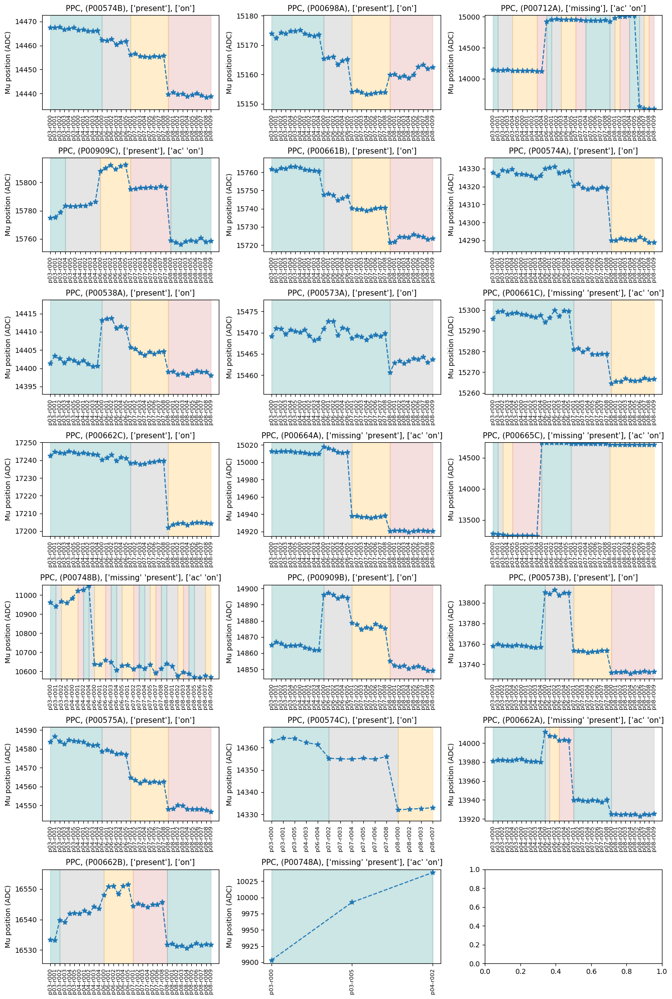

In [32]:
pf.plot_mus_and_partitions(all_params_ch, psd_status, usability, good_ppcs, all_fitted_peaks[6], ge_all, ge_rawid,
                           ncol=3, figsize=(13.5, 20), mean_part=True, divide_sigma_by=np.sqrt(2))

## Divide detectors in strings

### String 1

In [33]:
sel_string     = 1
det_sel_string = []
for channel in all_params_ch.keys():
    ch_string = channel_dict[int(channel[2:])][3]
    if ch_string==sel_string:
        det_sel_string.append(channel)

In [34]:
det_sel_string

['ch1104000',
 'ch1104001',
 'ch1104002',
 'ch1104003',
 'ch1104004',
 'ch1104005',
 'ch1105600',
 'ch1105602',
 'ch1105603']

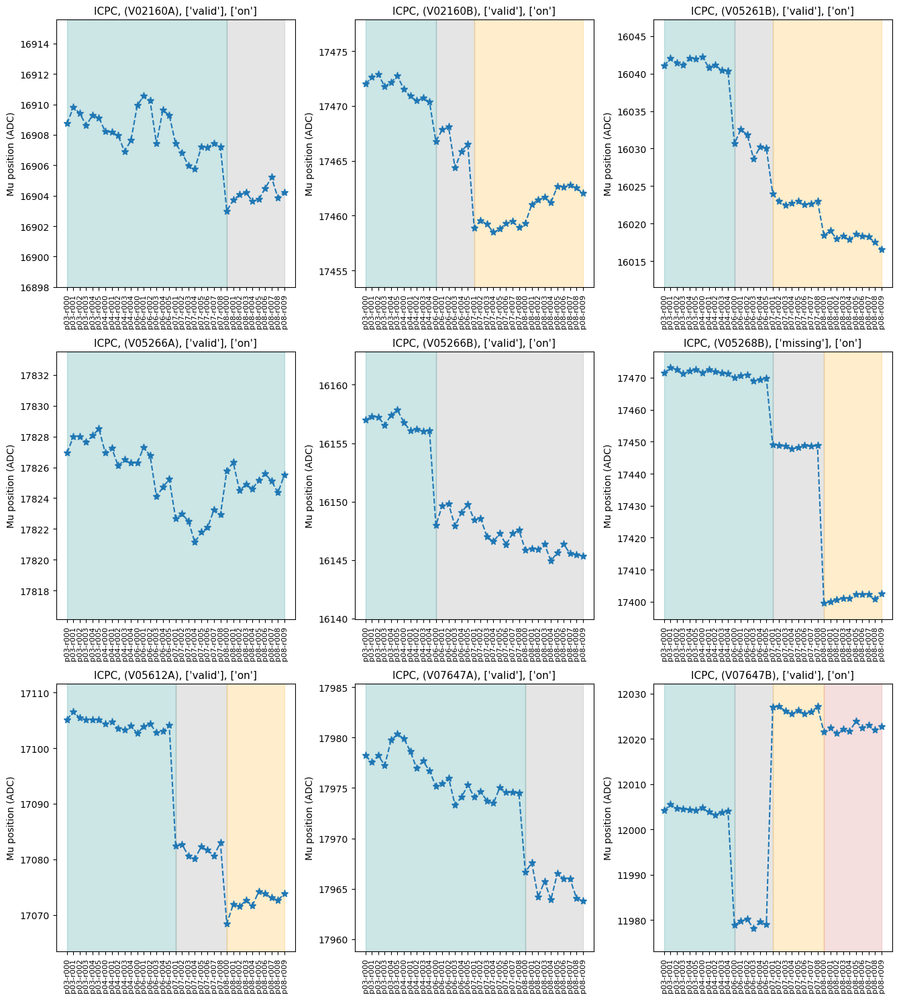

In [35]:
pf.plot_mus_and_partitions(all_params_ch, psd_status, usability, det_sel_string, all_fitted_peaks[6], ge_all, ge_rawid,
                           ncol=3, figsize=(13.5, 15), mean_part=True, divide_sigma_by=np.sqrt(2))

In [36]:
all_mu_std  = []
all_mu_mean = []
for channel in all_params_ch.keys():
    try:
        all_mu_mean.append(np.mean(list(all_params_ch[channel]['mus_peaks'][peak].values())))
        all_mu_std .append(np.std (list(all_params_ch[channel]['mus_peaks'][peak].values())))
    except:
        continue

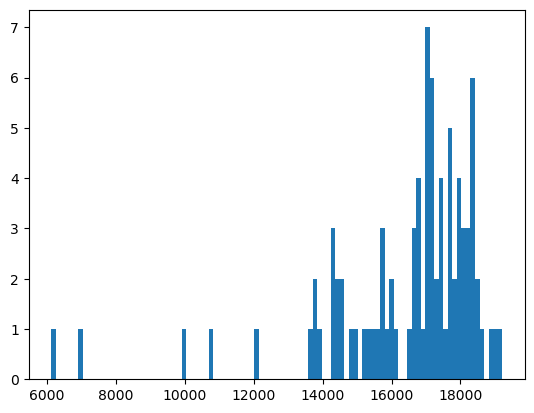

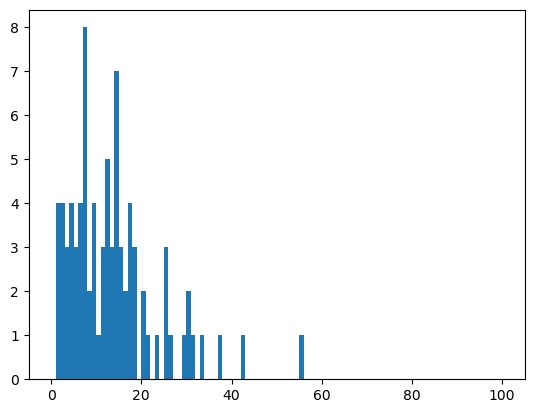

In [37]:
plt.hist(all_mu_mean, bins=100)
plt.show()

plt.hist(all_mu_std, bins=100, range=(0, 100))
plt.show()

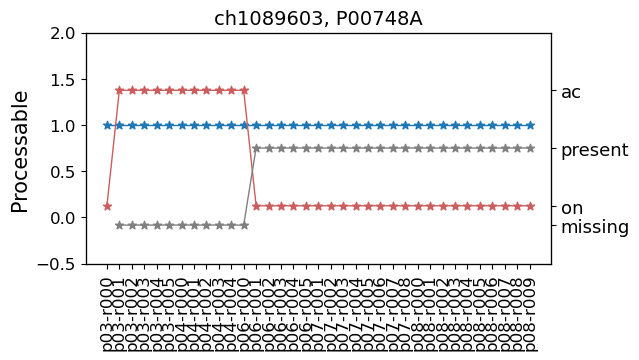

In [38]:
for sel_channel in processable.keys():
    proc_vals   = np.array(list(processable[sel_channel].values()))
    runs_keys   = np.array(list(processable[sel_channel].keys()))
    usab_vals   = np.array(list(usability  [sel_channel].values()))
    psds_vals   = np.array(list(psd_status [sel_channel].values()))
    psds_keys   = np.array(list(psd_status [sel_channel].keys()))
    
    if pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)=='P00748A':
    
        fig, ax = plt.subplots(1, 1, figsize=(6, 3))
        ax.scatter(runs_keys, proc_vals, marker='*')
        ax.plot(runs_keys, proc_vals, linestyle='-', linewidth=1)
        
        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax2.scatter(runs_keys, usab_vals, marker='*', color='indianred')
        ax2.plot(runs_keys, usab_vals, linestyle='-', linewidth=1, color='indianred')
        ax3.scatter(psds_keys, psds_vals, marker='*', color='grey')
        ax3.plot(psds_keys, psds_vals, color='grey', linestyle='-', linewidth=1)
        for iax,ylim in zip([ax, ax2, ax3], [(-0.5, 2), (-0.5, 1.5), (-0.5, 2.5)]):
            iax.set_ylim(ylim)
        for iax in [ax2, ax3]:
            iax.tick_params(axis='y', labelsize=13)
        ax.tick_params(axis='x', labelsize=12, rotation=90)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_title(f'{sel_channel}, {pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)}', fontsize=14)
        ax.set_ylabel('Processable', fontsize=15)
        plt.show()

In [39]:
sel_channel = 'ch1121603'
mus_fep_sel_ch      = []
mus_fep_err_sel_ch  = []
mus_fep_sel_ch_runs = []
for i, period in enumerate(run_dict.keys()):
    for j, run in enumerate(run_dict[period].keys()):
        all_files  = os.listdir(data_path)
        filename   = data_path + [f for f in all_files if f.startswith(f'l200-{period}-{run}')][0]
        dt_result  = pf.get_timestamp_from_filename(filename)
        config     = lmeta.dataprod.config.on(dt_result)
        det_name   = pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)
        config_chn = config.analysis[det_name]

        if (config_chn['processable'] == True):# and (config_chn['usability'] == 'on'):

            with open (filename, 'r') as filehandler:
                try:
                    results   = json.load(filehandler)
                    res_chn   = results[sel_channel]['results']['ecal']

                    cal_parameters = results[sel_channel]['pars']['operations']['cuspEmax_ctc_cal']['parameters']
                    
                    eres_lin_pars  = res_chn['cuspEmax_ctc_cal']['eres_linear']                    
                    fitted_peaks   = res_chn['cuspEmax_ctc_cal']['fitted_peaks']
                    peak_fits_pars = res_chn['cuspEmax_ctc_cal']['pk_fits']
                    
                    peak = fitted_peaks[6]
                        
                    mu     = peak_fits_pars[f'{peak}']['parameters_in_ADC']   ['mu']
                    mu_err = peak_fits_pars[f'{peak}']['uncertainties_in_ADC']['mu']
                    mus_fep_sel_ch     .append(mu)
                    mus_fep_err_sel_ch .append(mu_err)
                    mus_fep_sel_ch_runs.append(f'{period}-{run}')

                except Exception as e:
                    mus_fep_sel_ch     .append(0)
                    mus_fep_err_sel_ch .append(0)
                    mus_fep_sel_ch_runs.append(f'{period}-{run}')
                    #print(e, sel_channel, period, run)
                    continue        

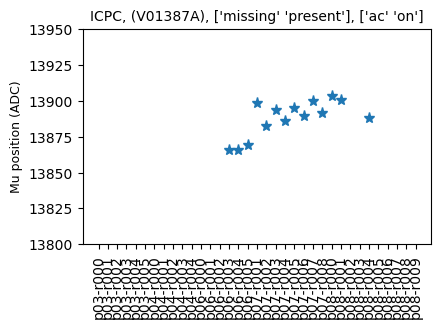

In [40]:
peak     = all_fitted_peaks[6]
channel  = 'ch1121603'
det_name = pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid)
det_type = pf.get_det_type(det_name)

plt.figure(figsize=(4.5, 2.8))
plt.errorbar(mus_fep_sel_ch_runs, mus_fep_sel_ch, yerr=mus_fep_err_sel_ch, marker='*', linestyle='',
            markersize=8, label=det_type)

plt.xticks(fontsize=10, rotation=90)
plt.yticks(fontsize=10)
plt.title(f'{det_type}, ({det_name}), {np.unique(list(psd_status[channel].values()))}, {np.unique(list(usability[channel].values()))}', fontsize=10)
plt.ylabel('Mu position (ADC)', fontsize=9)
plt.ylim(13800, 13950)
plt.show()

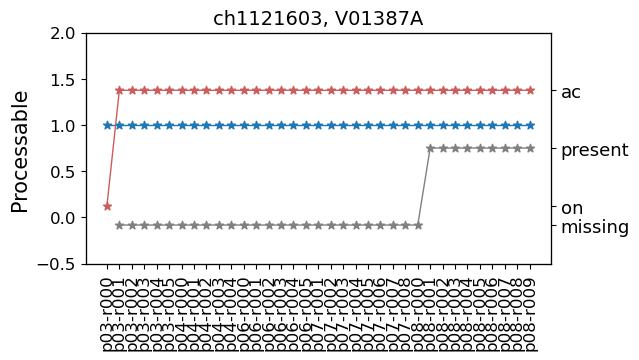

In [41]:
for sel_channel in processable.keys():
    proc_vals   = np.array(list(processable[sel_channel].values()))
    runs_keys   = np.array(list(processable[sel_channel].keys()))
    usab_vals   = np.array(list(usability  [sel_channel].values()))
    psds_vals   = np.array(list(psd_status [sel_channel].values()))
    psds_keys   = np.array(list(psd_status [sel_channel].keys()))
    
    if pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)=='V01387A':
    
        fig, ax = plt.subplots(1, 1, figsize=(6, 3))
        ax.scatter(runs_keys, proc_vals, marker='*')
        ax.plot(runs_keys, proc_vals, linestyle='-', linewidth=1)
        
        ax2 = ax.twinx()
        ax3 = ax.twinx()
        ax2.scatter(runs_keys, usab_vals, marker='*', color='indianred')
        ax2.plot(runs_keys, usab_vals, linestyle='-', linewidth=1, color='indianred')
        ax3.scatter(psds_keys, psds_vals, marker='*', color='grey')
        ax3.plot(psds_keys, psds_vals, color='grey', linestyle='-', linewidth=1)
        for iax,ylim in zip([ax, ax2, ax3], [(-0.5, 2), (-0.5, 1.5), (-0.5, 2.5)]):
            iax.set_ylim(ylim)
        for iax in [ax2, ax3]:
            iax.tick_params(axis='y', labelsize=13)
        ax.tick_params(axis='x', labelsize=12, rotation=90)
        ax.tick_params(axis='y', labelsize=12)
        ax.set_title(f'{sel_channel}, {pf.get_ch_name(int(sel_channel[2:]), ge_all, ge_rawid)}', fontsize=14)
        ax.set_ylabel('Processable', fontsize=15)
        plt.show()

## Get the partitions for all channels

In [42]:
all_partitions = []
time_partition = []
peak = all_fitted_peaks[6]
for channel in good_chs:
    try:
        partition_change = pf.compute_partitions_poly(all_params_ch, channel, peak, mean_part=True, divide_sigma_by=np.sqrt(2))
        all_partitions.append(partition_change)
        
        for part in partition_change:
            if part==0:
                continue
            #elif part == len(list(all_params_ch[channel]['mus_peaks'][peak].keys()))-1:
            #    continue
            else:
                time_partition.append(list(all_params_ch[channel]['mus_peaks'][peak].keys())[part])
    except Exception as e:
        print(e)
        continue

2614.5
2614.5


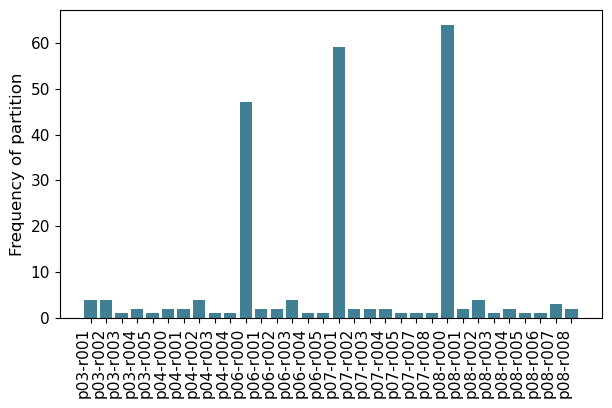

In [43]:
from collections import Counter

string_to_remove = 'p08-r009'
time_partition   = [item for item in time_partition if item != string_to_remove]

periods_runs = []
for entry in time_partition:
    period, run = entry.split('-')
    periods_runs.append((int(period[1:]), int(run[1:])))

sorted_periods = sorted(Counter(periods_runs).keys(), key=lambda x: (x[0], x[1]))

sorted_labels = ['p{:02d}-r{:03d}'.format(period, run) for period, run in sorted_periods]
counts        = [Counter(periods_runs)[period] for period in sorted_periods]

plt.figure(figsize=(7, 4))
plt.bar(range(len(sorted_labels)), counts, tick_label=sorted_labels, color='#418094')
plt.ylabel('Frequency of partition', fontsize=12)
plt.xticks(rotation=90, ha='right',  fontsize=11)
plt.yticks(                          fontsize=11)
#plt.yscale('log')
plt.show()

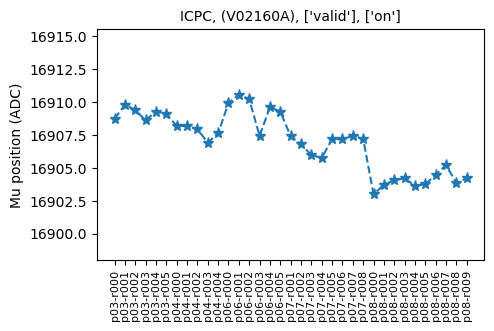

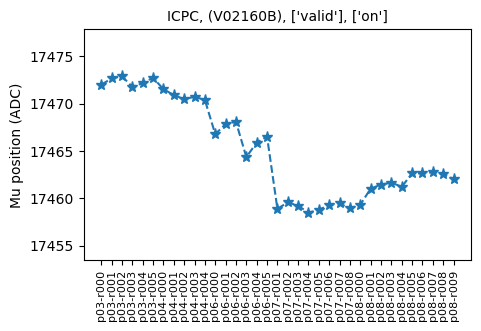

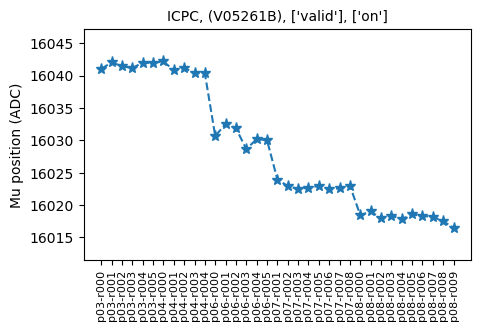

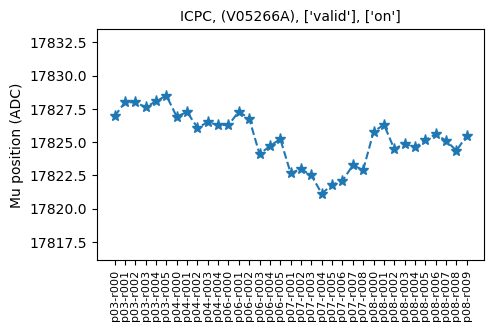

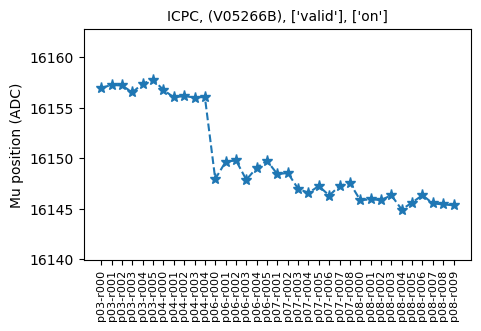

...

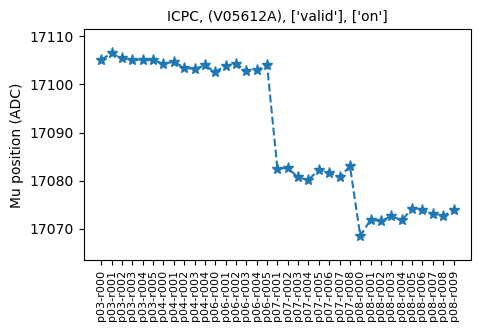

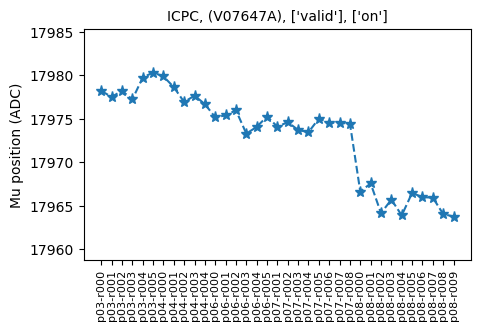

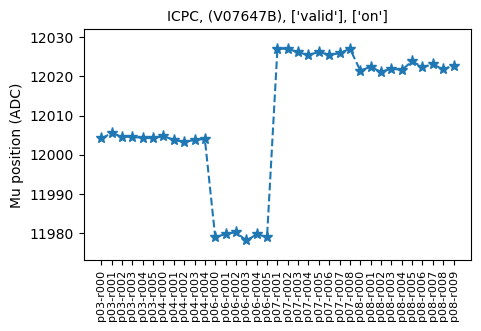

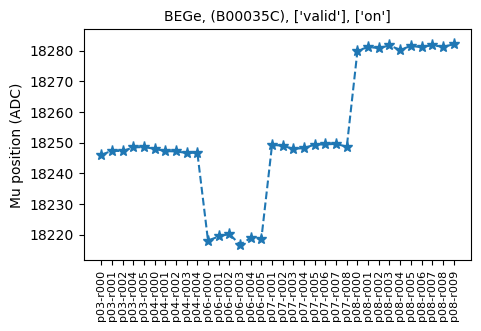

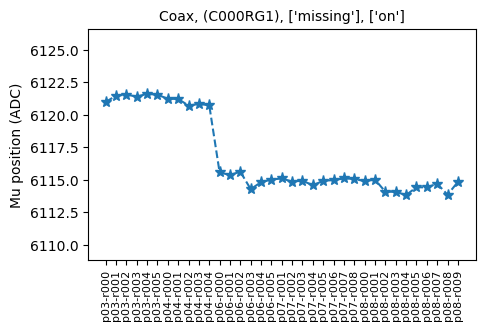

In [ ]:
peak     = all_fitted_peaks[6]
for channel in good_chs[:100]:
    
    try:
        keys    = list(all_params_ch[channel]['mus_peaks']    [peak].keys())
        mus     = list(all_params_ch[channel]['mus_peaks']    [peak].values())
        mus_err = list(all_params_ch[channel]['mus_err_peaks'][peak].values())
        
        psd_stat = np.unique(list(psd_status[channel].values()))
        usab     = np.unique(list(usability [channel].values()))
        
        det_name = pf.get_ch_name(int(channel[2:]), ge_all, ge_rawid)
        det_type = pf.get_det_type(det_name)
        
        #if (np.std(mus)>15) & (np.std(mus)<25):
        #    print(det_name, np.std(mus))
        fig, ax = plt.subplots(1, 1, figsize=(5, 3))
        ax.errorbar(keys, mus, yerr=mus_err, marker='*', linestyle='--', markersize=8, label=det_type)

        ax.tick_params(axis='x', labelsize=8, rotation=90)
        ax.tick_params(axis='y', labelsize=10)
        ax.set_title(f'{det_type}, ({det_name}), {psd_stat}, {usab}', fontsize=10)
        ax.set_ylabel('Mu position (ADC)', fontsize=10)
        
        ax.set_ylim(np.min(mus)-5, np.max(mus)+5)
        #if (np.std(mus)>15) & (np.std(mus)<25):
        #    ax.set_ylim(np.mean(mus)-40, np.mean(mus)+35)
        #elif (np.std(mus)>25) & (np.std(mus)<35):
        #    ax.set_ylim(np.mean(mus)-60, np.mean(mus)+45)
    except KeyError:
        continue
    
plt.tight_layout()    
plt.show()